In [1]:
# Import Libraries needed
import numpy as np
import glob
from PIL import Image
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras import Model,optimizers
from tensorflow.keras.layers import Input, Dense, BatchNormalization, Reshape, Conv2DTranspose, Conv2D, LeakyReLU, Flatten, Dropout
from IPython import display
import os
import random
from tensorflow.python.client import device_lib

In [2]:
# Test the status of GPU
tf.test.is_gpu_available()
# Check the devices of GPU
device_lib.list_local_devices()

Instructions for updating:
Use `tf.config.list_physical_devices('GPU')` instead.


[name: "/device:CPU:0"
 device_type: "CPU"
 memory_limit: 268435456
 locality {
 }
 incarnation: 13779855900788537476, name: "/device:XLA_CPU:0"
 device_type: "XLA_CPU"
 memory_limit: 17179869184
 locality {
 }
 incarnation: 10045838933621307665
 physical_device_desc: "device: XLA_CPU device", name: "/device:XLA_GPU:0"
 device_type: "XLA_GPU"
 memory_limit: 17179869184
 locality {
 }
 incarnation: 13465494222201334133
 physical_device_desc: "device: XLA_GPU device", name: "/device:GPU:0"
 device_type: "GPU"
 memory_limit: 15695549568
 locality {
   bus_id: 1
   links {
   }
 }
 incarnation: 14824085285820107662
 physical_device_desc: "device: 0, name: Tesla P100-PCIE-16GB, pci bus id: 0000:00:04.0, compute capability: 6.0"]

In [3]:
# Build a connection with my Google drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
# Copy the zipfile of preprocessed images and unzip it
!cp "/content/drive/MyDrive/Colab Notebooks/Processed_Imgs3.zip" .
!unzip -q Processed_Imgs3.zip
!rm Processed_Imgs3.zip

In [5]:
# Enter the name of animals in the dataset
all_files=["cane","cavallo","elefante","farfalla","gallina","pecora","mucca","ragno","gatto","scoiattolo"]

# Define a function to read the images from the dataset
def read_images():
    images = []
    # Store the images in the form of array into the images list
    for files in all_files:
        for image_name in glob.glob("/content/Processed_Imgs2/"+files+"/*.png"):
            image = Image.open(image_name)
            image = np.asarray(image)
            images.append(image)
    
    # Randomly shuffle the sequence of images
    random.shuffle(images)
    
    # Formalize the array values to values from 0 to 1
    return np.asarray(images) / 255.

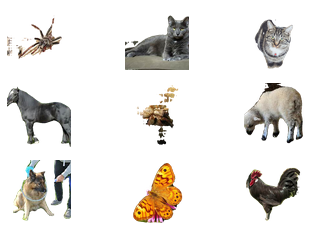

In [6]:
# Read the images from the dataset
train_set = read_images()

# Show 9 images
for i in range(9):
    plt.subplot(3,3, i + 1)
    plt.imshow(train_set[i])
    plt.axis('off')
plt.show()

In [7]:
# Define the loss function for the generator, the input is the probability of generated images are considered genuine
def loss_generator(prob):
    # Mean of log of prob of tensors
    return tf.math.negative(tf.math.reduce_mean(tf.math.log(prob)))

# Define the loss function for the discriminator
def loss_discriminator(p_real, p_fake):
    # The sub-loss to recognize real images as real
    loss_real = tf.math.negative(tf.math.reduce_mean(tf.math.log(p_real)))
    # The sub-loss to recognize fake images as fake
    loss_fake = tf.math.negative(tf.math.reduce_mean(tf.math.log(1 - p_fake)))
    # Total loss_function equals to the sum of two sub_loss
    return loss_real + loss_fake

# Define the CNN for Generator
def Generator(output_channels, noise_size):
    # Define the input with the noise
    X = Input(shape=noise_size)

    # Project the input noise to the size of 4x4
    Y = Dense(units=4*4*256)(X)
    # Add Leaky Relu for the activision of the network
    Y = LeakyReLU()(Y)
    # Add a batch normalization layer
    Y = BatchNormalization()(Y)
    # Reshape the input to 4*4*256
    Y = Reshape(target_shape=(4, 4, 256))(Y)

    # Amplify the input to 8x8
    # Use a deconvolution layer to transpose the convolution operation
    Y = Conv2DTranspose(filters=128, kernel_size=5, strides=2, padding='same', activation='relu')(Y)
    # Add a # Add a batch normalization layer
    Y = BatchNormalization()(Y)

    # Amplify the input to 16x16
    Y = Conv2DTranspose(filters=64, kernel_size=5, strides=2, padding='same', activation='relu')(Y)
    Y = BatchNormalization()(Y)

    # Amplify the input to 32x32
    Y = Conv2DTranspose(filters=32, kernel_size=5, strides=2, padding='same', activation='relu')(Y)
    Y = BatchNormalization()(Y)

    # Amplify the input to 64x64, use sigmoid as the activision function for the last layer
    Y = Conv2DTranspose(filters=output_channels, kernel_size=5, strides=2, padding='same', activation='sigmoid')(Y)

    # Construct the model
    model = Model(inputs=X, outputs=Y)

    return model

# Define a function to create the generator
def create_generator(channels, noise_size, learning_rate, beta_1):
    # Define the generator
    generator = Generator(output_channels=channels, noise_size=noise_size)
    # Use Adam as the optimizer of the training proccess, with a certain learning rate and hyperpara beta
    generator_optimizer = optimizers.Adam(lr=learning_rate, beta_1=beta_1)
    # Define the checkpoint to store model
    generator_checkpoint = tf.train.Checkpoint(optimizer=generator_optimizer, model=generator)

    return generator, generator_optimizer, generator_checkpoint

# Define the CNN for discriminator
def Discriminator(input_channels):
    # Define input arrays
    X = Input(shape=(64, 64, input_channels))

    # Project the input to 32x32
    # Add a convolutional layer
    Y = Conv2D(filters=32, kernel_size=5, strides=2, padding='same')(X)
    # Add Leaky Relu for the activision of the network
    Y = LeakyReLU()(Y)
    # Add a batch normalization layer
    Y = BatchNormalization()(Y)
    # Dropout 0.4 of tensors 
    Y = Dropout(0.4)(Y)

    # Project the input to 16x16
    Y = Conv2D(filters=64, kernel_size=5, strides=2, padding='same')(Y)
    Y = LeakyReLU()(Y)
    Y = BatchNormalization()(Y)
    Y = Dropout(0.4)(Y)

    # Project the input to 8x8
    Y = Conv2D(filters=128, kernel_size=5, strides=2, padding='same')(Y)
    Y = LeakyReLU()(Y)
    Y = BatchNormalization()(Y)
    Y = Dropout(0.4)(Y)

    # Project the input to 4x4
    Y = Conv2D(filters=256, kernel_size=5, strides=2, padding='same')(Y)
    Y = LeakyReLU()(Y)
    Y = BatchNormalization()(Y)
    Y = Dropout(0.4)(Y)

    # Flatten the last layer to boolen and make the classification
    Y = Flatten()(Y)
    Y = Dense(units=1, activation='sigmoid')(Y)

    # Set the final model
    model = Model(inputs=X, outputs=Y)

    return model

# Define a function to create the generator
def create_discriminator(channels, learning_rate, beta_1):
    # Define the discriminator
    discriminator = Discriminator(input_channels=channels)
    # Use Adam as the optimizer of the training proccess, with a certain learning rate and hyperpara beta
    discriminator_optimizer = optimizers.Adam(lr=learning_rate, beta_1=beta_1)
    # Define the checkpoint to store model
    discriminator_checkpoint = tf.train.Checkpoint(optimizer=discriminator_optimizer, model=discriminator)

    return discriminator, discriminator_optimizer, discriminator_checkpoint

In [8]:
# Define the function to train the model of DCGAN
def train_DCGAN(train_set, batch_size, epochs):
    # Set these variables globally
    global generator, generator_optimizer, generator_checkpoint, discriminator, discriminator_optimizer, discriminator_checkpoint, noise_size
    
    # Get the size of the train set
    train_size = train_set.shape[0]
    # Calculate the number of small batches
    num_batch = train_size // batch_size
    # Split the training set to small batches
    train_batches = np.split(train_set, [batch_size*i for i in range(1, num_batch)])

    # Get the prefixes for the checkpoints of the generator and discriminator
    generator_prefix = os.path.join('./generator', 'ckpt')
    discriminator_prefix = os.path.join('./discriminator', 'ckpt')

    # Generate lists to record costs of the generator and discriminator
    generator_costs = []
    discriminator_costs = []

    # Iterate the epochs
    for epoch in range(epochs):

        # Set the costs of the generator and discriminator to 0 fot each epoch 
        generator_cost = 0
        discriminator_cost = 0

        # Iterate small batchs
        for batch in train_batches:
            # Generate a random noise for the current batch
            noise = tf.random.normal([batch_size, noise_size])

            # Get the trainable variables for the loss functions of the generator and discriminator
            with tf.GradientTape() as generator_tape, tf.GradientTape() as discriminator_tape:
                
                # Generate fake images from noises with the generator
                fake_images = generator(noise, training=True)

                # Use the discriminator to calculate the probabilites of images for being fake and genuine
                p_fake = discriminator(fake_images, training=True)
                p_real = discriminator(batch, training=True)

                # Use functions to calculate the loss functions for the generator and discriminator
                generator_loss = loss_generator(p_fake)
                discriminator_loss = loss_discriminator(p_real, p_fake)

            # Calculate the gradients for generator 
            generator_Grads = generator_tape.gradient(generator_loss, generator.trainable_variables)
            # Imaplement gradient descend for generator 
            generator_optimizer.apply_gradients(zip(generator_Grads, generator.trainable_variables))
            
            # Calculate the gradients for discriminator
            discriminator_Grads = discriminator_tape.gradient(discriminator_loss, discriminator.trainable_variables)
            # Imaplement gradient descend for discriminator
            discriminator_optimizer.apply_gradients(zip(discriminator_Grads, discriminator.trainable_variables))

            # Record the costs of generator and discriminator at the end of every 10 epochs
            if (epoch + 1) % 10 == 0:
                # Not training with the input
                fake_images = generator(noise, training=False)
                p_fake = discriminator(fake_images, training=False)
                p_real = discriminator(batch, training=False)
                # Take the mean of genertor cost of each batch
                generator_cost += loss_generator(p_fake).numpy() / num_batch
                # Take the mean of discriminator cost of each batch
                discriminator_cost += loss_discriminator(p_real, p_fake).numpy() / num_batch
        # Print the end of a certain epoch
        print('Epoch: {}'.format(epoch+1),'Generator loss: {}'.format(generator_loss),'Discriminator loss: {}'.format(discriminator_loss))
       
        # Save the checkpoint every 10 epochs
        if (epoch + 1) % 10 == 0:
            # Save the checkpoint for the generator
            generator_checkpoint.save(file_prefix=generator_prefix)
            # Save the checkpoint for the discriminator
            discriminator_checkpoint.save(file_prefix=discriminator_prefix)
            
            # Append the generator costs
            generator_costs.append(generator_cost)
            # Append the discriminator costs
            discriminator_costs.append(discriminator_cost)
            
            # display.clear_output(wait=True)

            # Randomly generate 9 images with the current model
            noise = tf.random.normal([9, noise_size])
            predicted_image = generator(noise, training=False)
            fig = plt.figure(figsize=(10, 10))

            # Plot the 9 images
            for i in range(9):
                plt.subplot(3, 3, i + 1)
                plt.imshow(predicted_image[i])
                plt.axis('off')

            # Save the 9 Images
            plt.savefig('epoch{:04d}.png'.format(epoch+1))
            plt.show()

    # plot the changing curves of the generator and discriminator
    plt.plot(np.squeeze(generator_costs))
    plt.plot(np.squeeze(discriminator_costs))
    plt.show()


Epoch: 1 Generator loss: 5.823131561279297 Discriminator loss: 0.06662650406360626
Epoch: 2 Generator loss: 8.172608375549316 Discriminator loss: 0.01264059729874134
Epoch: 3 Generator loss: 8.883310317993164 Discriminator loss: 0.014598887413740158
Epoch: 4 Generator loss: 8.01128101348877 Discriminator loss: 0.01802314817905426
Epoch: 5 Generator loss: 5.6138176918029785 Discriminator loss: 0.12519173324108124
Epoch: 6 Generator loss: 5.049488067626953 Discriminator loss: 0.1217072606086731
Epoch: 7 Generator loss: 3.2651846408843994 Discriminator loss: 0.4568455219268799
Epoch: 8 Generator loss: 2.9599382877349854 Discriminator loss: 0.4532153010368347
Epoch: 9 Generator loss: 2.9240188598632812 Discriminator loss: 0.47264420986175537
Epoch: 10 Generator loss: 2.4078257083892822 Discriminator loss: 0.475502610206604


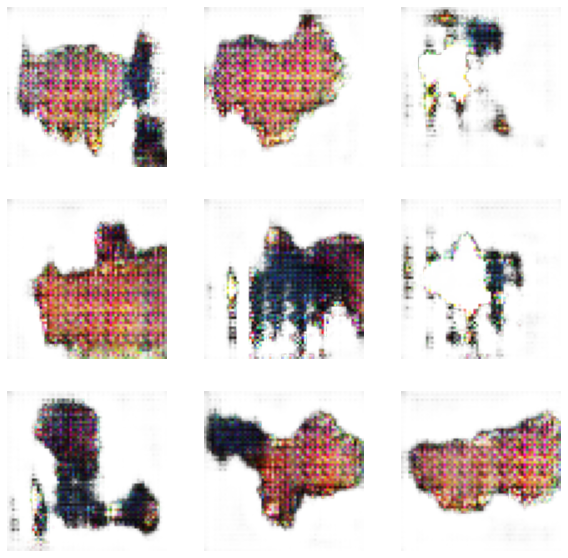

Epoch: 11 Generator loss: 2.0175094604492188 Discriminator loss: 0.471851646900177
Epoch: 12 Generator loss: 4.776769161224365 Discriminator loss: 0.4690473973751068
Epoch: 13 Generator loss: 2.0307669639587402 Discriminator loss: 0.4913668632507324
Epoch: 14 Generator loss: 0.657504677772522 Discriminator loss: 1.605735182762146
Epoch: 15 Generator loss: 2.857208251953125 Discriminator loss: 0.37168097496032715
Epoch: 16 Generator loss: 2.8831655979156494 Discriminator loss: 0.5319951176643372
Epoch: 17 Generator loss: 2.0764682292938232 Discriminator loss: 0.4883766174316406
Epoch: 18 Generator loss: 2.9861044883728027 Discriminator loss: 0.7442962527275085
Epoch: 19 Generator loss: 3.0095245838165283 Discriminator loss: 0.6245928406715393
Epoch: 20 Generator loss: 3.586935043334961 Discriminator loss: 0.7801587581634521


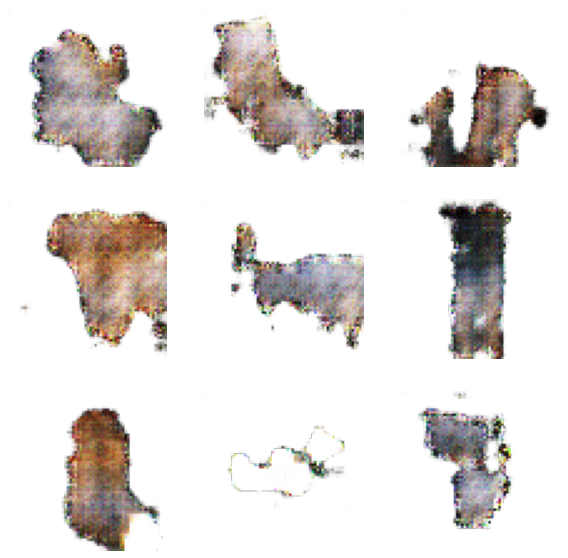

Epoch: 21 Generator loss: 1.6884093284606934 Discriminator loss: 0.6470339894294739
Epoch: 22 Generator loss: 3.4632155895233154 Discriminator loss: 0.8675397038459778
Epoch: 23 Generator loss: 0.6073303818702698 Discriminator loss: 1.3182222843170166
Epoch: 24 Generator loss: 1.2824974060058594 Discriminator loss: 0.7808436751365662
Epoch: 25 Generator loss: 2.5489532947540283 Discriminator loss: 0.3916766345500946
Epoch: 26 Generator loss: 2.6145541667938232 Discriminator loss: 0.3795197010040283
Epoch: 27 Generator loss: 1.9027780294418335 Discriminator loss: 0.6898652911186218
Epoch: 28 Generator loss: 3.9422051906585693 Discriminator loss: 1.0733376741409302
Epoch: 29 Generator loss: 2.2387309074401855 Discriminator loss: 0.4423750936985016
Epoch: 30 Generator loss: 1.765446424484253 Discriminator loss: 0.5790499448776245


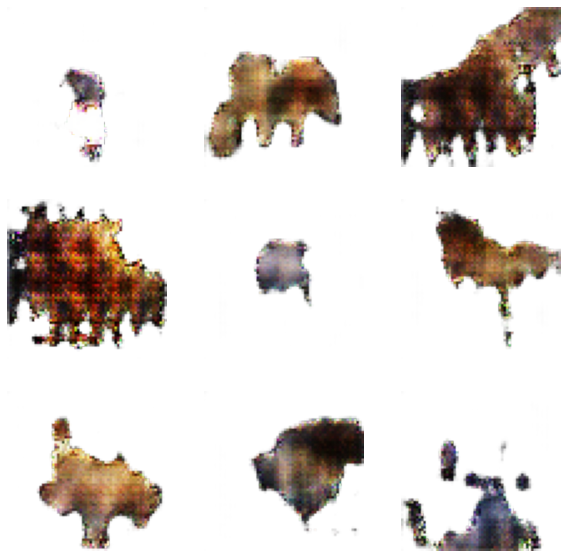

Epoch: 31 Generator loss: 2.0819849967956543 Discriminator loss: 0.8727884888648987
Epoch: 32 Generator loss: 1.3280278444290161 Discriminator loss: 0.8397409319877625
Epoch: 33 Generator loss: 2.1865015029907227 Discriminator loss: 0.5626620054244995
Epoch: 34 Generator loss: 2.540687084197998 Discriminator loss: 0.6465486288070679
Epoch: 35 Generator loss: 1.0400389432907104 Discriminator loss: 0.8733298778533936
Epoch: 36 Generator loss: 4.333389759063721 Discriminator loss: 1.0294573307037354
Epoch: 37 Generator loss: 1.2668232917785645 Discriminator loss: 0.6936099529266357
Epoch: 38 Generator loss: 1.3931094408035278 Discriminator loss: 0.6636554002761841
Epoch: 39 Generator loss: 0.9969270825386047 Discriminator loss: 0.8997318744659424
Epoch: 40 Generator loss: 1.7865099906921387 Discriminator loss: 0.6992025375366211


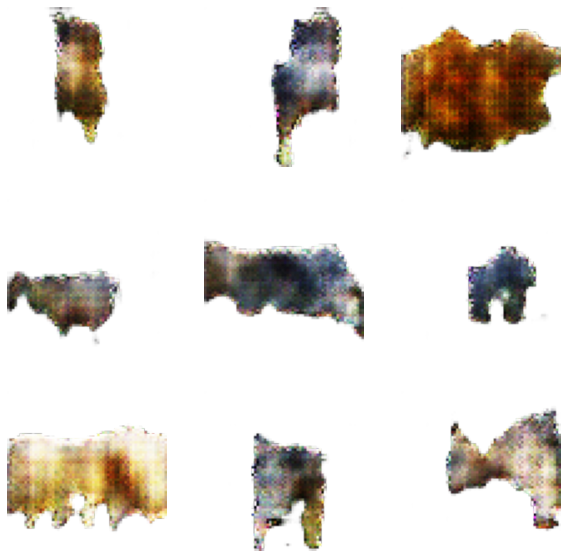

Epoch: 41 Generator loss: 2.3232758045196533 Discriminator loss: 0.4730401039123535
Epoch: 42 Generator loss: 0.7475308179855347 Discriminator loss: 1.1276395320892334
Epoch: 43 Generator loss: 2.512810468673706 Discriminator loss: 0.9051652550697327
Epoch: 44 Generator loss: 1.7929749488830566 Discriminator loss: 0.42503786087036133
Epoch: 45 Generator loss: 2.3372812271118164 Discriminator loss: 0.955217719078064
Epoch: 46 Generator loss: 2.0119028091430664 Discriminator loss: 1.0399378538131714
Epoch: 47 Generator loss: 1.6383094787597656 Discriminator loss: 0.6689496040344238
Epoch: 48 Generator loss: 2.533992052078247 Discriminator loss: 0.5123580694198608
Epoch: 49 Generator loss: 3.006805658340454 Discriminator loss: 1.4669630527496338
Epoch: 50 Generator loss: 1.6314140558242798 Discriminator loss: 0.4785045385360718


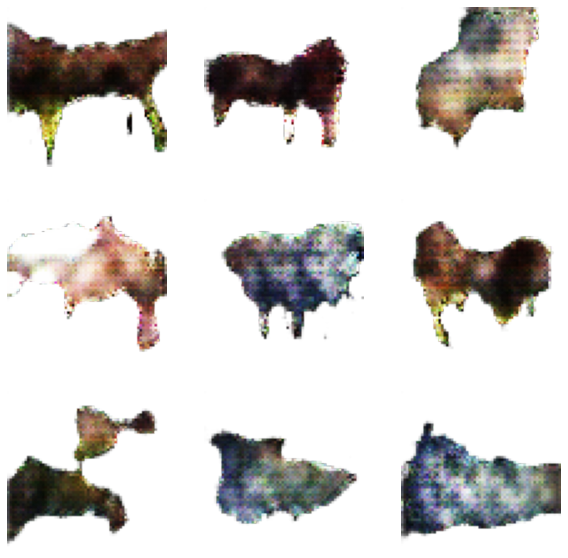

Epoch: 51 Generator loss: 2.616459608078003 Discriminator loss: 0.504536509513855
Epoch: 52 Generator loss: 1.7693172693252563 Discriminator loss: 0.6004828214645386
Epoch: 53 Generator loss: 1.7080626487731934 Discriminator loss: 0.719050943851471
Epoch: 54 Generator loss: 3.5228090286254883 Discriminator loss: 0.6146885752677917
Epoch: 55 Generator loss: 2.01865553855896 Discriminator loss: 1.173075795173645
Epoch: 56 Generator loss: 1.4691252708435059 Discriminator loss: 0.6501168012619019
Epoch: 57 Generator loss: 3.5780162811279297 Discriminator loss: 0.6233475208282471
Epoch: 58 Generator loss: 3.390620708465576 Discriminator loss: 0.4858299195766449
Epoch: 59 Generator loss: 1.9408671855926514 Discriminator loss: 0.4104142189025879
Epoch: 60 Generator loss: 2.6553127765655518 Discriminator loss: 0.43372926115989685


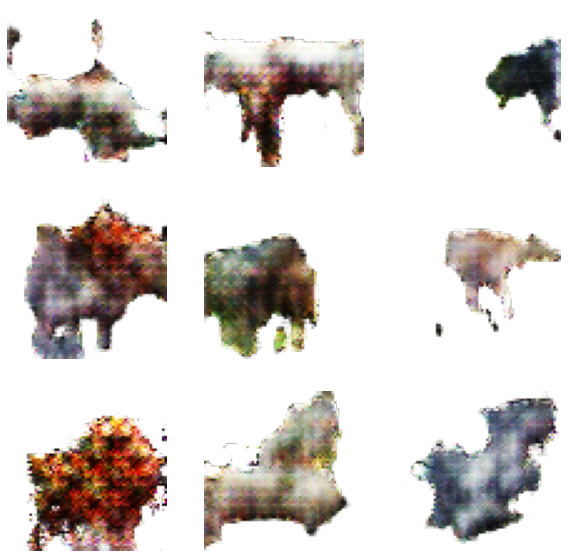

Epoch: 61 Generator loss: 2.774385452270508 Discriminator loss: 0.576615035533905
Epoch: 62 Generator loss: 1.707992672920227 Discriminator loss: 0.8466588258743286
Epoch: 63 Generator loss: 0.9534928798675537 Discriminator loss: 0.9187701940536499
Epoch: 64 Generator loss: 2.362053871154785 Discriminator loss: 0.6820909976959229
Epoch: 65 Generator loss: 1.636275291442871 Discriminator loss: 0.7538606524467468
Epoch: 66 Generator loss: 0.8349156379699707 Discriminator loss: 1.043135404586792
Epoch: 67 Generator loss: 2.398597240447998 Discriminator loss: 0.49207600951194763
Epoch: 68 Generator loss: 1.5350950956344604 Discriminator loss: 0.5015445351600647
Epoch: 69 Generator loss: 1.4561262130737305 Discriminator loss: 0.7399264574050903
Epoch: 70 Generator loss: 2.2833986282348633 Discriminator loss: 0.2958363890647888


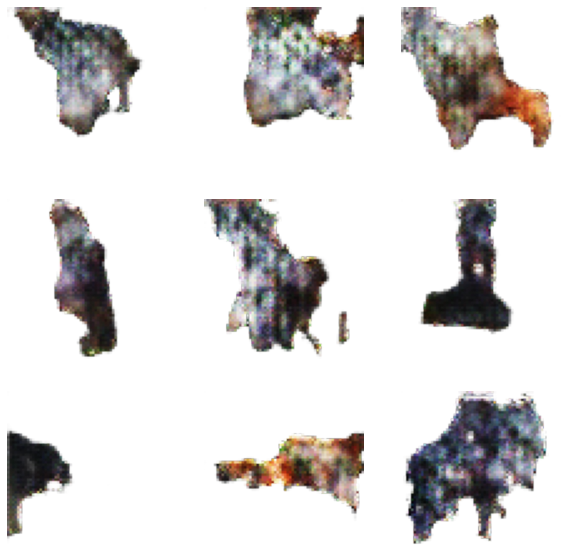

Epoch: 71 Generator loss: 2.5051677227020264 Discriminator loss: 0.6265982389450073
Epoch: 72 Generator loss: 3.4487152099609375 Discriminator loss: 1.022810459136963
Epoch: 73 Generator loss: 2.1808862686157227 Discriminator loss: 0.5848183631896973
Epoch: 74 Generator loss: 0.7437511682510376 Discriminator loss: 1.2805134057998657
Epoch: 75 Generator loss: 2.948038339614868 Discriminator loss: 0.7493935227394104
Epoch: 76 Generator loss: 3.1145238876342773 Discriminator loss: 0.42252764105796814
Epoch: 77 Generator loss: 0.8400928378105164 Discriminator loss: 0.9769318103790283
Epoch: 78 Generator loss: 3.5346813201904297 Discriminator loss: 0.7016386389732361
Epoch: 79 Generator loss: 0.47797784209251404 Discriminator loss: 1.536453127861023
Epoch: 80 Generator loss: 3.653674840927124 Discriminator loss: 1.0179221630096436


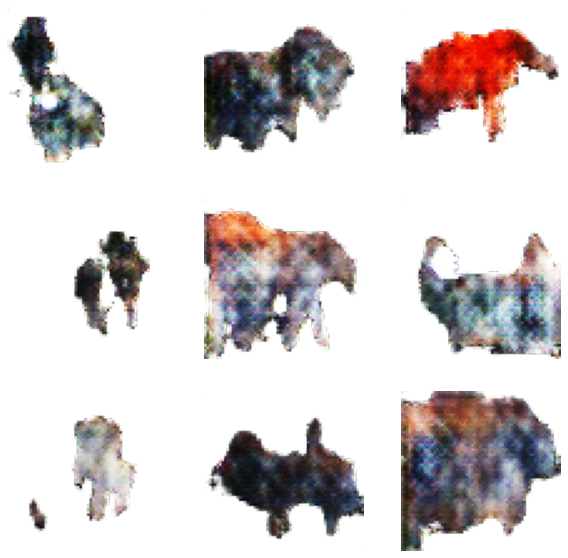

Epoch: 81 Generator loss: 1.6390204429626465 Discriminator loss: 0.5822893977165222
Epoch: 82 Generator loss: 2.489784002304077 Discriminator loss: 0.3102976083755493
Epoch: 83 Generator loss: 1.930379033088684 Discriminator loss: 0.760770320892334
Epoch: 84 Generator loss: 1.7512468099594116 Discriminator loss: 0.6267611384391785
Epoch: 85 Generator loss: 4.302677154541016 Discriminator loss: 0.7509906888008118
Epoch: 86 Generator loss: 1.1462186574935913 Discriminator loss: 0.7847822904586792
Epoch: 87 Generator loss: 2.942040205001831 Discriminator loss: 0.47539451718330383
Epoch: 88 Generator loss: 2.2226836681365967 Discriminator loss: 0.22614437341690063
Epoch: 89 Generator loss: 3.5185883045196533 Discriminator loss: 0.6525202989578247
Epoch: 90 Generator loss: 2.3892154693603516 Discriminator loss: 0.4879131317138672


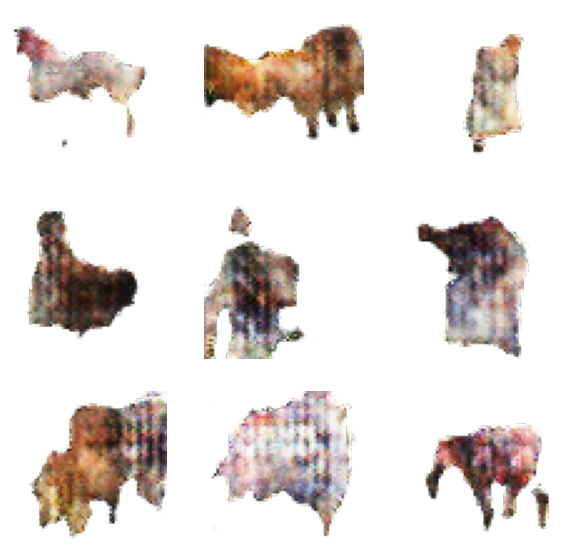

Epoch: 91 Generator loss: 5.417956352233887 Discriminator loss: 1.1028368473052979
Epoch: 92 Generator loss: 3.797741651535034 Discriminator loss: 0.6909484267234802
Epoch: 93 Generator loss: 2.5038039684295654 Discriminator loss: 0.24039310216903687
Epoch: 94 Generator loss: 5.506757736206055 Discriminator loss: 1.1151933670043945
Epoch: 95 Generator loss: 2.4817636013031006 Discriminator loss: 0.5738077759742737
Epoch: 96 Generator loss: 0.9237505197525024 Discriminator loss: 0.903037428855896
Epoch: 97 Generator loss: 5.220841884613037 Discriminator loss: 1.5605206489562988
Epoch: 98 Generator loss: 3.7217178344726562 Discriminator loss: 0.16152074933052063
Epoch: 99 Generator loss: 2.0551319122314453 Discriminator loss: 0.5960096716880798
Epoch: 100 Generator loss: 2.2237117290496826 Discriminator loss: 0.3730018734931946


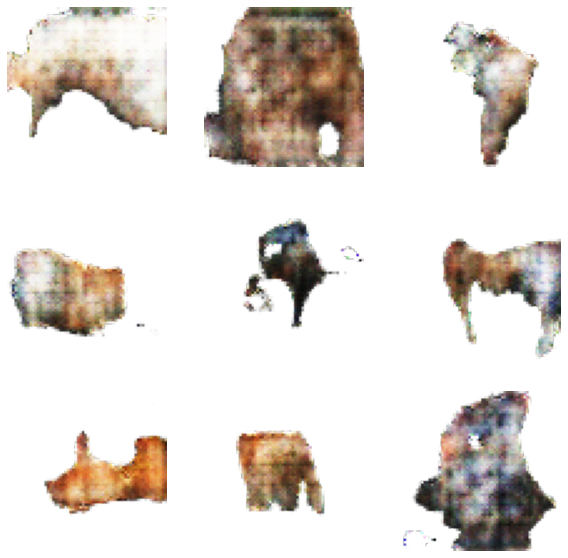

Epoch: 101 Generator loss: 2.242063045501709 Discriminator loss: 0.41385143995285034
Epoch: 102 Generator loss: 2.8231801986694336 Discriminator loss: 0.26693663001060486
Epoch: 103 Generator loss: 1.8679225444793701 Discriminator loss: 0.5400885939598083
Epoch: 104 Generator loss: 1.2870680093765259 Discriminator loss: 0.5992968082427979
Epoch: 105 Generator loss: 2.2701542377471924 Discriminator loss: 0.363366961479187
Epoch: 106 Generator loss: 3.3830368518829346 Discriminator loss: 0.5705708265304565
Epoch: 107 Generator loss: 2.9355218410491943 Discriminator loss: 0.25902339816093445
Epoch: 108 Generator loss: 2.5271058082580566 Discriminator loss: 0.3802434504032135
Epoch: 109 Generator loss: 1.9492733478546143 Discriminator loss: 0.3998423218727112
Epoch: 110 Generator loss: 0.9793586134910583 Discriminator loss: 0.8238344192504883


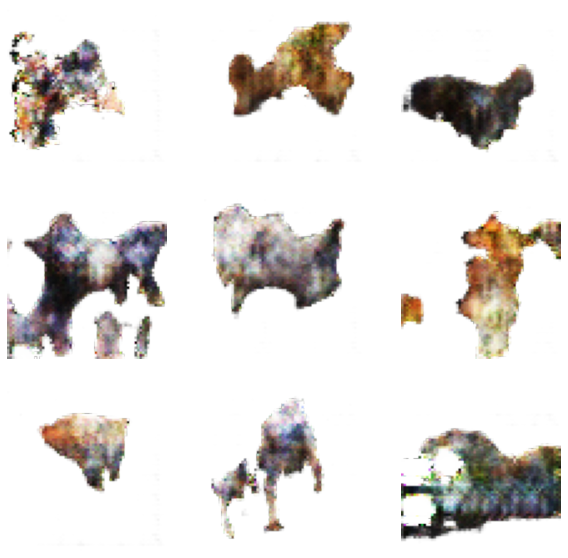

Epoch: 111 Generator loss: 1.4788577556610107 Discriminator loss: 0.5070499777793884
Epoch: 112 Generator loss: 2.842491388320923 Discriminator loss: 0.2323368638753891
Epoch: 113 Generator loss: 4.965152740478516 Discriminator loss: 0.9308289885520935
Epoch: 114 Generator loss: 3.872314214706421 Discriminator loss: 0.2624432146549225
Epoch: 115 Generator loss: 1.6695971488952637 Discriminator loss: 0.41120001673698425
Epoch: 116 Generator loss: 1.0836474895477295 Discriminator loss: 0.7632196545600891
Epoch: 117 Generator loss: 4.0210280418396 Discriminator loss: 0.22644056379795074
Epoch: 118 Generator loss: 2.087022304534912 Discriminator loss: 0.4461350440979004
Epoch: 119 Generator loss: 4.998124599456787 Discriminator loss: 0.390715628862381
Epoch: 120 Generator loss: 4.393028259277344 Discriminator loss: 0.09917182475328445


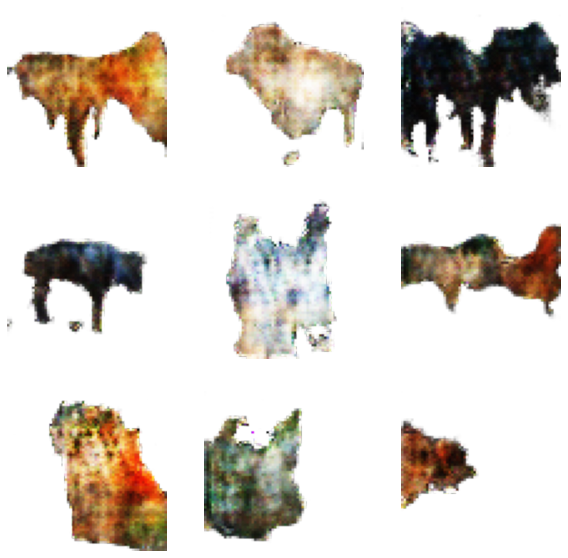

Epoch: 121 Generator loss: 0.8315321207046509 Discriminator loss: 0.9373621344566345
Epoch: 122 Generator loss: 6.205013275146484 Discriminator loss: 1.6488587856292725
Epoch: 123 Generator loss: 3.654031753540039 Discriminator loss: 0.19455716013908386
Epoch: 124 Generator loss: 2.264354944229126 Discriminator loss: 0.3476865291595459
Epoch: 125 Generator loss: 2.794416904449463 Discriminator loss: 0.2380284070968628
Epoch: 126 Generator loss: 4.102944850921631 Discriminator loss: 0.04390256106853485
Epoch: 127 Generator loss: 3.6898443698883057 Discriminator loss: 0.10668177902698517
Epoch: 128 Generator loss: 2.8196146488189697 Discriminator loss: 0.23984716832637787
Epoch: 129 Generator loss: 3.7977612018585205 Discriminator loss: 0.4138830900192261
Epoch: 130 Generator loss: 2.9393303394317627 Discriminator loss: 0.4796561598777771


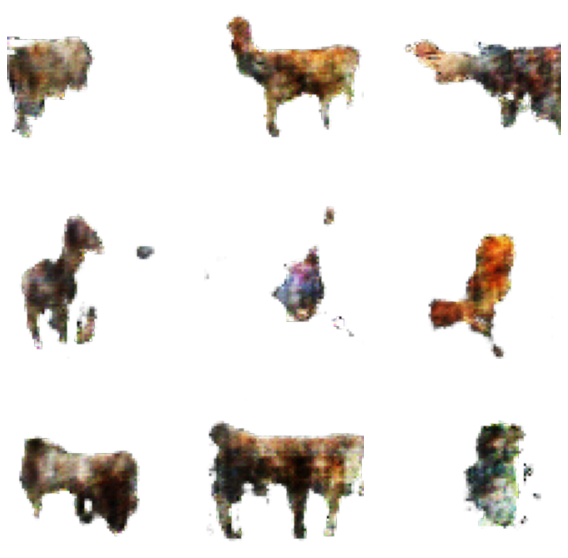

Epoch: 131 Generator loss: 6.169651985168457 Discriminator loss: 0.9423416256904602
Epoch: 132 Generator loss: 5.424447536468506 Discriminator loss: 0.3089996576309204
Epoch: 133 Generator loss: 5.6101884841918945 Discriminator loss: 0.5597739219665527
Epoch: 134 Generator loss: 4.401909351348877 Discriminator loss: 0.15880264341831207
Epoch: 135 Generator loss: 2.696753740310669 Discriminator loss: 0.5266236662864685
Epoch: 136 Generator loss: 8.087996482849121 Discriminator loss: 0.6640843152999878
Epoch: 137 Generator loss: 3.2638397216796875 Discriminator loss: 0.13626854121685028
Epoch: 138 Generator loss: 3.869246244430542 Discriminator loss: 0.13700532913208008
Epoch: 139 Generator loss: 0.8514898419380188 Discriminator loss: 0.9059953689575195
Epoch: 140 Generator loss: 3.287245273590088 Discriminator loss: 0.15930572152137756


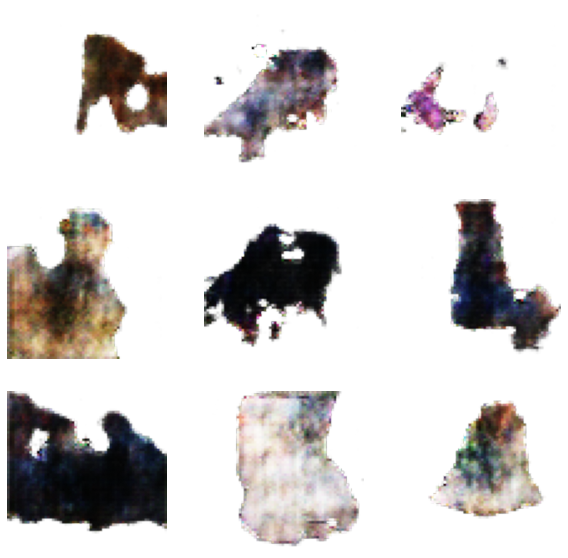

Epoch: 141 Generator loss: 3.705359697341919 Discriminator loss: 0.15288540720939636
Epoch: 142 Generator loss: 4.3179144859313965 Discriminator loss: 0.39884302020072937
Epoch: 143 Generator loss: 2.059527635574341 Discriminator loss: 0.48491421341896057
Epoch: 144 Generator loss: 5.147418975830078 Discriminator loss: 0.07696150243282318
Epoch: 145 Generator loss: 2.4442663192749023 Discriminator loss: 0.25536465644836426
Epoch: 146 Generator loss: 5.238216400146484 Discriminator loss: 0.432241827249527
Epoch: 147 Generator loss: 3.8346753120422363 Discriminator loss: 0.09670761227607727
Epoch: 148 Generator loss: 4.214360237121582 Discriminator loss: 0.2315589040517807
Epoch: 149 Generator loss: 1.0381942987442017 Discriminator loss: 0.7947037220001221
Epoch: 150 Generator loss: 2.0586018562316895 Discriminator loss: 0.28827011585235596


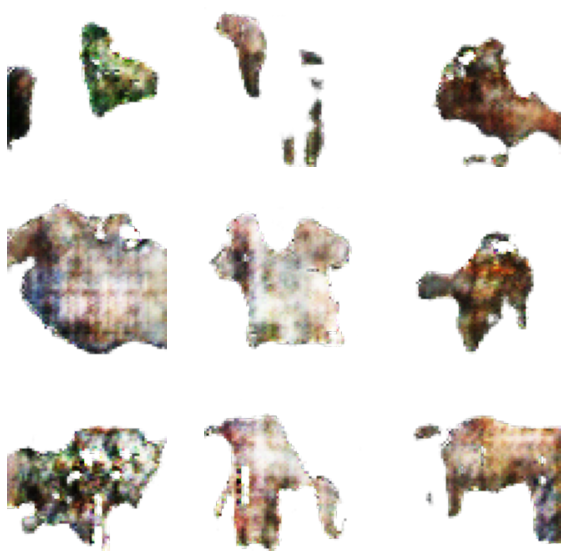

Epoch: 151 Generator loss: 3.6916115283966064 Discriminator loss: 0.3073670566082001
Epoch: 152 Generator loss: 5.537808895111084 Discriminator loss: 0.13689550757408142
Epoch: 153 Generator loss: 1.9686830043792725 Discriminator loss: 0.3835151195526123
Epoch: 154 Generator loss: 5.886019229888916 Discriminator loss: 0.10198915004730225
Epoch: 155 Generator loss: 3.51789927482605 Discriminator loss: 0.24852697551250458
Epoch: 156 Generator loss: 2.7189345359802246 Discriminator loss: 0.20391933619976044
Epoch: 157 Generator loss: 4.4226789474487305 Discriminator loss: 0.21232298016548157
Epoch: 158 Generator loss: 1.6375889778137207 Discriminator loss: 0.4507107734680176
Epoch: 159 Generator loss: 4.119274616241455 Discriminator loss: 0.11293583363294601
Epoch: 160 Generator loss: 2.0584325790405273 Discriminator loss: 0.3399635851383209


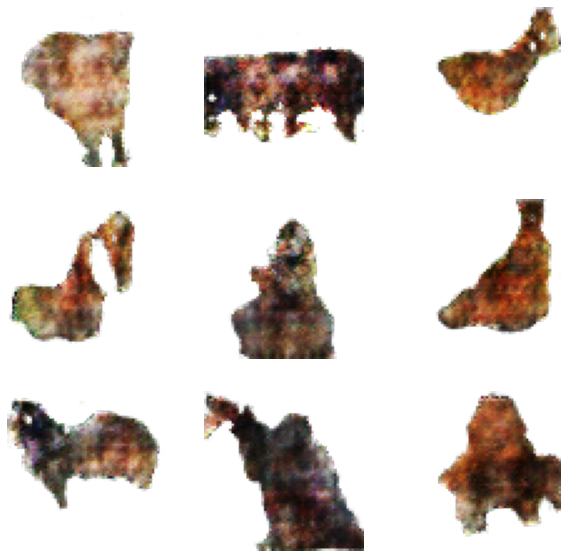

Epoch: 161 Generator loss: 5.687902927398682 Discriminator loss: 0.6137430667877197
Epoch: 162 Generator loss: 2.9275062084198 Discriminator loss: 0.150899276137352
Epoch: 163 Generator loss: 4.916977405548096 Discriminator loss: 0.4152415096759796
Epoch: 164 Generator loss: 3.8177385330200195 Discriminator loss: 0.09935827553272247
Epoch: 165 Generator loss: 1.0847158432006836 Discriminator loss: 0.7390155792236328
Epoch: 166 Generator loss: 3.8791632652282715 Discriminator loss: 0.11448618024587631
Epoch: 167 Generator loss: 1.8564990758895874 Discriminator loss: 0.35205042362213135
Epoch: 168 Generator loss: 3.344289779663086 Discriminator loss: 0.1311538964509964
Epoch: 169 Generator loss: 0.9349253177642822 Discriminator loss: 0.797286331653595
Epoch: 170 Generator loss: 5.694052219390869 Discriminator loss: 0.057811569422483444


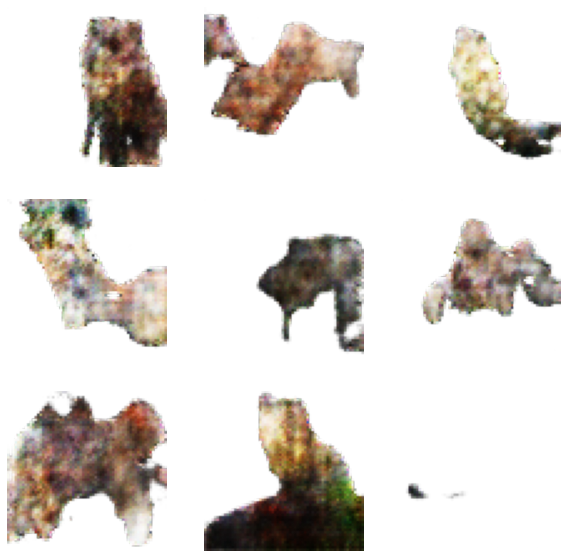

Epoch: 171 Generator loss: 1.575212001800537 Discriminator loss: 0.4559991955757141
Epoch: 172 Generator loss: 3.2785799503326416 Discriminator loss: 0.5086112022399902
Epoch: 173 Generator loss: 1.1931755542755127 Discriminator loss: 0.6194382309913635
Epoch: 174 Generator loss: 1.7394410371780396 Discriminator loss: 0.433047354221344
Epoch: 175 Generator loss: 1.1866704225540161 Discriminator loss: 0.7451178431510925
Epoch: 176 Generator loss: 3.5726797580718994 Discriminator loss: 0.1636504828929901
Epoch: 177 Generator loss: 4.0009684562683105 Discriminator loss: 0.054444946348667145
Epoch: 178 Generator loss: 3.1499340534210205 Discriminator loss: 0.17181620001792908
Epoch: 179 Generator loss: 1.6679584980010986 Discriminator loss: 0.41908636689186096
Epoch: 180 Generator loss: 2.4929440021514893 Discriminator loss: 0.34222275018692017


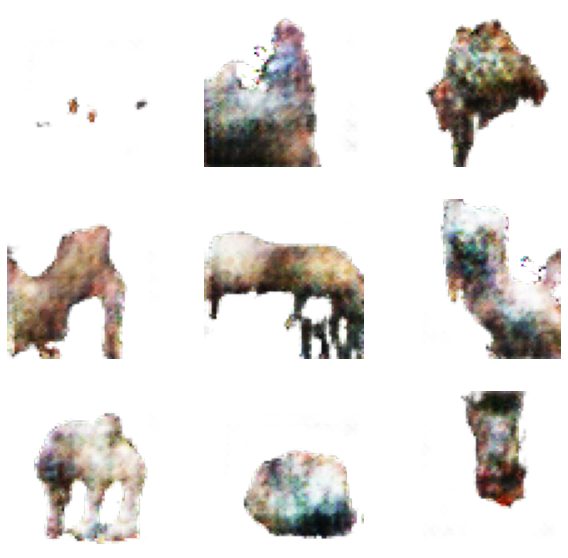

Epoch: 181 Generator loss: 5.030669689178467 Discriminator loss: 0.07584317028522491
Epoch: 182 Generator loss: 1.845199465751648 Discriminator loss: 0.3732602596282959
Epoch: 183 Generator loss: 5.324556827545166 Discriminator loss: 0.1803549975156784
Epoch: 184 Generator loss: 5.3194708824157715 Discriminator loss: 0.17418400943279266
Epoch: 185 Generator loss: 4.271939277648926 Discriminator loss: 0.06055697053670883
Epoch: 186 Generator loss: 4.293665409088135 Discriminator loss: 0.11610311269760132
Epoch: 187 Generator loss: 1.8646167516708374 Discriminator loss: 0.4343683123588562
Epoch: 188 Generator loss: 3.4828145503997803 Discriminator loss: 0.11189288645982742
Epoch: 189 Generator loss: 3.807894229888916 Discriminator loss: 0.2726694941520691
Epoch: 190 Generator loss: 3.3720977306365967 Discriminator loss: 0.10939545929431915


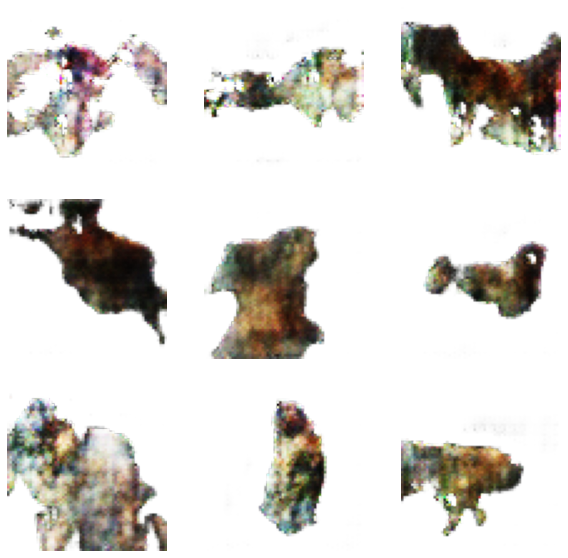

Epoch: 191 Generator loss: 2.185549259185791 Discriminator loss: 0.2749282717704773
Epoch: 192 Generator loss: 5.826266288757324 Discriminator loss: 0.06084079667925835
Epoch: 193 Generator loss: 5.714450836181641 Discriminator loss: 0.4378747344017029
Epoch: 194 Generator loss: 11.021195411682129 Discriminator loss: 1.397264003753662
Epoch: 195 Generator loss: 4.2868170738220215 Discriminator loss: 0.06728583574295044
Epoch: 196 Generator loss: 1.7903071641921997 Discriminator loss: 0.395285964012146
Epoch: 197 Generator loss: 5.057216644287109 Discriminator loss: 0.1987462192773819
Epoch: 198 Generator loss: 3.5955111980438232 Discriminator loss: 0.08694364130496979
Epoch: 199 Generator loss: 6.730575084686279 Discriminator loss: 0.01939118281006813
Epoch: 200 Generator loss: 4.483913898468018 Discriminator loss: 0.14008718729019165


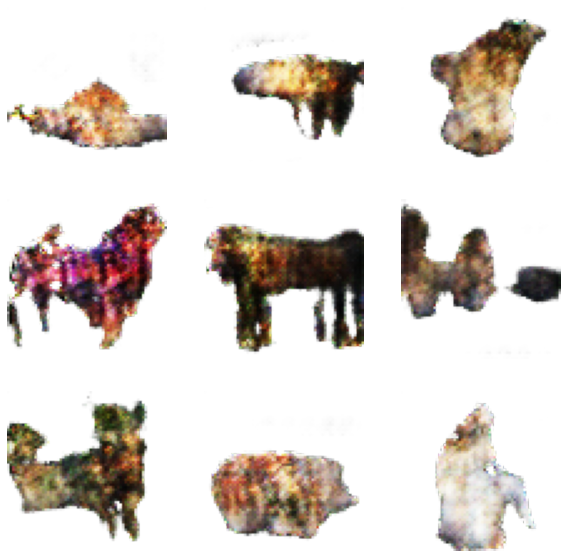

Epoch: 201 Generator loss: 6.691406726837158 Discriminator loss: 0.10838913917541504
Epoch: 202 Generator loss: 4.764051914215088 Discriminator loss: 0.08090062439441681
Epoch: 203 Generator loss: 5.896602153778076 Discriminator loss: 0.05101029574871063
Epoch: 204 Generator loss: 2.936354637145996 Discriminator loss: 0.24983257055282593
Epoch: 205 Generator loss: 2.1984312534332275 Discriminator loss: 0.31249675154685974
Epoch: 206 Generator loss: 5.96043586730957 Discriminator loss: 0.1028611958026886
Epoch: 207 Generator loss: 2.7617993354797363 Discriminator loss: 0.18910500407218933
Epoch: 208 Generator loss: 4.2611823081970215 Discriminator loss: 0.12859989702701569
Epoch: 209 Generator loss: 5.798757553100586 Discriminator loss: 0.11477907747030258
Epoch: 210 Generator loss: 5.848779678344727 Discriminator loss: 0.10202451050281525


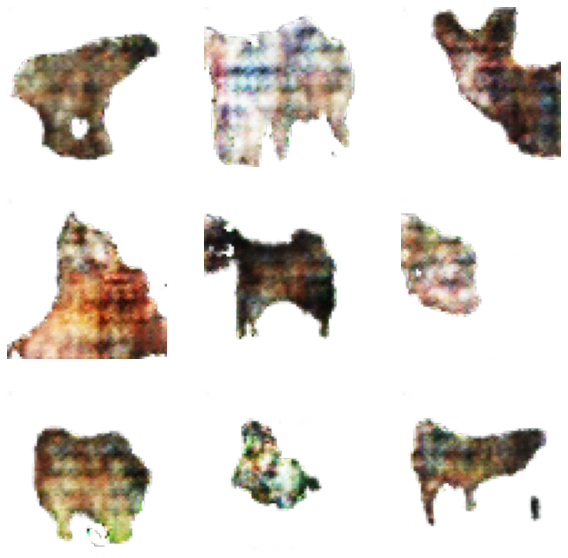

Epoch: 211 Generator loss: 3.0662572383880615 Discriminator loss: 0.14654062688350677
Epoch: 212 Generator loss: 4.844945907592773 Discriminator loss: 0.034938663244247437
Epoch: 213 Generator loss: 4.471492290496826 Discriminator loss: 0.12109219282865524
Epoch: 214 Generator loss: 4.688272476196289 Discriminator loss: 0.06853236258029938
Epoch: 215 Generator loss: 3.143160343170166 Discriminator loss: 0.1383397877216339
Epoch: 216 Generator loss: 3.640286922454834 Discriminator loss: 0.08726291358470917
Epoch: 217 Generator loss: 5.1090617179870605 Discriminator loss: 0.18722745776176453
Epoch: 218 Generator loss: 5.91780948638916 Discriminator loss: 0.04641774296760559
Epoch: 219 Generator loss: 4.202105522155762 Discriminator loss: 0.07378806173801422
Epoch: 220 Generator loss: 5.786040782928467 Discriminator loss: 0.07174194604158401


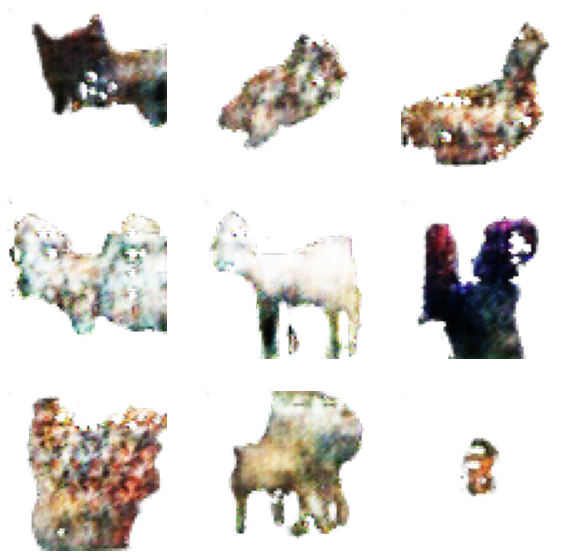

Epoch: 221 Generator loss: 5.464595317840576 Discriminator loss: 0.08058354258537292
Epoch: 222 Generator loss: 7.900639533996582 Discriminator loss: 0.07308400422334671
Epoch: 223 Generator loss: 4.670566558837891 Discriminator loss: 0.09811857342720032
Epoch: 224 Generator loss: 8.80758285522461 Discriminator loss: 0.12259470671415329
Epoch: 225 Generator loss: 5.476222038269043 Discriminator loss: 0.057861920446157455
Epoch: 226 Generator loss: 1.228238582611084 Discriminator loss: 0.6526656746864319
Epoch: 227 Generator loss: 7.402529716491699 Discriminator loss: 0.24613122642040253
Epoch: 228 Generator loss: 4.436853408813477 Discriminator loss: 0.06930563598871231
Epoch: 229 Generator loss: 4.894325256347656 Discriminator loss: 0.0717884972691536
Epoch: 230 Generator loss: 5.657537937164307 Discriminator loss: 0.019810598343610764


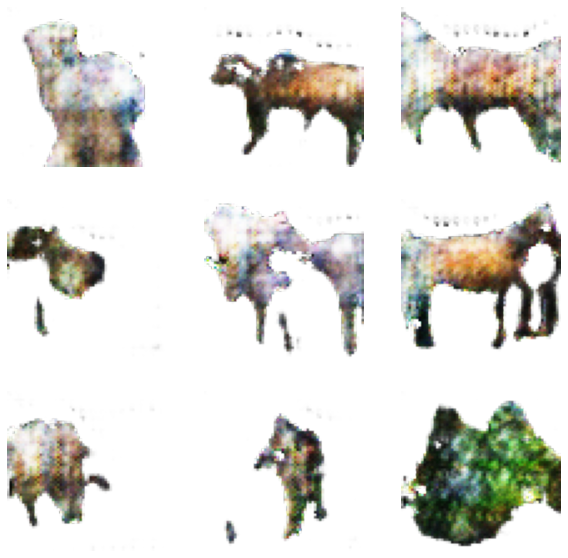

Epoch: 231 Generator loss: 2.3063066005706787 Discriminator loss: 0.27337267994880676
Epoch: 232 Generator loss: 6.362626552581787 Discriminator loss: 0.22146955132484436
Epoch: 233 Generator loss: 13.26754379272461 Discriminator loss: 5.640296459197998
Epoch: 234 Generator loss: 0.22364988923072815 Discriminator loss: 2.4552249908447266
Epoch: 235 Generator loss: 3.696319341659546 Discriminator loss: 0.08347990363836288
Epoch: 236 Generator loss: 4.5707106590271 Discriminator loss: 0.1042100265622139
Epoch: 237 Generator loss: 10.527118682861328 Discriminator loss: 0.8212847709655762
Epoch: 238 Generator loss: 4.795727729797363 Discriminator loss: 0.10325871407985687
Epoch: 239 Generator loss: 5.771516799926758 Discriminator loss: 0.026389606297016144
Epoch: 240 Generator loss: 3.130703926086426 Discriminator loss: 0.1801992952823639


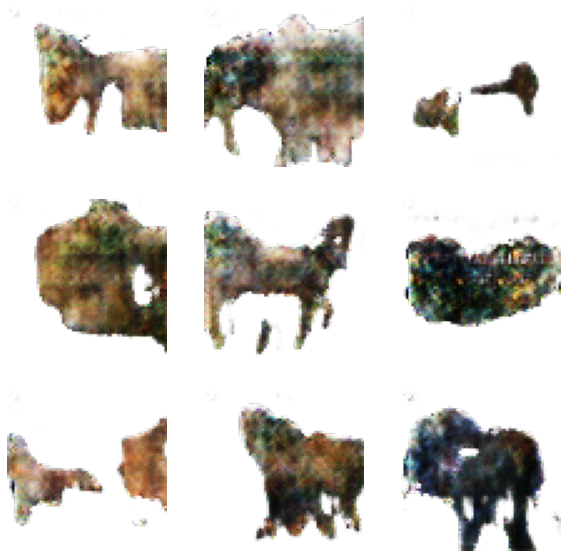

Epoch: 241 Generator loss: 5.398029804229736 Discriminator loss: 0.03468818962574005
Epoch: 242 Generator loss: 4.43008279800415 Discriminator loss: 0.045340776443481445
Epoch: 243 Generator loss: 3.607048988342285 Discriminator loss: 0.0737694650888443
Epoch: 244 Generator loss: 4.046375274658203 Discriminator loss: 0.062189605087041855
Epoch: 245 Generator loss: 6.305586338043213 Discriminator loss: 0.5497376918792725
Epoch: 246 Generator loss: 2.585783004760742 Discriminator loss: 0.18254253268241882
Epoch: 247 Generator loss: 3.1725990772247314 Discriminator loss: 0.09964847564697266
Epoch: 248 Generator loss: 3.7187387943267822 Discriminator loss: 0.15541821718215942
Epoch: 249 Generator loss: 4.996289253234863 Discriminator loss: 0.029797308146953583
Epoch: 250 Generator loss: 3.4167113304138184 Discriminator loss: 0.11211977154016495


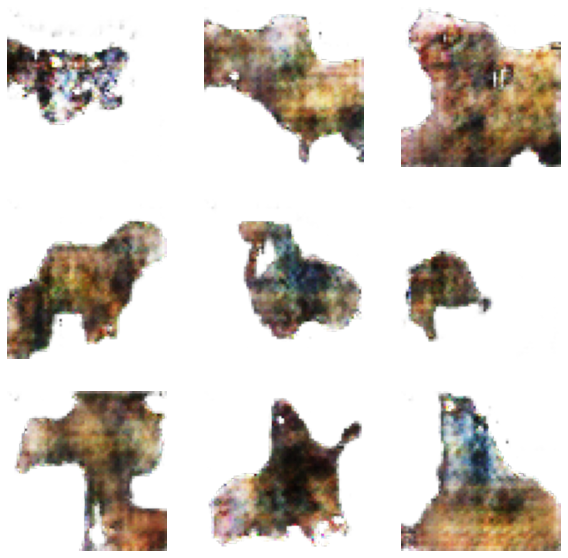

Epoch: 251 Generator loss: 1.4552717208862305 Discriminator loss: 0.5563114285469055
Epoch: 252 Generator loss: 3.2038967609405518 Discriminator loss: 0.11462338268756866
Epoch: 253 Generator loss: 4.161915302276611 Discriminator loss: 0.06694024056196213
Epoch: 254 Generator loss: 3.064182758331299 Discriminator loss: 0.15622004866600037
Epoch: 255 Generator loss: 9.041889190673828 Discriminator loss: 0.20821477472782135
Epoch: 256 Generator loss: 1.103359580039978 Discriminator loss: 0.7591318488121033
Epoch: 257 Generator loss: 3.233872890472412 Discriminator loss: 0.10690058022737503
Epoch: 258 Generator loss: 5.682897567749023 Discriminator loss: 0.1441054344177246
Epoch: 259 Generator loss: 6.973921298980713 Discriminator loss: 0.18832112848758698
Epoch: 260 Generator loss: 5.414127826690674 Discriminator loss: 0.02791745588183403


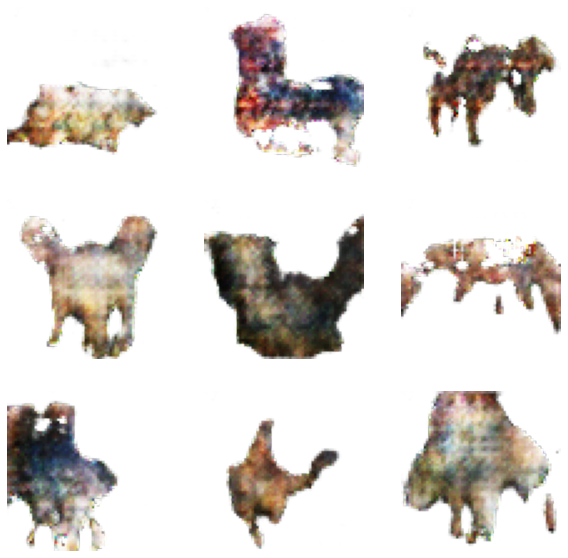

Epoch: 261 Generator loss: 2.8596372604370117 Discriminator loss: 0.14974653720855713
Epoch: 262 Generator loss: 8.174131393432617 Discriminator loss: 0.9010215997695923
Epoch: 263 Generator loss: 5.018865585327148 Discriminator loss: 0.07416336983442307
Epoch: 264 Generator loss: 7.084206581115723 Discriminator loss: 0.19609016180038452
Epoch: 265 Generator loss: 3.5339717864990234 Discriminator loss: 0.07030980288982391
Epoch: 266 Generator loss: 4.3167524337768555 Discriminator loss: 0.0647851973772049
Epoch: 267 Generator loss: 5.248178482055664 Discriminator loss: 0.06823118776082993
Epoch: 268 Generator loss: 5.708738803863525 Discriminator loss: 0.11068442463874817
Epoch: 269 Generator loss: 5.315392971038818 Discriminator loss: 0.10514354705810547
Epoch: 270 Generator loss: 5.650442600250244 Discriminator loss: 0.018282756209373474


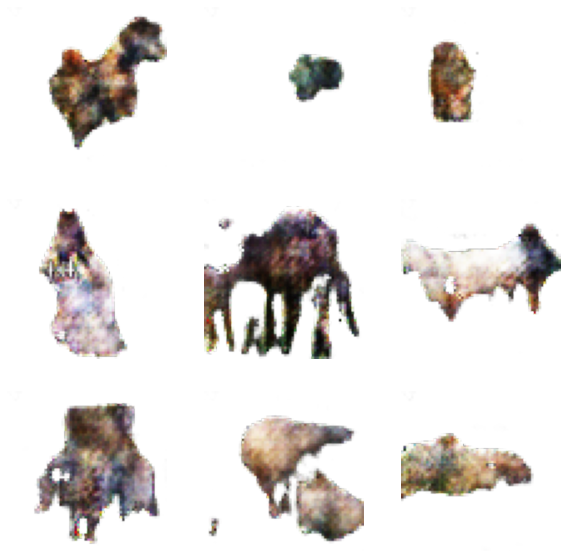

Epoch: 271 Generator loss: 3.7462713718414307 Discriminator loss: 0.13173675537109375
Epoch: 272 Generator loss: 4.469584941864014 Discriminator loss: 0.04651964455842972
Epoch: 273 Generator loss: 1.9092079401016235 Discriminator loss: 0.3198694884777069
Epoch: 274 Generator loss: 6.616575241088867 Discriminator loss: 0.05395786464214325
Epoch: 275 Generator loss: 2.269179582595825 Discriminator loss: 0.2936886250972748
Epoch: 276 Generator loss: 1.8118516206741333 Discriminator loss: 0.37108370661735535
Epoch: 277 Generator loss: 4.5783867835998535 Discriminator loss: 0.06350581347942352
Epoch: 278 Generator loss: 3.6843271255493164 Discriminator loss: 0.10340971499681473
Epoch: 279 Generator loss: 3.5964646339416504 Discriminator loss: 0.2588101029396057
Epoch: 280 Generator loss: 5.816189765930176 Discriminator loss: 0.11535432189702988


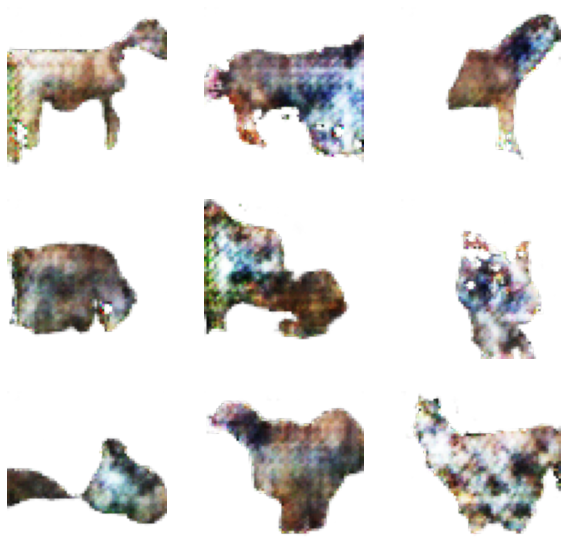

Epoch: 281 Generator loss: 2.7324178218841553 Discriminator loss: 0.18937212228775024
Epoch: 282 Generator loss: 5.518931865692139 Discriminator loss: 0.06512294709682465
Epoch: 283 Generator loss: 8.092816352844238 Discriminator loss: 0.14348217844963074
Epoch: 284 Generator loss: 10.310150146484375 Discriminator loss: 0.4501582682132721
Epoch: 285 Generator loss: 1.6179680824279785 Discriminator loss: 0.47495272755622864
Epoch: 286 Generator loss: 5.697721004486084 Discriminator loss: 0.3499125838279724
Epoch: 287 Generator loss: 0.7406564950942993 Discriminator loss: 1.2365059852600098
Epoch: 288 Generator loss: 4.5645551681518555 Discriminator loss: 0.0327395424246788
Epoch: 289 Generator loss: 13.252703666687012 Discriminator loss: 1.8282822370529175
Epoch: 290 Generator loss: 7.267242908477783 Discriminator loss: 1.039074182510376


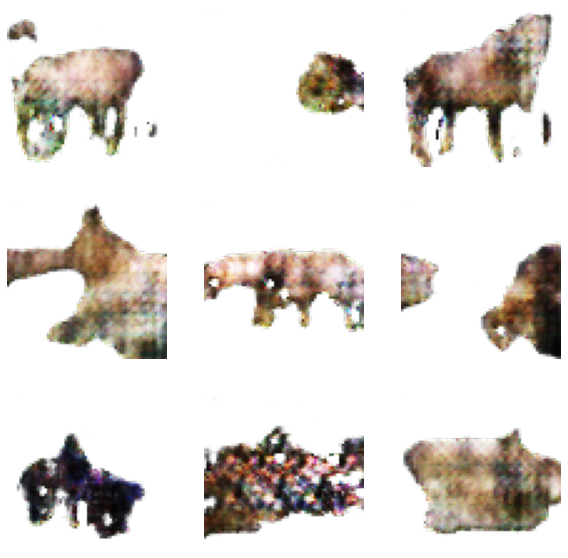

Epoch: 291 Generator loss: 3.8214430809020996 Discriminator loss: 0.08424220979213715
Epoch: 292 Generator loss: 4.9263916015625 Discriminator loss: 0.04969470575451851
Epoch: 293 Generator loss: 3.645634412765503 Discriminator loss: 0.07732998579740524
Epoch: 294 Generator loss: 0.6547294855117798 Discriminator loss: 1.2723312377929688
Epoch: 295 Generator loss: 4.219480514526367 Discriminator loss: 0.05682585388422012
Epoch: 296 Generator loss: 3.4865164756774902 Discriminator loss: 0.0755273848772049
Epoch: 297 Generator loss: 1.7950972318649292 Discriminator loss: 0.4493585228919983
Epoch: 298 Generator loss: 3.647292137145996 Discriminator loss: 0.0845835879445076
Epoch: 299 Generator loss: 5.109683036804199 Discriminator loss: 0.02727937139570713
Epoch: 300 Generator loss: 5.499533653259277 Discriminator loss: 0.027988366782665253


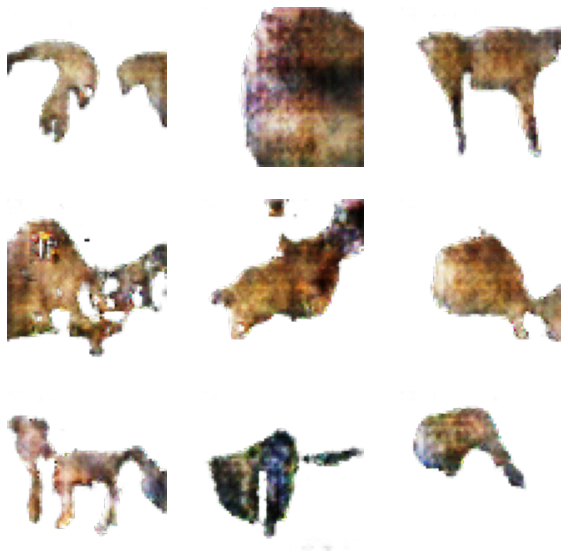

Epoch: 301 Generator loss: 5.292081832885742 Discriminator loss: 0.032831039279699326
Epoch: 302 Generator loss: 0.748066782951355 Discriminator loss: 1.0306541919708252
Epoch: 303 Generator loss: 4.8940348625183105 Discriminator loss: 0.049151912331581116
Epoch: 304 Generator loss: 6.991928577423096 Discriminator loss: 0.32354602217674255
Epoch: 305 Generator loss: 3.7528345584869385 Discriminator loss: 0.10745713859796524
Epoch: 306 Generator loss: 4.982022285461426 Discriminator loss: 0.07863900065422058
Epoch: 307 Generator loss: 4.076026439666748 Discriminator loss: 0.16039234399795532
Epoch: 308 Generator loss: 3.3238844871520996 Discriminator loss: 0.1358914077281952
Epoch: 309 Generator loss: 1.272812008857727 Discriminator loss: 0.6699475049972534
Epoch: 310 Generator loss: 4.306854248046875 Discriminator loss: 0.060477837920188904


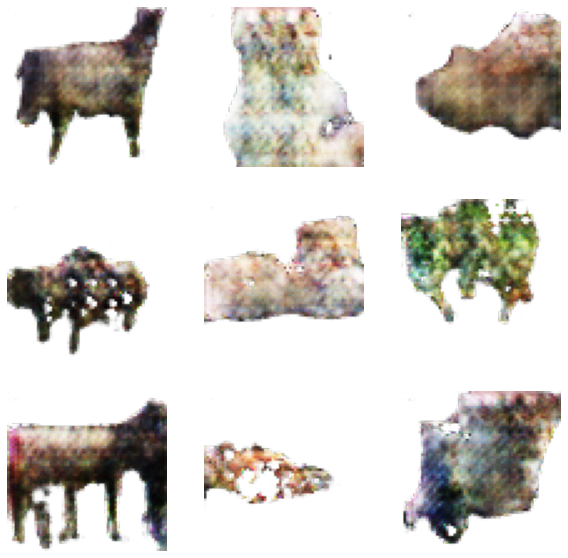

Epoch: 311 Generator loss: 12.222481727600098 Discriminator loss: 0.9564092755317688
Epoch: 312 Generator loss: 4.8554277420043945 Discriminator loss: 0.021932709962129593
Epoch: 313 Generator loss: 8.097070693969727 Discriminator loss: 0.01934659108519554
Epoch: 314 Generator loss: 3.297502040863037 Discriminator loss: 0.11651171743869781
Epoch: 315 Generator loss: 0.225849449634552 Discriminator loss: 2.448946714401245
Epoch: 316 Generator loss: 4.43142032623291 Discriminator loss: 0.08815638720989227
Epoch: 317 Generator loss: 0.364401251077652 Discriminator loss: 1.746764898300171
Epoch: 318 Generator loss: 4.632888317108154 Discriminator loss: 0.06956876069307327
Epoch: 319 Generator loss: 5.4580559730529785 Discriminator loss: 0.037730682641267776
Epoch: 320 Generator loss: 5.062746047973633 Discriminator loss: 0.019797582179307938


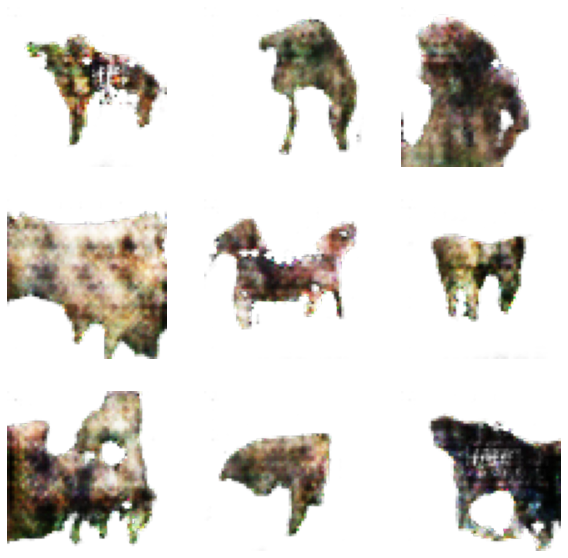

Epoch: 321 Generator loss: 5.193826198577881 Discriminator loss: 0.08539620041847229
Epoch: 322 Generator loss: 4.269839286804199 Discriminator loss: 0.04710200056433678
Epoch: 323 Generator loss: 2.134690761566162 Discriminator loss: 0.2955453395843506
Epoch: 324 Generator loss: 7.860694408416748 Discriminator loss: 0.14337100088596344
Epoch: 325 Generator loss: 4.556092262268066 Discriminator loss: 0.08353623747825623
Epoch: 326 Generator loss: 1.0528807640075684 Discriminator loss: 0.7809193134307861
Epoch: 327 Generator loss: 2.755847215652466 Discriminator loss: 0.17613527178764343
Epoch: 328 Generator loss: 2.583038568496704 Discriminator loss: 0.2087584137916565
Epoch: 329 Generator loss: 6.446368217468262 Discriminator loss: 0.1042325347661972
Epoch: 330 Generator loss: 6.471487998962402 Discriminator loss: 0.024697771295905113


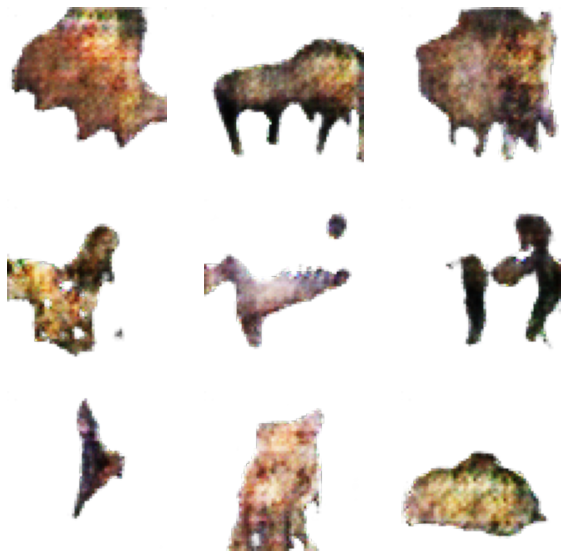

Epoch: 331 Generator loss: 5.349506378173828 Discriminator loss: 0.06706350296735764
Epoch: 332 Generator loss: 5.073068141937256 Discriminator loss: 0.03909852355718613
Epoch: 333 Generator loss: 4.252921104431152 Discriminator loss: 0.056215569376945496
Epoch: 334 Generator loss: 4.438530921936035 Discriminator loss: 0.08933527767658234
Epoch: 335 Generator loss: 4.205723762512207 Discriminator loss: 0.07400968670845032
Epoch: 336 Generator loss: 2.4789252281188965 Discriminator loss: 0.22923801839351654
Epoch: 337 Generator loss: 4.292825698852539 Discriminator loss: 0.049626804888248444
Epoch: 338 Generator loss: 5.7481889724731445 Discriminator loss: 0.014152400195598602
Epoch: 339 Generator loss: 3.958766222000122 Discriminator loss: 0.06485124677419662
Epoch: 340 Generator loss: 0.708139955997467 Discriminator loss: 1.1667670011520386


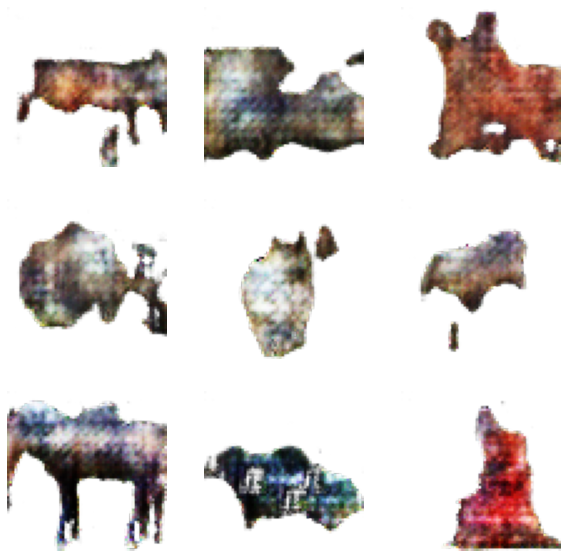

Epoch: 341 Generator loss: 7.714278697967529 Discriminator loss: 0.016161862760782242
Epoch: 342 Generator loss: 4.077615261077881 Discriminator loss: 0.0669138953089714
Epoch: 343 Generator loss: 0.2159968912601471 Discriminator loss: 2.4078383445739746
Epoch: 344 Generator loss: 6.303732872009277 Discriminator loss: 0.07581887394189835
Epoch: 345 Generator loss: 8.222630500793457 Discriminator loss: 0.26775211095809937
Epoch: 346 Generator loss: 0.1310916543006897 Discriminator loss: 3.1752231121063232
Epoch: 347 Generator loss: 3.9386215209960938 Discriminator loss: 0.04833969101309776
Epoch: 348 Generator loss: 4.188492298126221 Discriminator loss: 0.047133930027484894
Epoch: 349 Generator loss: 4.308798313140869 Discriminator loss: 0.09493595361709595
Epoch: 350 Generator loss: 2.5290520191192627 Discriminator loss: 0.19887672364711761


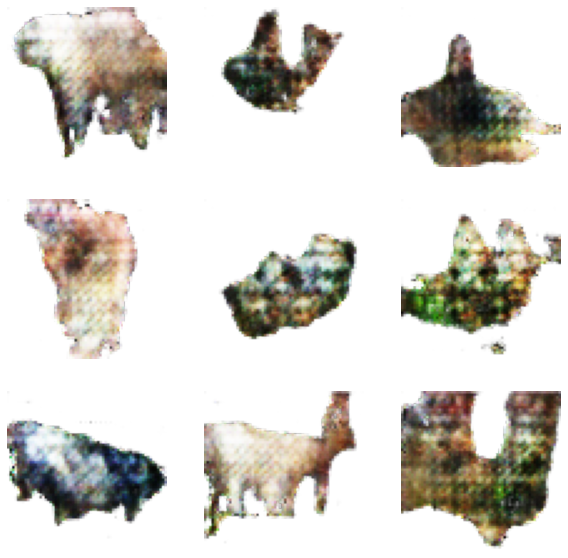

Epoch: 351 Generator loss: 0.9251703023910522 Discriminator loss: 0.8963513374328613
Epoch: 352 Generator loss: 4.326868057250977 Discriminator loss: 0.057191863656044006
Epoch: 353 Generator loss: 2.201761245727539 Discriminator loss: 0.2744235396385193
Epoch: 354 Generator loss: 7.519381523132324 Discriminator loss: 0.021714720875024796
Epoch: 355 Generator loss: 2.89278507232666 Discriminator loss: 0.15446016192436218
Epoch: 356 Generator loss: 3.7698168754577637 Discriminator loss: 0.07440327107906342
Epoch: 357 Generator loss: 2.144463062286377 Discriminator loss: 0.2720696032047272
Epoch: 358 Generator loss: 8.230108261108398 Discriminator loss: 0.41917499899864197
Epoch: 359 Generator loss: 2.0204672813415527 Discriminator loss: 0.3280665874481201
Epoch: 360 Generator loss: 7.114503860473633 Discriminator loss: 0.02532968483865261


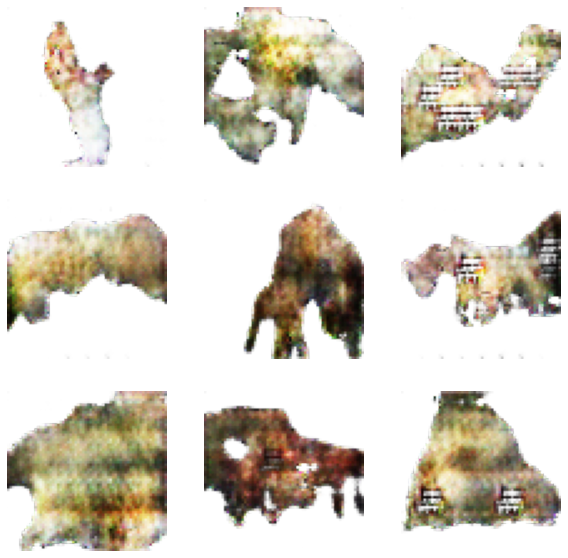

Epoch: 361 Generator loss: 0.3481811583042145 Discriminator loss: 1.6845533847808838
Epoch: 362 Generator loss: 3.9186816215515137 Discriminator loss: 0.08378150314092636
Epoch: 363 Generator loss: 4.058561325073242 Discriminator loss: 0.09039599448442459
Epoch: 364 Generator loss: 5.852658748626709 Discriminator loss: 0.42804935574531555
Epoch: 365 Generator loss: 4.6214985847473145 Discriminator loss: 0.3879961371421814
Epoch: 366 Generator loss: 6.098166465759277 Discriminator loss: 0.1189659908413887
Epoch: 367 Generator loss: 4.263233184814453 Discriminator loss: 0.08866184204816818
Epoch: 368 Generator loss: 3.1235504150390625 Discriminator loss: 0.15088115632534027
Epoch: 369 Generator loss: 1.469906210899353 Discriminator loss: 0.5624480247497559
Epoch: 370 Generator loss: 5.9952569007873535 Discriminator loss: 0.05129487067461014


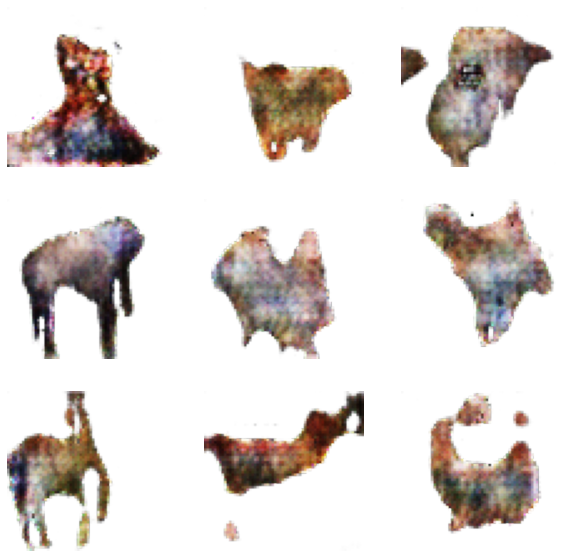

Epoch: 371 Generator loss: 6.476367950439453 Discriminator loss: 0.09626374393701553
Epoch: 372 Generator loss: 5.216579437255859 Discriminator loss: 0.09036491066217422
Epoch: 373 Generator loss: 3.530564785003662 Discriminator loss: 0.10454987734556198
Epoch: 374 Generator loss: 7.617684364318848 Discriminator loss: 0.031730979681015015
Epoch: 375 Generator loss: 2.288419246673584 Discriminator loss: 0.33595097064971924
Epoch: 376 Generator loss: 1.1370724439620972 Discriminator loss: 0.6580715179443359
Epoch: 377 Generator loss: 5.814255237579346 Discriminator loss: 0.049847185611724854
Epoch: 378 Generator loss: 5.501830577850342 Discriminator loss: 0.01470975112169981
Epoch: 379 Generator loss: 3.5329346656799316 Discriminator loss: 0.113654226064682
Epoch: 380 Generator loss: 4.325897693634033 Discriminator loss: 0.07271197438240051


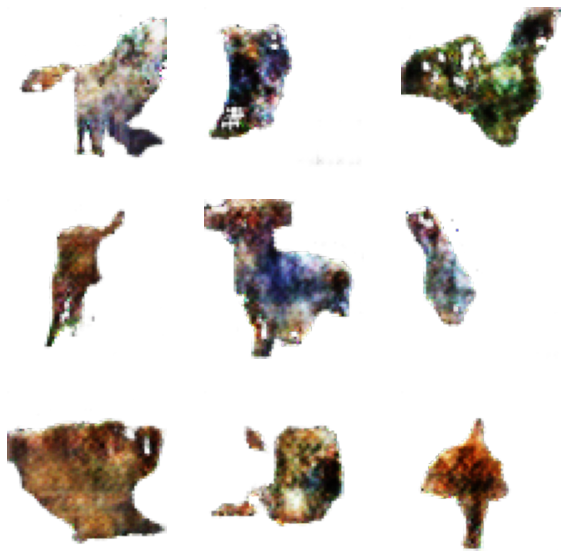

Epoch: 381 Generator loss: 2.0889689922332764 Discriminator loss: 0.3517833948135376
Epoch: 382 Generator loss: 6.03460693359375 Discriminator loss: 0.04120310768485069
Epoch: 383 Generator loss: 3.816222906112671 Discriminator loss: 0.11638042330741882
Epoch: 384 Generator loss: 6.561690807342529 Discriminator loss: 0.16527755558490753
Epoch: 385 Generator loss: 5.498301982879639 Discriminator loss: 0.3819426894187927
Epoch: 386 Generator loss: 8.927347183227539 Discriminator loss: 0.04162236303091049
Epoch: 387 Generator loss: 0.0881122276186943 Discriminator loss: 3.5386769771575928
Epoch: 388 Generator loss: 6.094763278961182 Discriminator loss: 0.0845378190279007
Epoch: 389 Generator loss: 8.128494262695312 Discriminator loss: 0.04865124076604843
Epoch: 390 Generator loss: 8.2875337600708 Discriminator loss: 0.30245241522789


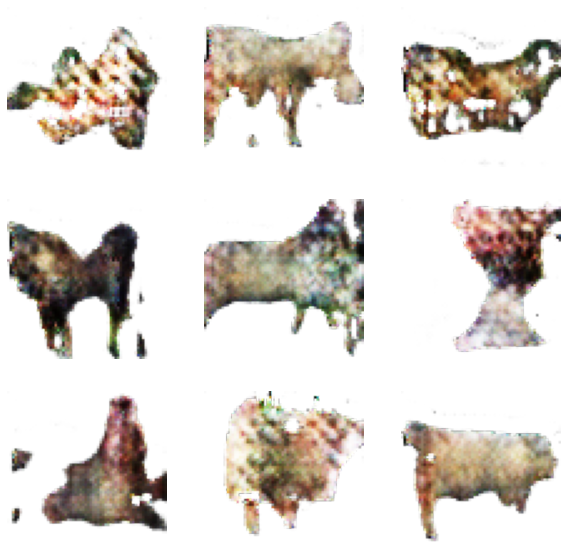

Epoch: 391 Generator loss: 11.430188179016113 Discriminator loss: 0.3389466404914856
Epoch: 392 Generator loss: 2.6867730617523193 Discriminator loss: 0.18325768411159515
Epoch: 393 Generator loss: 7.931511878967285 Discriminator loss: 0.008627139031887054
Epoch: 394 Generator loss: 6.098167896270752 Discriminator loss: 0.2500213384628296
Epoch: 395 Generator loss: 6.963994026184082 Discriminator loss: 0.09273695945739746
Epoch: 396 Generator loss: 7.355341911315918 Discriminator loss: 0.015407483093440533
Epoch: 397 Generator loss: 6.958974838256836 Discriminator loss: 0.025602495297789574
Epoch: 398 Generator loss: 9.541516304016113 Discriminator loss: 1.723550796508789
Epoch: 399 Generator loss: 2.285209894180298 Discriminator loss: 0.2897864878177643
Epoch: 400 Generator loss: 4.645830154418945 Discriminator loss: 0.030102882534265518


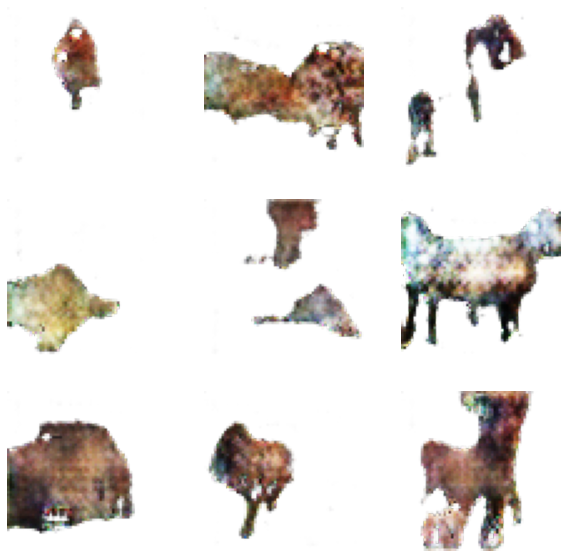

Epoch: 401 Generator loss: 6.2884440422058105 Discriminator loss: 0.009927271865308285
Epoch: 402 Generator loss: 8.181146621704102 Discriminator loss: 0.21044965088367462
Epoch: 403 Generator loss: 0.7325659990310669 Discriminator loss: 1.3800363540649414
Epoch: 404 Generator loss: 2.319756507873535 Discriminator loss: 0.23783427476882935
Epoch: 405 Generator loss: 4.514283180236816 Discriminator loss: 0.06893394142389297
Epoch: 406 Generator loss: 1.9685488939285278 Discriminator loss: 0.34739169478416443
Epoch: 407 Generator loss: 12.418830871582031 Discriminator loss: 1.0844461917877197
Epoch: 408 Generator loss: 5.174129009246826 Discriminator loss: 0.033939868211746216
Epoch: 409 Generator loss: 8.978452682495117 Discriminator loss: 0.048347555100917816
Epoch: 410 Generator loss: 1.8028148412704468 Discriminator loss: 0.39854589104652405


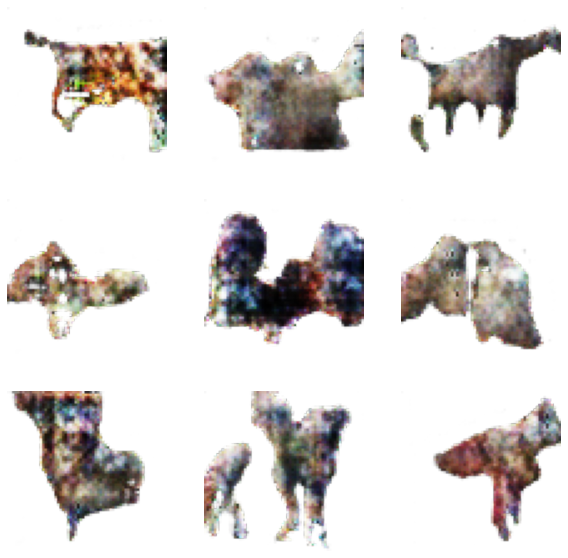

Epoch: 411 Generator loss: 1.5234750509262085 Discriminator loss: 0.5765847563743591
Epoch: 412 Generator loss: 3.856640577316284 Discriminator loss: 0.07642444968223572
Epoch: 413 Generator loss: 2.2127530574798584 Discriminator loss: 0.23558993637561798
Epoch: 414 Generator loss: 0.9138078093528748 Discriminator loss: 0.9923884868621826
Epoch: 415 Generator loss: 1.4835988283157349 Discriminator loss: 0.5936151146888733
Epoch: 416 Generator loss: 3.4573895931243896 Discriminator loss: 0.09063776582479477
Epoch: 417 Generator loss: 7.0660810470581055 Discriminator loss: 0.0068340301513671875
Epoch: 418 Generator loss: 2.466723680496216 Discriminator loss: 0.2316080629825592
Epoch: 419 Generator loss: 5.019790172576904 Discriminator loss: 0.0744519904255867
Epoch: 420 Generator loss: 5.6063032150268555 Discriminator loss: 0.03527626767754555


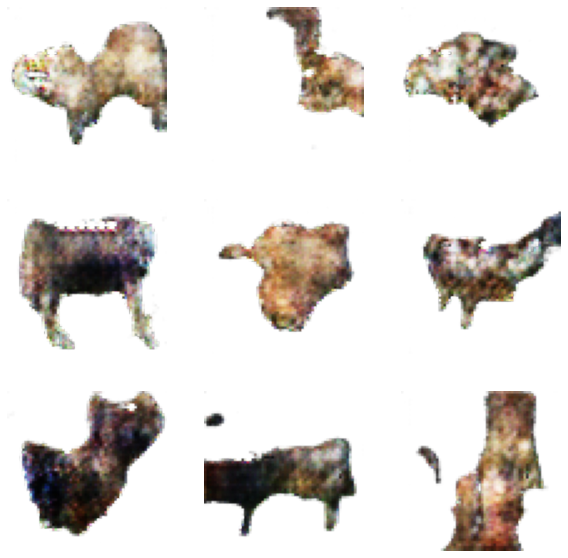

Epoch: 421 Generator loss: 2.372601270675659 Discriminator loss: 0.2664099335670471
Epoch: 422 Generator loss: 5.777346611022949 Discriminator loss: 0.01573258824646473
Epoch: 423 Generator loss: 4.986033916473389 Discriminator loss: 0.01883849687874317
Epoch: 424 Generator loss: 7.860409736633301 Discriminator loss: 0.031689442694187164
Epoch: 425 Generator loss: 9.829719543457031 Discriminator loss: 0.4094174802303314
Epoch: 426 Generator loss: 3.2071585655212402 Discriminator loss: 0.09897010028362274
Epoch: 427 Generator loss: 7.588900566101074 Discriminator loss: 0.022762920707464218
Epoch: 428 Generator loss: 4.206209659576416 Discriminator loss: 0.047438159584999084
Epoch: 429 Generator loss: 6.695561408996582 Discriminator loss: 0.01543763093650341
Epoch: 430 Generator loss: 7.867155075073242 Discriminator loss: 0.18798686563968658


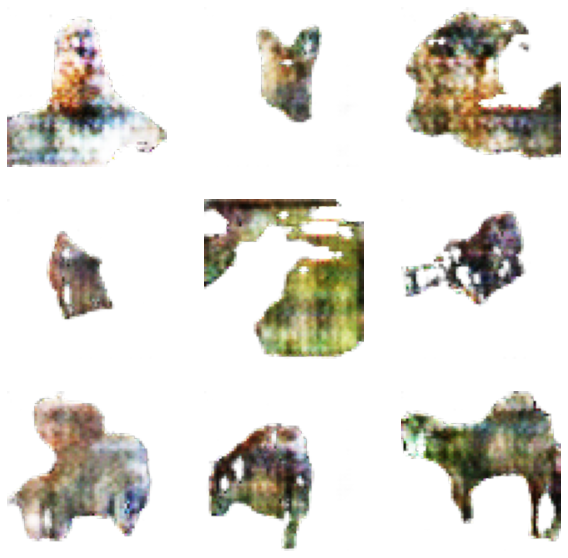

Epoch: 431 Generator loss: 0.8783010244369507 Discriminator loss: 1.1412066221237183
Epoch: 432 Generator loss: 8.573004722595215 Discriminator loss: 0.07159395515918732
Epoch: 433 Generator loss: 1.934110403060913 Discriminator loss: 0.3564390242099762
Epoch: 434 Generator loss: 7.7456865310668945 Discriminator loss: 0.1285170018672943
Epoch: 435 Generator loss: 10.475523948669434 Discriminator loss: 0.522101879119873
Epoch: 436 Generator loss: 7.7468414306640625 Discriminator loss: 0.01658969186246395
Epoch: 437 Generator loss: 5.887383937835693 Discriminator loss: 0.025379367172718048
Epoch: 438 Generator loss: 7.103511810302734 Discriminator loss: 0.041277047246694565
Epoch: 439 Generator loss: 5.371382236480713 Discriminator loss: 0.02158084511756897
Epoch: 440 Generator loss: 6.197521209716797 Discriminator loss: 0.06234203651547432


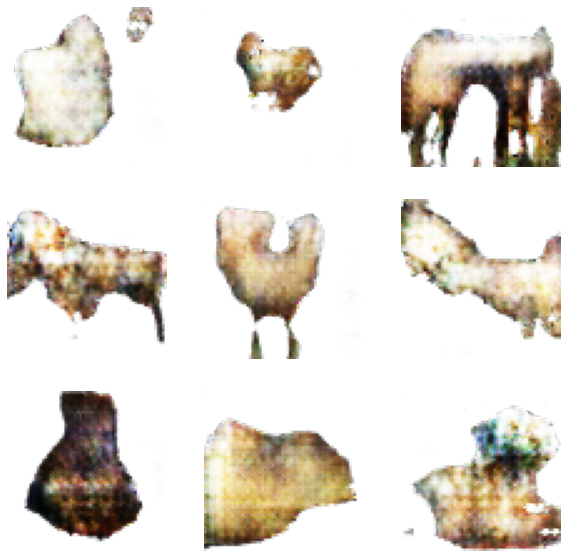

Epoch: 441 Generator loss: 0.887928307056427 Discriminator loss: 0.9863536357879639
Epoch: 442 Generator loss: 8.062907218933105 Discriminator loss: 0.15928658843040466
Epoch: 443 Generator loss: 5.373681545257568 Discriminator loss: 0.1311974823474884
Epoch: 444 Generator loss: 6.405177116394043 Discriminator loss: 0.051857903599739075
Epoch: 445 Generator loss: 6.026615619659424 Discriminator loss: 0.030698293820023537
Epoch: 446 Generator loss: 6.23489236831665 Discriminator loss: 0.13404536247253418
Epoch: 447 Generator loss: 9.643908500671387 Discriminator loss: 2.389756441116333
Epoch: 448 Generator loss: 4.225048542022705 Discriminator loss: 0.051588647067546844
Epoch: 449 Generator loss: 3.714729070663452 Discriminator loss: 0.06880785524845123
Epoch: 450 Generator loss: 4.185479164123535 Discriminator loss: 0.06544145196676254


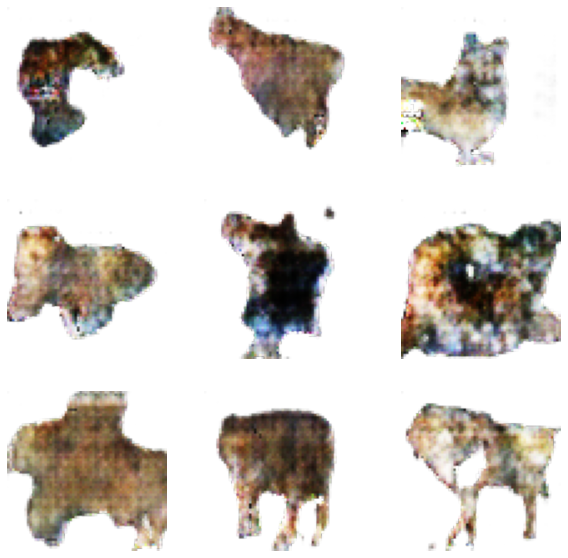

Epoch: 451 Generator loss: 7.573814868927002 Discriminator loss: 0.16066831350326538
Epoch: 452 Generator loss: 7.064579963684082 Discriminator loss: 0.0687723457813263
Epoch: 453 Generator loss: 5.9534912109375 Discriminator loss: 0.02508406713604927
Epoch: 454 Generator loss: 11.990030288696289 Discriminator loss: 0.5519517660140991
Epoch: 455 Generator loss: 5.862526893615723 Discriminator loss: 0.05949845165014267
Epoch: 456 Generator loss: 2.024416923522949 Discriminator loss: 0.31034547090530396
Epoch: 457 Generator loss: 2.7453811168670654 Discriminator loss: 0.28056618571281433
Epoch: 458 Generator loss: 8.114694595336914 Discriminator loss: 0.02173362299799919
Epoch: 459 Generator loss: 4.263166427612305 Discriminator loss: 0.055293187499046326
Epoch: 460 Generator loss: 7.010156154632568 Discriminator loss: 0.22130221128463745


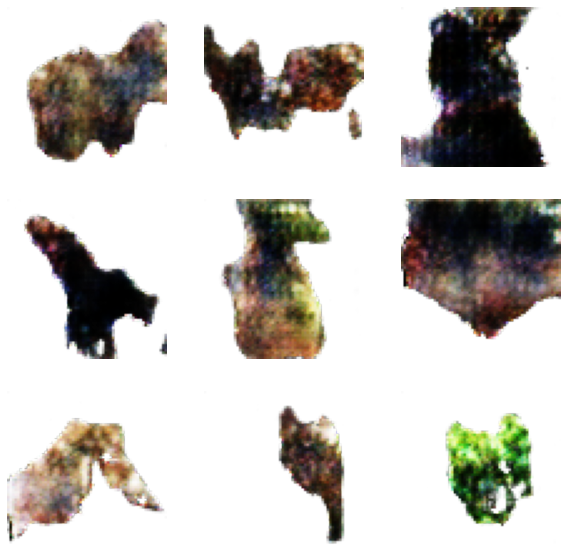

Epoch: 461 Generator loss: 4.541601181030273 Discriminator loss: 0.033008426427841187
Epoch: 462 Generator loss: 6.797079563140869 Discriminator loss: 0.007780599407851696
Epoch: 463 Generator loss: 4.501580715179443 Discriminator loss: 0.03182285279035568
Epoch: 464 Generator loss: 3.784111261367798 Discriminator loss: 0.059485066682100296
Epoch: 465 Generator loss: 3.308929204940796 Discriminator loss: 0.10468797385692596
Epoch: 466 Generator loss: 8.694387435913086 Discriminator loss: 0.5329917669296265
Epoch: 467 Generator loss: 5.2821760177612305 Discriminator loss: 0.2305493950843811
Epoch: 468 Generator loss: 8.551669120788574 Discriminator loss: 0.04256308823823929
Epoch: 469 Generator loss: 2.702846050262451 Discriminator loss: 0.16946519911289215
Epoch: 470 Generator loss: 4.585207939147949 Discriminator loss: 0.037337303161621094


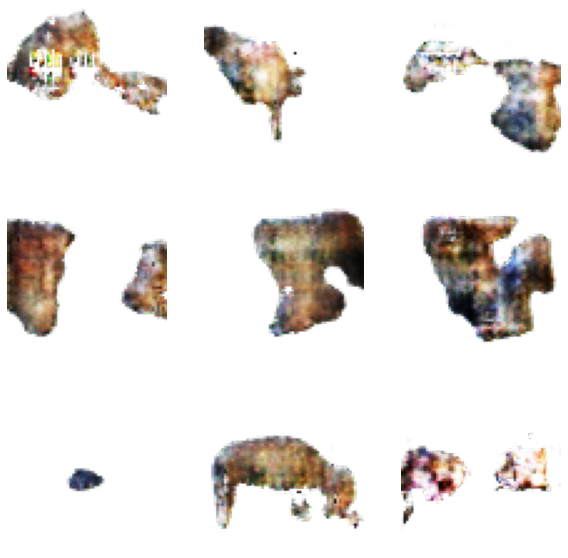

Epoch: 471 Generator loss: 3.8504791259765625 Discriminator loss: 0.10675352811813354
Epoch: 472 Generator loss: 5.414571762084961 Discriminator loss: 0.02434675395488739
Epoch: 473 Generator loss: 4.281497955322266 Discriminator loss: 0.0735815092921257
Epoch: 474 Generator loss: 3.965977191925049 Discriminator loss: 0.062467627227306366
Epoch: 475 Generator loss: 5.504392623901367 Discriminator loss: 0.09821392595767975
Epoch: 476 Generator loss: 6.281653881072998 Discriminator loss: 0.033904898911714554
Epoch: 477 Generator loss: 6.388200759887695 Discriminator loss: 0.008431687019765377
Epoch: 478 Generator loss: 3.6930267810821533 Discriminator loss: 0.06362578272819519
Epoch: 479 Generator loss: 7.1609272956848145 Discriminator loss: 0.11570719629526138
Epoch: 480 Generator loss: 7.622137546539307 Discriminator loss: 0.0332474559545517


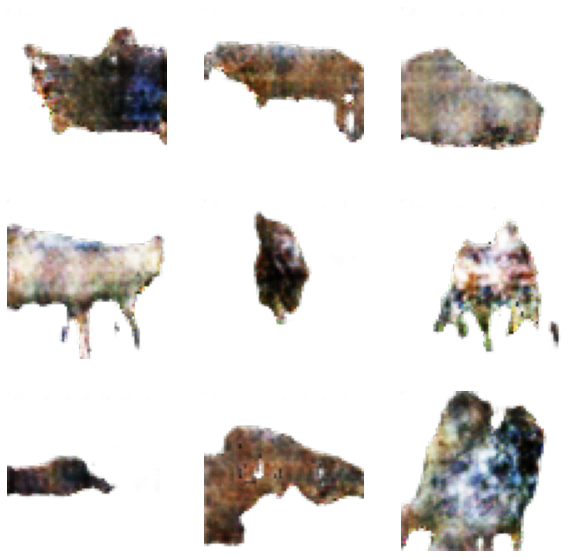

Epoch: 481 Generator loss: 6.726372241973877 Discriminator loss: 0.13887234032154083
Epoch: 482 Generator loss: 6.482034683227539 Discriminator loss: 0.21137575805187225
Epoch: 483 Generator loss: 5.754196643829346 Discriminator loss: 0.02988436445593834
Epoch: 484 Generator loss: 4.705585479736328 Discriminator loss: 0.060023535043001175
Epoch: 485 Generator loss: 3.186842679977417 Discriminator loss: 0.18435163795948029
Epoch: 486 Generator loss: 5.168145179748535 Discriminator loss: 0.017890390008687973
Epoch: 487 Generator loss: 4.19091272354126 Discriminator loss: 0.08203160762786865
Epoch: 488 Generator loss: 8.93692684173584 Discriminator loss: 0.08241891115903854
Epoch: 489 Generator loss: 1.1288734674453735 Discriminator loss: 0.758557915687561
Epoch: 490 Generator loss: 0.7692791819572449 Discriminator loss: 1.0650604963302612


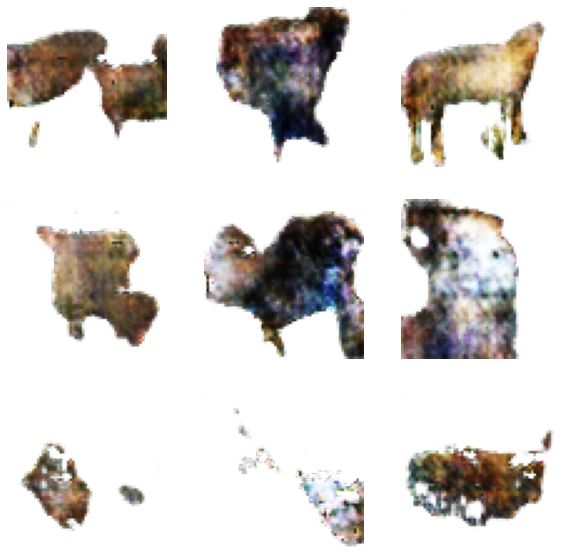

Epoch: 491 Generator loss: 2.1080129146575928 Discriminator loss: 0.34331610798835754
Epoch: 492 Generator loss: 7.312655448913574 Discriminator loss: 0.06817854940891266
Epoch: 493 Generator loss: 6.2893853187561035 Discriminator loss: 0.06750039011240005
Epoch: 494 Generator loss: 4.148611545562744 Discriminator loss: 0.050865042954683304
Epoch: 495 Generator loss: 2.8198583126068115 Discriminator loss: 0.17714640498161316
Epoch: 496 Generator loss: 5.302124500274658 Discriminator loss: 0.04963906109333038
Epoch: 497 Generator loss: 5.1633806228637695 Discriminator loss: 0.025568664073944092
Epoch: 498 Generator loss: 4.001749038696289 Discriminator loss: 0.1439855992794037
Epoch: 499 Generator loss: 4.139439105987549 Discriminator loss: 0.05717850103974342
Epoch: 500 Generator loss: 3.5374956130981445 Discriminator loss: 0.07602636516094208


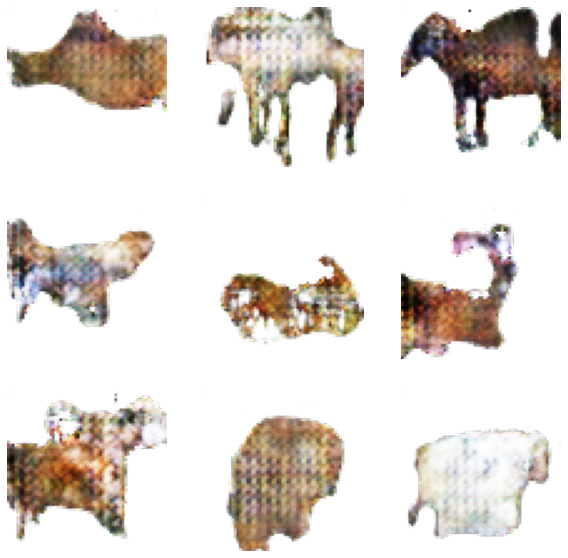

Epoch: 501 Generator loss: 4.6467814445495605 Discriminator loss: 0.048709675669670105
Epoch: 502 Generator loss: 6.095875263214111 Discriminator loss: 0.6161565184593201
Epoch: 503 Generator loss: 1.7121789455413818 Discriminator loss: 0.48800167441368103
Epoch: 504 Generator loss: 6.940484046936035 Discriminator loss: 0.13487346470355988
Epoch: 505 Generator loss: 4.606546401977539 Discriminator loss: 0.035608451813459396
Epoch: 506 Generator loss: 4.3966240882873535 Discriminator loss: 0.11057519912719727
Epoch: 507 Generator loss: 5.638887405395508 Discriminator loss: 0.021239042282104492
Epoch: 508 Generator loss: 1.0966302156448364 Discriminator loss: 0.7687513828277588
Epoch: 509 Generator loss: 3.3060905933380127 Discriminator loss: 0.12866118550300598
Epoch: 510 Generator loss: 4.500494003295898 Discriminator loss: 0.04509706422686577


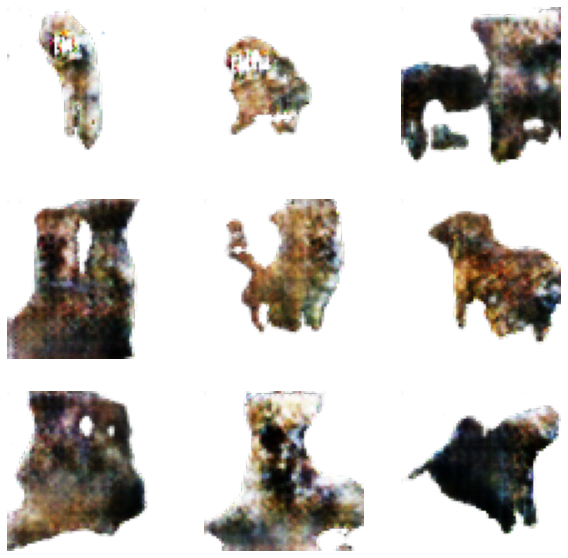

Epoch: 511 Generator loss: 9.49602222442627 Discriminator loss: 0.27272582054138184
Epoch: 512 Generator loss: 6.038524150848389 Discriminator loss: 0.026546599343419075
Epoch: 513 Generator loss: 8.750961303710938 Discriminator loss: 0.01754230260848999
Epoch: 514 Generator loss: 4.995590686798096 Discriminator loss: 0.03041127882897854
Epoch: 515 Generator loss: 4.4944891929626465 Discriminator loss: 0.06727127730846405
Epoch: 516 Generator loss: 4.822786808013916 Discriminator loss: 0.05229102075099945
Epoch: 517 Generator loss: 8.652812004089355 Discriminator loss: 0.14123572409152985
Epoch: 518 Generator loss: 13.463706016540527 Discriminator loss: 1.07433021068573
Epoch: 519 Generator loss: 1.5084047317504883 Discriminator loss: 0.6331157684326172
Epoch: 520 Generator loss: 10.628769874572754 Discriminator loss: 0.39404383301734924


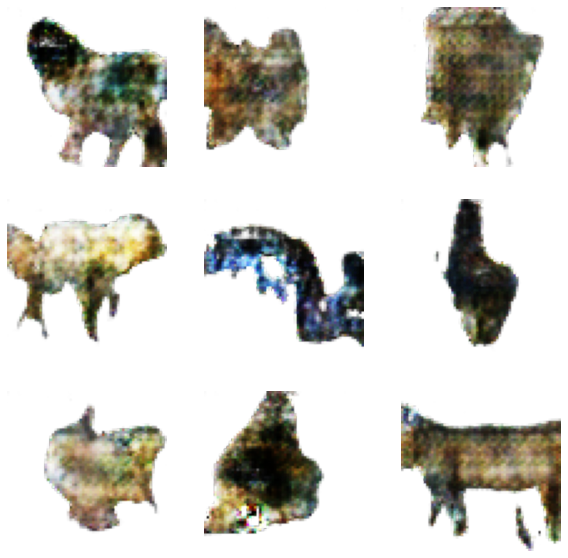

Epoch: 521 Generator loss: 5.777005195617676 Discriminator loss: 0.03524055331945419
Epoch: 522 Generator loss: 5.6382575035095215 Discriminator loss: 0.094321608543396
Epoch: 523 Generator loss: 1.2063891887664795 Discriminator loss: 0.6421487927436829
Epoch: 524 Generator loss: 5.532749176025391 Discriminator loss: 0.05060254782438278
Epoch: 525 Generator loss: 6.892996788024902 Discriminator loss: 0.13871309161186218
Epoch: 526 Generator loss: 3.917395830154419 Discriminator loss: 0.07717189192771912
Epoch: 527 Generator loss: 2.514735460281372 Discriminator loss: 0.23821312189102173
Epoch: 528 Generator loss: 5.816359043121338 Discriminator loss: 0.02777721732854843
Epoch: 529 Generator loss: 6.152322292327881 Discriminator loss: 0.01433614268898964
Epoch: 530 Generator loss: 7.567009449005127 Discriminator loss: 0.2516566514968872


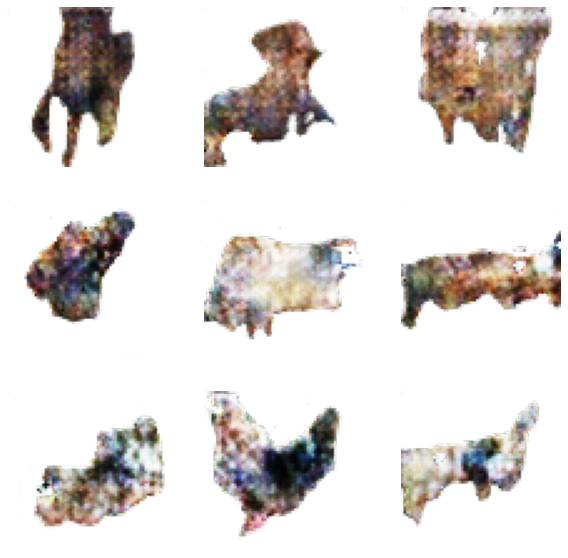

Epoch: 531 Generator loss: 10.201665878295898 Discriminator loss: 0.010190061293542385
Epoch: 532 Generator loss: 8.12891674041748 Discriminator loss: 0.01944694295525551
Epoch: 533 Generator loss: 5.6702094078063965 Discriminator loss: 0.010496075265109539
Epoch: 534 Generator loss: 8.164567947387695 Discriminator loss: 0.03316081687808037
Epoch: 535 Generator loss: 10.132741928100586 Discriminator loss: 0.059512585401535034
Epoch: 536 Generator loss: 3.992459774017334 Discriminator loss: 0.04821786284446716
Epoch: 537 Generator loss: 5.8066020011901855 Discriminator loss: 0.03426382690668106
Epoch: 538 Generator loss: 3.7751336097717285 Discriminator loss: 0.06612224876880646
Epoch: 539 Generator loss: 7.028800010681152 Discriminator loss: 0.010797679424285889
Epoch: 540 Generator loss: 4.124285697937012 Discriminator loss: 0.08961820602416992


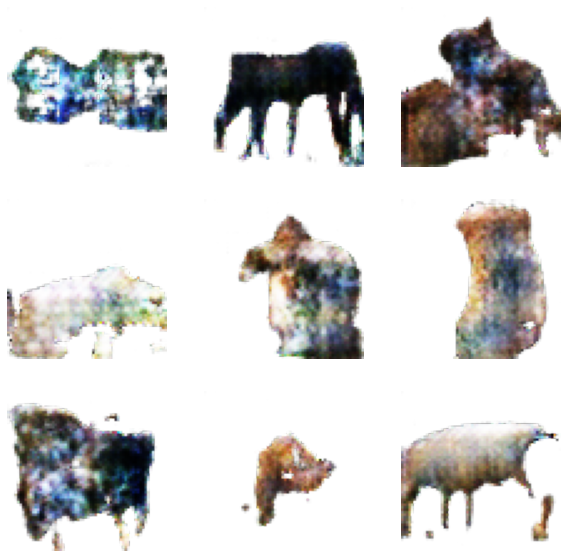

Epoch: 541 Generator loss: 2.4882729053497314 Discriminator loss: 0.24715711176395416
Epoch: 542 Generator loss: 6.344866752624512 Discriminator loss: 0.022357478737831116
Epoch: 543 Generator loss: 6.996828556060791 Discriminator loss: 0.29982128739356995
Epoch: 544 Generator loss: 6.9392547607421875 Discriminator loss: 0.11262637376785278
Epoch: 545 Generator loss: 5.649091720581055 Discriminator loss: 0.27903062105178833
Epoch: 546 Generator loss: 6.890158176422119 Discriminator loss: 0.32879409193992615
Epoch: 547 Generator loss: 5.940747261047363 Discriminator loss: 0.8469655513763428
Epoch: 548 Generator loss: 6.109994411468506 Discriminator loss: 0.7277836799621582
Epoch: 549 Generator loss: 1.631269097328186 Discriminator loss: 0.4600907564163208
Epoch: 550 Generator loss: 7.547212600708008 Discriminator loss: 0.09141743928194046


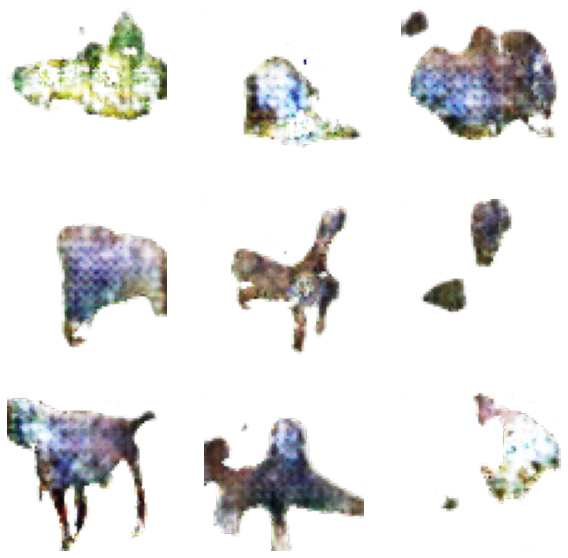

Epoch: 551 Generator loss: 6.8176798820495605 Discriminator loss: 0.1435614675283432
Epoch: 552 Generator loss: 7.534942626953125 Discriminator loss: 0.13077224791049957
Epoch: 553 Generator loss: 8.470333099365234 Discriminator loss: 0.008953418582677841
Epoch: 554 Generator loss: 0.805789589881897 Discriminator loss: 1.4697409868240356
Epoch: 555 Generator loss: 5.84951114654541 Discriminator loss: 0.062253743410110474
Epoch: 556 Generator loss: 3.9596757888793945 Discriminator loss: 0.06189727783203125
Epoch: 557 Generator loss: 4.5523762702941895 Discriminator loss: 0.042456403374671936
Epoch: 558 Generator loss: 4.1478352546691895 Discriminator loss: 0.07189535349607468
Epoch: 559 Generator loss: 5.416638374328613 Discriminator loss: 0.01921479031443596
Epoch: 560 Generator loss: 3.686260461807251 Discriminator loss: 0.07934921979904175


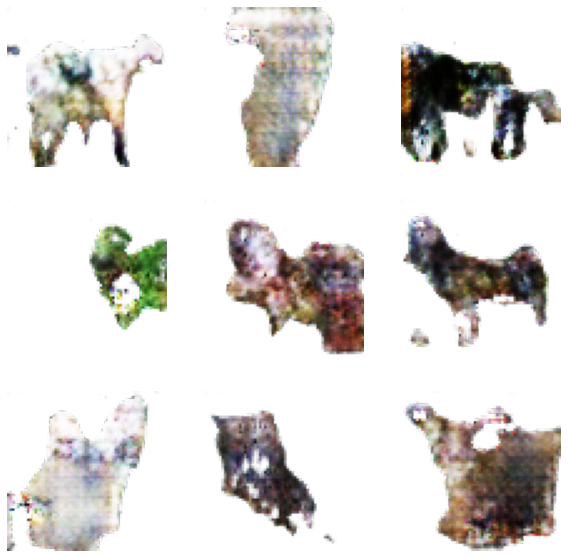

Epoch: 561 Generator loss: 6.92318058013916 Discriminator loss: 0.006228012964129448
Epoch: 562 Generator loss: 5.3293352127075195 Discriminator loss: 0.03419185429811478
Epoch: 563 Generator loss: 4.015826225280762 Discriminator loss: 0.0630011111497879
Epoch: 564 Generator loss: 7.309731483459473 Discriminator loss: 0.008424694649875164
Epoch: 565 Generator loss: 5.176278591156006 Discriminator loss: 0.02985902689397335
Epoch: 566 Generator loss: 4.95671272277832 Discriminator loss: 0.02394942380487919
Epoch: 567 Generator loss: 2.991898536682129 Discriminator loss: 0.13730542361736298
Epoch: 568 Generator loss: 5.22685432434082 Discriminator loss: 0.01628234051167965
Epoch: 569 Generator loss: 4.679304599761963 Discriminator loss: 0.05286305025219917
Epoch: 570 Generator loss: 3.5370211601257324 Discriminator loss: 0.06939110159873962


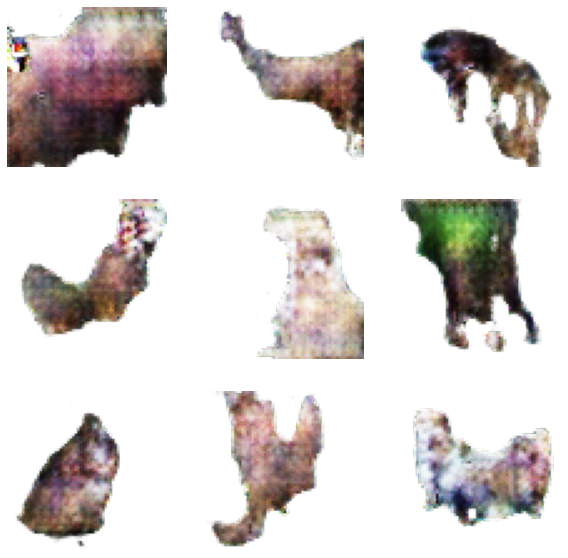

Epoch: 571 Generator loss: 5.581996917724609 Discriminator loss: 0.02137741632759571
Epoch: 572 Generator loss: 5.342729568481445 Discriminator loss: 0.05363056808710098
Epoch: 573 Generator loss: 4.6492180824279785 Discriminator loss: 0.09162396192550659
Epoch: 574 Generator loss: 10.795075416564941 Discriminator loss: 2.500283718109131
Epoch: 575 Generator loss: 4.56055212020874 Discriminator loss: 0.04042752832174301
Epoch: 576 Generator loss: 4.34967565536499 Discriminator loss: 0.04187987744808197
Epoch: 577 Generator loss: 5.850945949554443 Discriminator loss: 0.027439236640930176
Epoch: 578 Generator loss: 7.844376087188721 Discriminator loss: 0.22749736905097961
Epoch: 579 Generator loss: 8.886809349060059 Discriminator loss: 0.08198915421962738
Epoch: 580 Generator loss: 8.10632610321045 Discriminator loss: 0.012559140101075172


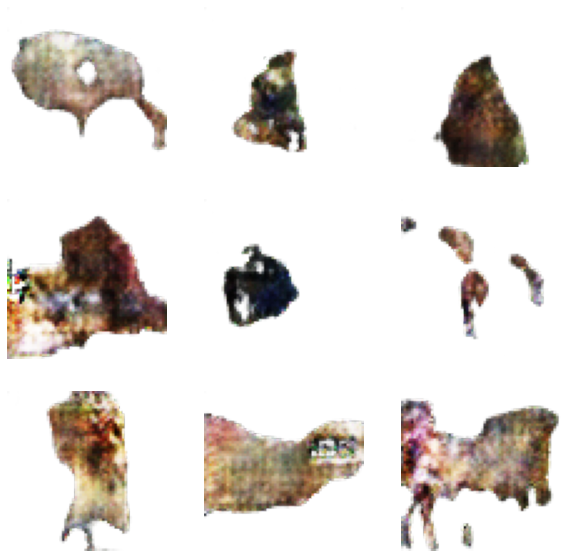

Epoch: 581 Generator loss: 1.0160534381866455 Discriminator loss: 0.9392243027687073
Epoch: 582 Generator loss: 4.602980136871338 Discriminator loss: 0.10365983098745346
Epoch: 583 Generator loss: 4.024750232696533 Discriminator loss: 0.08960779011249542
Epoch: 584 Generator loss: 7.468712329864502 Discriminator loss: 0.1506473869085312
Epoch: 585 Generator loss: 4.312317371368408 Discriminator loss: 0.04970323666930199
Epoch: 586 Generator loss: 6.9888014793396 Discriminator loss: 0.019291359931230545
Epoch: 587 Generator loss: 10.111390113830566 Discriminator loss: 0.3135524392127991
Epoch: 588 Generator loss: 7.98277473449707 Discriminator loss: 0.0355798713862896
Epoch: 589 Generator loss: 7.294498920440674 Discriminator loss: 0.04727688431739807
Epoch: 590 Generator loss: 0.8242675065994263 Discriminator loss: 1.0228564739227295


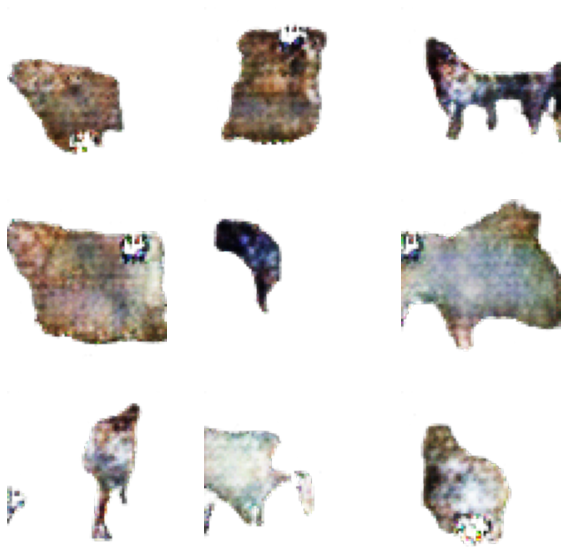

Epoch: 591 Generator loss: 7.49948263168335 Discriminator loss: 0.12181006371974945
Epoch: 592 Generator loss: 8.946354866027832 Discriminator loss: 0.1800956279039383
Epoch: 593 Generator loss: 6.739902496337891 Discriminator loss: 0.03139309957623482
Epoch: 594 Generator loss: 7.046696662902832 Discriminator loss: 0.026310665532946587
Epoch: 595 Generator loss: 7.997052192687988 Discriminator loss: 0.10775841027498245
Epoch: 596 Generator loss: 5.487017631530762 Discriminator loss: 0.0725485160946846
Epoch: 597 Generator loss: 3.7789273262023926 Discriminator loss: 0.07108080387115479
Epoch: 598 Generator loss: 3.1553661823272705 Discriminator loss: 0.122053362429142
Epoch: 599 Generator loss: 5.639892578125 Discriminator loss: 0.23794762790203094
Epoch: 600 Generator loss: 8.059334754943848 Discriminator loss: 0.02607809379696846


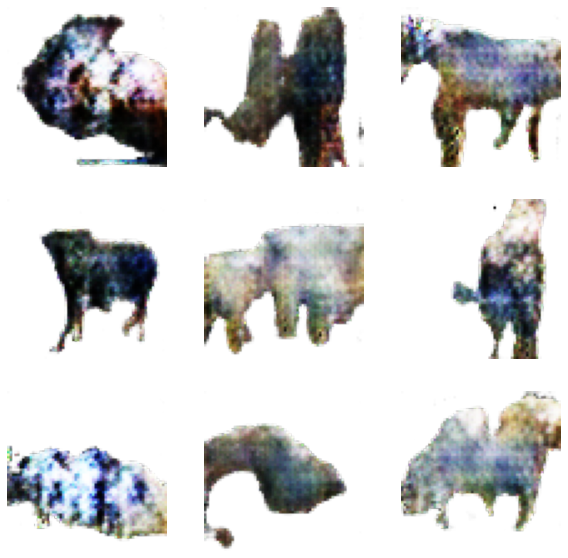

Epoch: 601 Generator loss: 5.679068565368652 Discriminator loss: 0.013371257111430168
Epoch: 602 Generator loss: 8.141814231872559 Discriminator loss: 0.013455918058753014
Epoch: 603 Generator loss: 5.688583850860596 Discriminator loss: 0.04408847913146019
Epoch: 604 Generator loss: 9.227489471435547 Discriminator loss: 0.11000165343284607
Epoch: 605 Generator loss: 8.67884635925293 Discriminator loss: 0.0700443834066391
Epoch: 606 Generator loss: 2.2873740196228027 Discriminator loss: 0.27314528822898865
Epoch: 607 Generator loss: 5.211413383483887 Discriminator loss: 0.05726121366024017
Epoch: 608 Generator loss: 7.116483688354492 Discriminator loss: 0.00654956279322505
Epoch: 609 Generator loss: 1.4037327766418457 Discriminator loss: 0.5927379727363586
Epoch: 610 Generator loss: 6.021122932434082 Discriminator loss: 0.10829607397317886


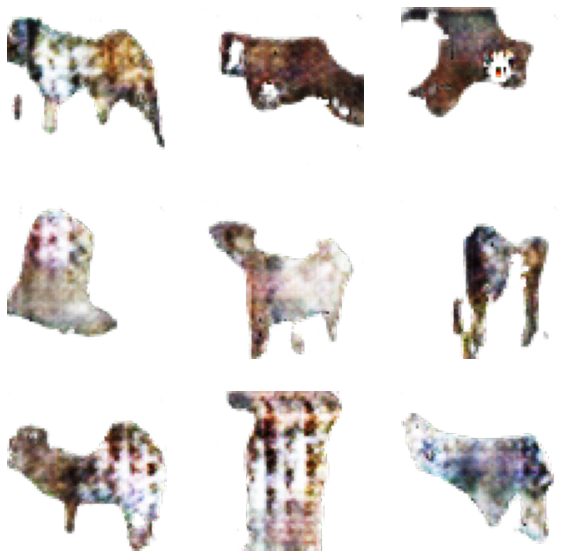

Epoch: 611 Generator loss: 6.595313549041748 Discriminator loss: 0.03907998278737068
Epoch: 612 Generator loss: 1.8448939323425293 Discriminator loss: 0.4076022803783417
Epoch: 613 Generator loss: 8.744873046875 Discriminator loss: 0.054536785930395126
Epoch: 614 Generator loss: 8.682888984680176 Discriminator loss: 0.2540675401687622
Epoch: 615 Generator loss: 7.382410049438477 Discriminator loss: 0.18842627108097076
Epoch: 616 Generator loss: 7.5367231369018555 Discriminator loss: 0.018656859174370766
Epoch: 617 Generator loss: 5.593272686004639 Discriminator loss: 0.01164474617689848
Epoch: 618 Generator loss: 7.658131122589111 Discriminator loss: 0.05322534590959549
Epoch: 619 Generator loss: 8.791912078857422 Discriminator loss: 0.34937527775764465
Epoch: 620 Generator loss: 1.7778860330581665 Discriminator loss: 0.4208771288394928


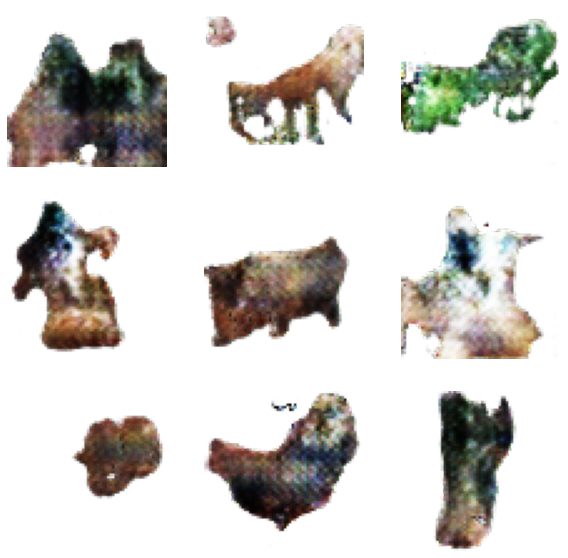

Epoch: 621 Generator loss: 8.001276016235352 Discriminator loss: 0.04374008625745773
Epoch: 622 Generator loss: 6.116880893707275 Discriminator loss: 0.048098403960466385
Epoch: 623 Generator loss: 4.137645721435547 Discriminator loss: 0.03510909900069237
Epoch: 624 Generator loss: 3.9690353870391846 Discriminator loss: 0.06520214676856995
Epoch: 625 Generator loss: 6.821661472320557 Discriminator loss: 0.190223827958107
Epoch: 626 Generator loss: 10.824756622314453 Discriminator loss: 0.11188441514968872
Epoch: 627 Generator loss: 2.9276766777038574 Discriminator loss: 0.21762070059776306
Epoch: 628 Generator loss: 4.087307453155518 Discriminator loss: 0.07436653226613998
Epoch: 629 Generator loss: 5.730198860168457 Discriminator loss: 0.013009090907871723
Epoch: 630 Generator loss: 7.941732406616211 Discriminator loss: 0.0335419736802578


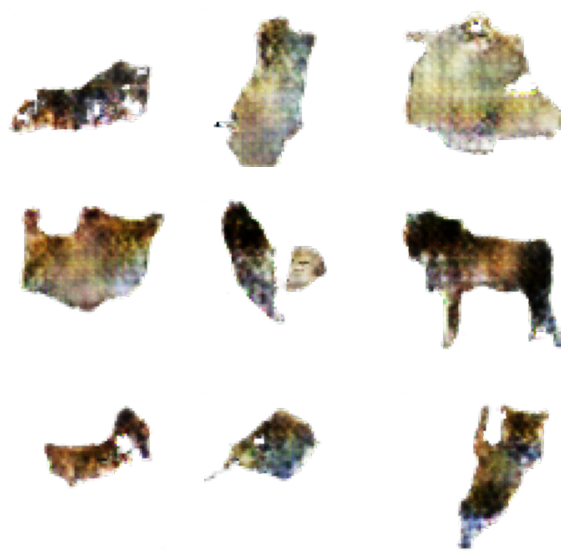

Epoch: 631 Generator loss: 10.909256935119629 Discriminator loss: 0.07966330647468567
Epoch: 632 Generator loss: 4.32765531539917 Discriminator loss: 0.05127730220556259
Epoch: 633 Generator loss: 6.126529693603516 Discriminator loss: 0.01175924576818943
Epoch: 634 Generator loss: 4.762172698974609 Discriminator loss: 0.05613928660750389
Epoch: 635 Generator loss: 6.745657920837402 Discriminator loss: 0.013047188520431519
Epoch: 636 Generator loss: 5.64974308013916 Discriminator loss: 0.01791323348879814
Epoch: 637 Generator loss: 3.0813305377960205 Discriminator loss: 0.12239023298025131
Epoch: 638 Generator loss: 5.373788356781006 Discriminator loss: 0.014349618926644325
Epoch: 639 Generator loss: 5.722351551055908 Discriminator loss: 0.01133746188133955
Epoch: 640 Generator loss: 4.687719821929932 Discriminator loss: 0.04184446856379509


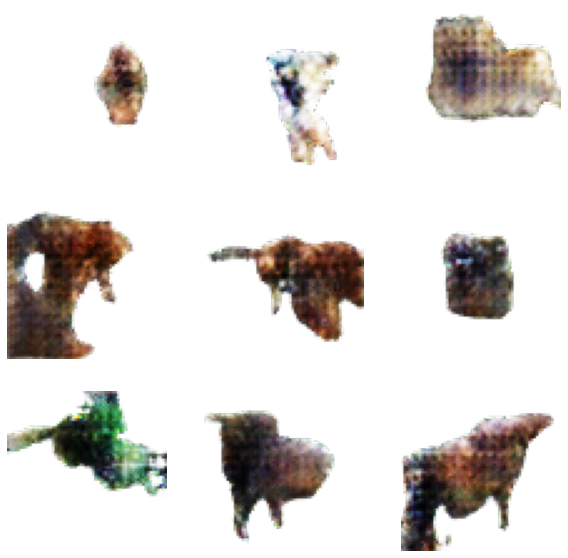

Epoch: 641 Generator loss: 5.050838470458984 Discriminator loss: 0.026180529966950417
Epoch: 642 Generator loss: 5.9647536277771 Discriminator loss: 0.01133416686207056
Epoch: 643 Generator loss: 6.605778694152832 Discriminator loss: 0.10289765894412994
Epoch: 644 Generator loss: 6.07699728012085 Discriminator loss: 0.013902490958571434
Epoch: 645 Generator loss: 8.731623649597168 Discriminator loss: 0.029118189588189125
Epoch: 646 Generator loss: 8.145374298095703 Discriminator loss: 0.08460119366645813
Epoch: 647 Generator loss: 3.9019417762756348 Discriminator loss: 0.10077743977308273
Epoch: 648 Generator loss: 3.179319381713867 Discriminator loss: 0.11428065598011017
Epoch: 649 Generator loss: 5.618015289306641 Discriminator loss: 0.012977227568626404
Epoch: 650 Generator loss: 5.483041286468506 Discriminator loss: 0.03409161418676376


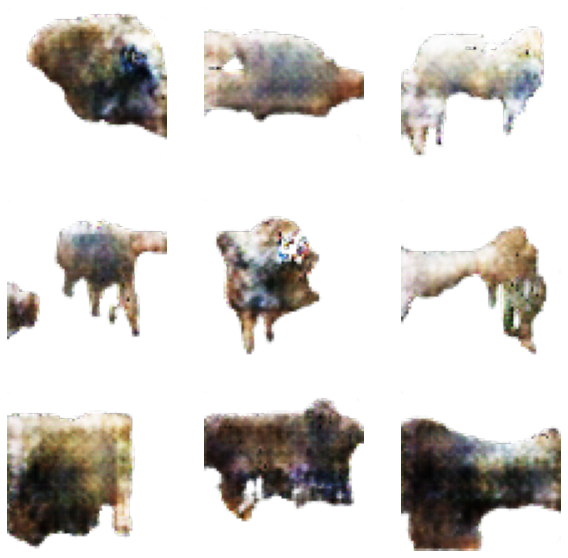

Epoch: 651 Generator loss: 5.925732612609863 Discriminator loss: 0.013693195767700672
Epoch: 652 Generator loss: 9.979089736938477 Discriminator loss: 0.4622882008552551
Epoch: 653 Generator loss: 5.039823532104492 Discriminator loss: 0.019389692693948746
Epoch: 654 Generator loss: 3.2338051795959473 Discriminator loss: 0.10905326902866364
Epoch: 655 Generator loss: 10.573060035705566 Discriminator loss: 0.19011150300502777
Epoch: 656 Generator loss: 3.582775831222534 Discriminator loss: 0.12726837396621704
Epoch: 657 Generator loss: 5.92062520980835 Discriminator loss: 0.012957296334207058
Epoch: 658 Generator loss: 8.59679126739502 Discriminator loss: 0.02407517284154892
Epoch: 659 Generator loss: 7.439847946166992 Discriminator loss: 0.31540775299072266
Epoch: 660 Generator loss: 6.778944492340088 Discriminator loss: 0.04555206745862961


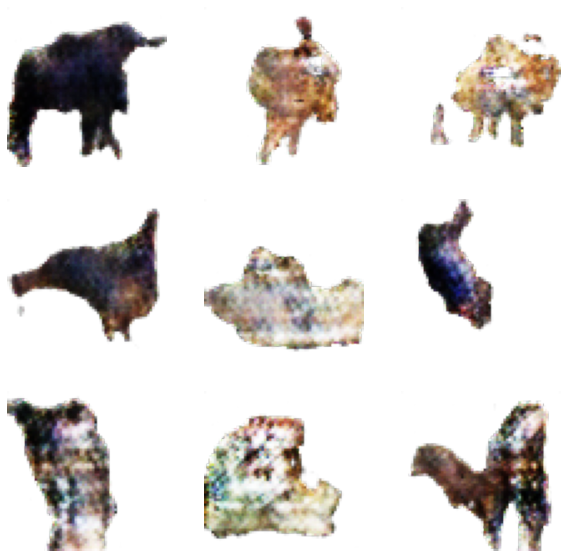

Epoch: 661 Generator loss: 8.735191345214844 Discriminator loss: 0.011343926191329956
Epoch: 662 Generator loss: 7.805196762084961 Discriminator loss: 0.0038164276629686356
Epoch: 663 Generator loss: 8.517138481140137 Discriminator loss: 0.014394748024642467
Epoch: 664 Generator loss: 5.387747764587402 Discriminator loss: 0.024287454783916473
Epoch: 665 Generator loss: 6.960639476776123 Discriminator loss: 0.006132925860583782
Epoch: 666 Generator loss: 5.081907272338867 Discriminator loss: 0.028024209663271904
Epoch: 667 Generator loss: 8.47940444946289 Discriminator loss: 0.006864172872155905
Epoch: 668 Generator loss: 7.051875114440918 Discriminator loss: 0.014062916859984398
Epoch: 669 Generator loss: 4.590692520141602 Discriminator loss: 0.031134167686104774
Epoch: 670 Generator loss: 5.811227798461914 Discriminator loss: 0.02330419421195984


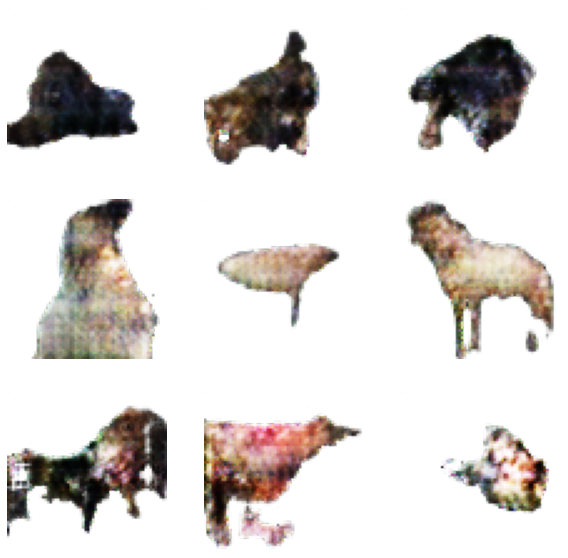

Epoch: 671 Generator loss: 7.151775360107422 Discriminator loss: 0.011540504172444344
Epoch: 672 Generator loss: 3.9312491416931152 Discriminator loss: 0.05839771032333374
Epoch: 673 Generator loss: 5.856886386871338 Discriminator loss: 0.007392364088445902
Epoch: 674 Generator loss: 2.2080142498016357 Discriminator loss: 0.3259042799472809
Epoch: 675 Generator loss: 6.2564592361450195 Discriminator loss: 0.04363138973712921
Epoch: 676 Generator loss: 0.38574549555778503 Discriminator loss: 2.0172314643859863
Epoch: 677 Generator loss: 0.4240270256996155 Discriminator loss: 1.851574420928955
Epoch: 678 Generator loss: 9.393939018249512 Discriminator loss: 0.15213288366794586
Epoch: 679 Generator loss: 5.571629524230957 Discriminator loss: 0.01840076968073845
Epoch: 680 Generator loss: 7.686111927032471 Discriminator loss: 0.05354245379567146


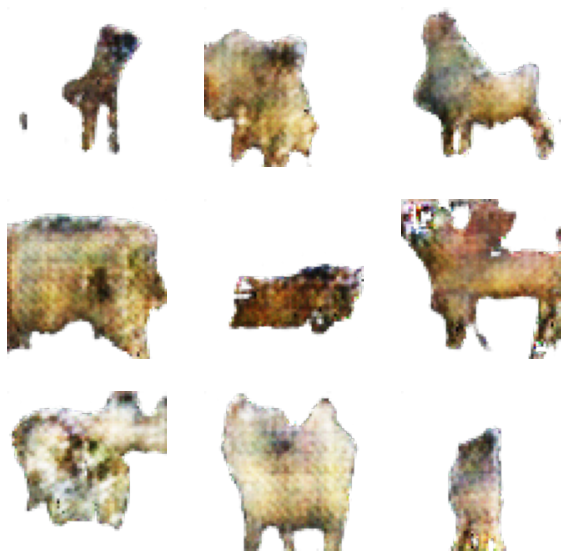

Epoch: 681 Generator loss: 9.447916030883789 Discriminator loss: 0.3634781241416931
Epoch: 682 Generator loss: 3.5199368000030518 Discriminator loss: 0.07328136265277863
Epoch: 683 Generator loss: 6.019197463989258 Discriminator loss: 0.010828747414052486
Epoch: 684 Generator loss: 7.70247745513916 Discriminator loss: 0.01446407102048397
Epoch: 685 Generator loss: 6.7303786277771 Discriminator loss: 0.03424368053674698
Epoch: 686 Generator loss: 9.81554889678955 Discriminator loss: 0.0036265882663428783
Epoch: 687 Generator loss: 6.078162670135498 Discriminator loss: 0.01110024843364954
Epoch: 688 Generator loss: 9.478520393371582 Discriminator loss: 0.027604207396507263
Epoch: 689 Generator loss: 13.37612533569336 Discriminator loss: 1.624649167060852
Epoch: 690 Generator loss: 8.381488800048828 Discriminator loss: 0.010661286301910877


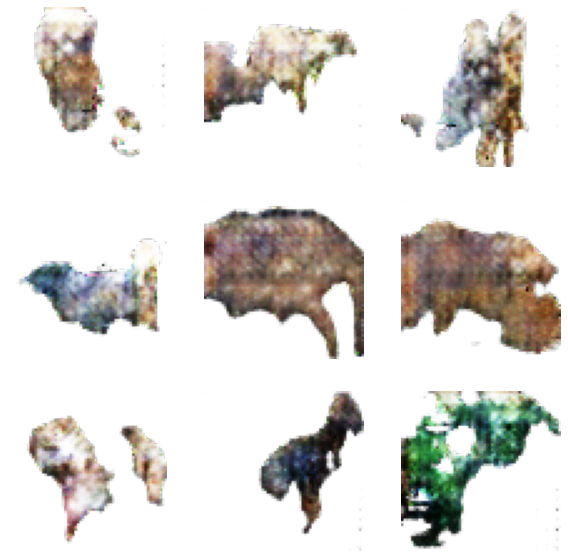

Epoch: 691 Generator loss: 6.239826202392578 Discriminator loss: 0.011140365153551102
Epoch: 692 Generator loss: 7.046748161315918 Discriminator loss: 0.008258020505309105
Epoch: 693 Generator loss: 5.986905574798584 Discriminator loss: 0.0525856539607048
Epoch: 694 Generator loss: 5.048418998718262 Discriminator loss: 0.1885610967874527
Epoch: 695 Generator loss: 6.944392681121826 Discriminator loss: 0.004135912284255028
Epoch: 696 Generator loss: 8.451813697814941 Discriminator loss: 0.01571446843445301
Epoch: 697 Generator loss: 6.151706695556641 Discriminator loss: 0.009669920429587364
Epoch: 698 Generator loss: 2.9786293506622314 Discriminator loss: 0.17047198116779327
Epoch: 699 Generator loss: 2.583871841430664 Discriminator loss: 0.18815761804580688
Epoch: 700 Generator loss: 6.294416904449463 Discriminator loss: 0.008387771435081959


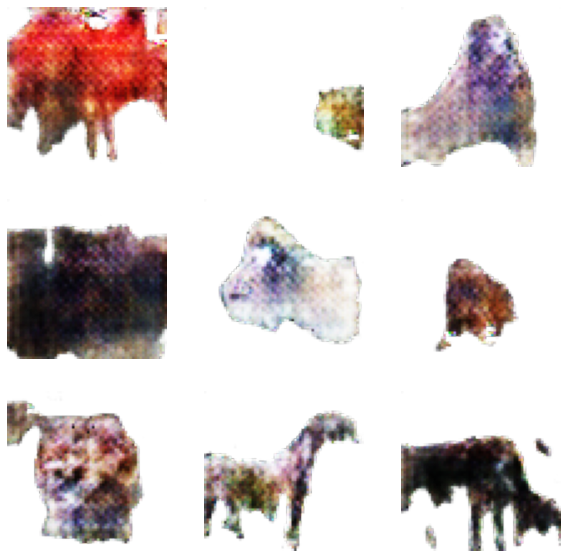

Epoch: 701 Generator loss: 6.753528594970703 Discriminator loss: 0.009500982239842415
Epoch: 702 Generator loss: 6.031818389892578 Discriminator loss: 0.03627295419573784
Epoch: 703 Generator loss: 6.2176194190979 Discriminator loss: 0.00925288163125515
Epoch: 704 Generator loss: 6.9982805252075195 Discriminator loss: 0.012001313269138336
Epoch: 705 Generator loss: 4.0249834060668945 Discriminator loss: 0.06039402633905411
Epoch: 706 Generator loss: 5.124917507171631 Discriminator loss: 0.021065322682261467
Epoch: 707 Generator loss: 3.504586696624756 Discriminator loss: 0.13743910193443298
Epoch: 708 Generator loss: 1.8231922388076782 Discriminator loss: 0.45958706736564636
Epoch: 709 Generator loss: 5.8135247230529785 Discriminator loss: 0.043637096881866455
Epoch: 710 Generator loss: 8.873514175415039 Discriminator loss: 0.045208171010017395


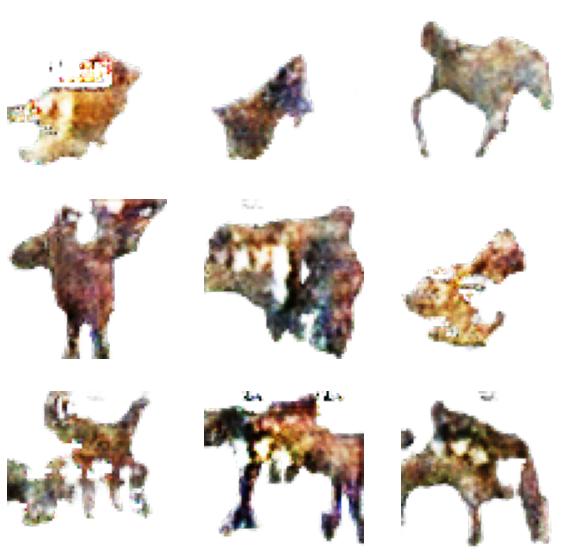

Epoch: 711 Generator loss: 8.45644474029541 Discriminator loss: 0.06581124663352966
Epoch: 712 Generator loss: 8.410374641418457 Discriminator loss: 0.04996754601597786
Epoch: 713 Generator loss: 8.771262168884277 Discriminator loss: 0.1721365600824356
Epoch: 714 Generator loss: 4.423904895782471 Discriminator loss: 0.04203369468450546
Epoch: 715 Generator loss: 9.487873077392578 Discriminator loss: 0.17128026485443115
Epoch: 716 Generator loss: 2.6782302856445312 Discriminator loss: 0.22244834899902344
Epoch: 717 Generator loss: 6.290731430053711 Discriminator loss: 0.05204274505376816
Epoch: 718 Generator loss: 6.290668964385986 Discriminator loss: 0.027627168223261833
Epoch: 719 Generator loss: 8.152532577514648 Discriminator loss: 0.1126699149608612
Epoch: 720 Generator loss: 9.61776065826416 Discriminator loss: 0.21558500826358795


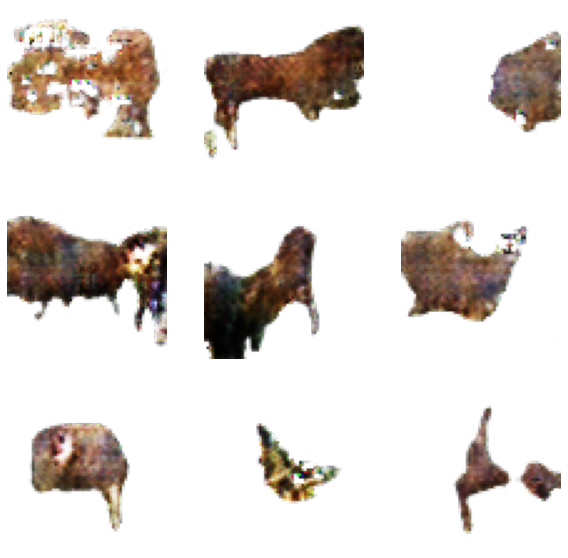

Epoch: 721 Generator loss: 6.709385871887207 Discriminator loss: 0.01852582022547722
Epoch: 722 Generator loss: 7.0727643966674805 Discriminator loss: 0.010240483097732067
Epoch: 723 Generator loss: 1.849890112876892 Discriminator loss: 0.3706716299057007
Epoch: 724 Generator loss: 6.249588489532471 Discriminator loss: 0.011076647788286209
Epoch: 725 Generator loss: 4.680474281311035 Discriminator loss: 0.030045440420508385
Epoch: 726 Generator loss: 3.960928440093994 Discriminator loss: 0.05652300640940666
Epoch: 727 Generator loss: 8.585772514343262 Discriminator loss: 0.01274860743433237
Epoch: 728 Generator loss: 6.869129180908203 Discriminator loss: 0.006432178430259228
Epoch: 729 Generator loss: 3.337141752243042 Discriminator loss: 0.1251431703567505
Epoch: 730 Generator loss: 5.3459014892578125 Discriminator loss: 0.05278373509645462


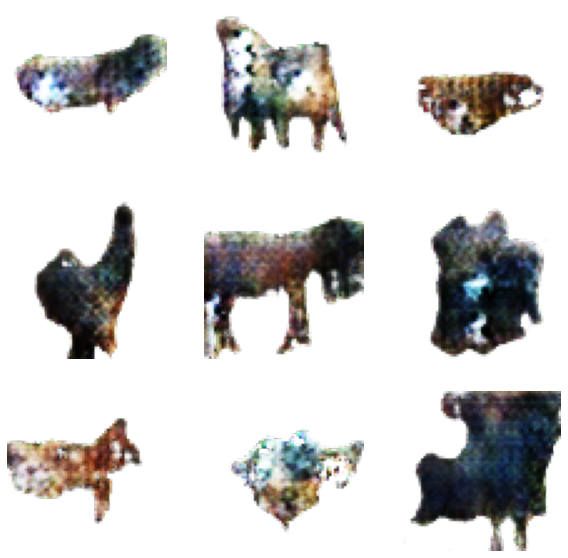

Epoch: 731 Generator loss: 8.679450035095215 Discriminator loss: 0.0663980171084404
Epoch: 732 Generator loss: 8.981664657592773 Discriminator loss: 0.052094392478466034
Epoch: 733 Generator loss: 4.431518077850342 Discriminator loss: 0.03760112449526787
Epoch: 734 Generator loss: 12.286665916442871 Discriminator loss: 0.1495930403470993
Epoch: 735 Generator loss: 2.97007417678833 Discriminator loss: 0.17954209446907043
Epoch: 736 Generator loss: 7.6533050537109375 Discriminator loss: 0.046063460409641266
Epoch: 737 Generator loss: 9.895336151123047 Discriminator loss: 0.395641565322876
Epoch: 738 Generator loss: 4.088667869567871 Discriminator loss: 0.0538649708032608
Epoch: 739 Generator loss: 6.470414638519287 Discriminator loss: 0.026465214788913727
Epoch: 740 Generator loss: 0.34348928928375244 Discriminator loss: 1.884765625


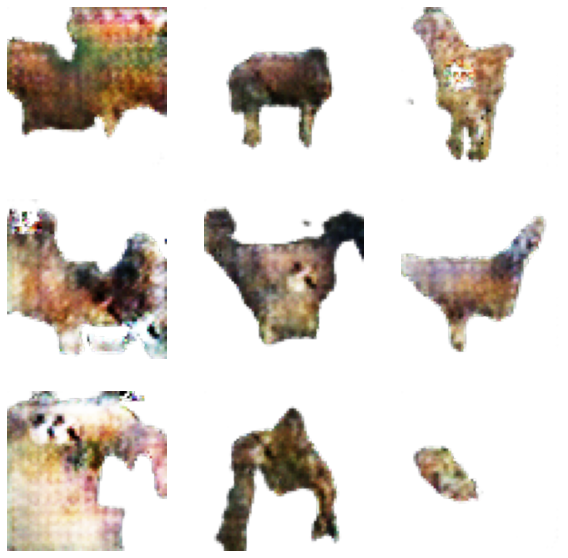

Epoch: 741 Generator loss: 9.149796485900879 Discriminator loss: 0.05764901265501976
Epoch: 742 Generator loss: 7.476466178894043 Discriminator loss: 0.048416245728731155
Epoch: 743 Generator loss: 8.975696563720703 Discriminator loss: 0.02852594293653965
Epoch: 744 Generator loss: 8.806336402893066 Discriminator loss: 0.0546930767595768
Epoch: 745 Generator loss: 7.375448226928711 Discriminator loss: 0.008905638009309769
Epoch: 746 Generator loss: 8.460420608520508 Discriminator loss: 0.1838354617357254
Epoch: 747 Generator loss: 8.818428993225098 Discriminator loss: 0.13769173622131348
Epoch: 748 Generator loss: 8.657230377197266 Discriminator loss: 0.005006961990147829
Epoch: 749 Generator loss: 3.583686590194702 Discriminator loss: 0.10699562728404999
Epoch: 750 Generator loss: 6.161350250244141 Discriminator loss: 0.13267573714256287


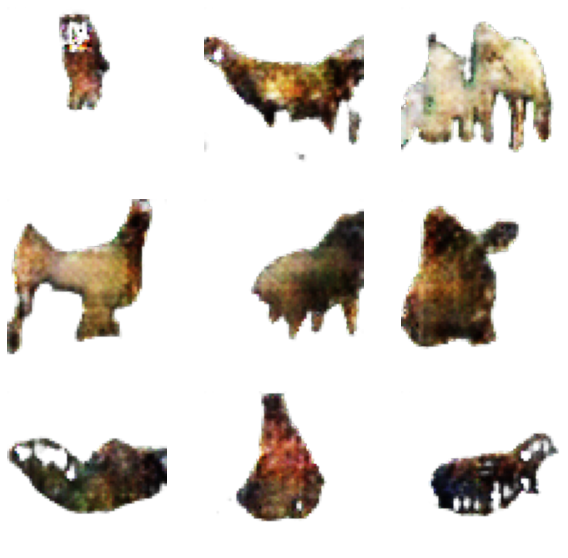

Epoch: 751 Generator loss: 5.530754566192627 Discriminator loss: 0.024996988475322723
Epoch: 752 Generator loss: 4.463393688201904 Discriminator loss: 0.03025669977068901
Epoch: 753 Generator loss: 3.3463945388793945 Discriminator loss: 0.12677451968193054
Epoch: 754 Generator loss: 5.463686943054199 Discriminator loss: 0.022094838321208954
Epoch: 755 Generator loss: 5.739737033843994 Discriminator loss: 0.015022763051092625
Epoch: 756 Generator loss: 7.800140380859375 Discriminator loss: 0.04077073931694031
Epoch: 757 Generator loss: 8.244270324707031 Discriminator loss: 0.025462474673986435
Epoch: 758 Generator loss: 3.6297860145568848 Discriminator loss: 0.0833292230963707
Epoch: 759 Generator loss: 6.813670635223389 Discriminator loss: 0.03896292671561241
Epoch: 760 Generator loss: 4.740870475769043 Discriminator loss: 0.03175713121891022


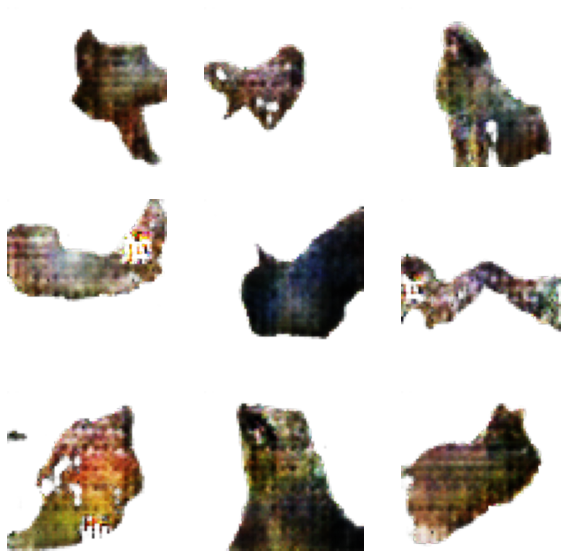

Epoch: 761 Generator loss: 5.395598888397217 Discriminator loss: 0.016721583902835846
Epoch: 762 Generator loss: 6.539429187774658 Discriminator loss: 0.0349564254283905
Epoch: 763 Generator loss: 6.849795341491699 Discriminator loss: 0.02976210229098797
Epoch: 764 Generator loss: 0.816821277141571 Discriminator loss: 1.1601967811584473
Epoch: 765 Generator loss: 6.459567070007324 Discriminator loss: 0.04596332833170891
Epoch: 766 Generator loss: 8.714049339294434 Discriminator loss: 0.06004946678876877
Epoch: 767 Generator loss: 7.453667163848877 Discriminator loss: 0.0031209890730679035
Epoch: 768 Generator loss: 10.997320175170898 Discriminator loss: 0.5101261138916016
Epoch: 769 Generator loss: 5.497133731842041 Discriminator loss: 0.014651541598141193
Epoch: 770 Generator loss: 5.398406505584717 Discriminator loss: 0.029914099723100662


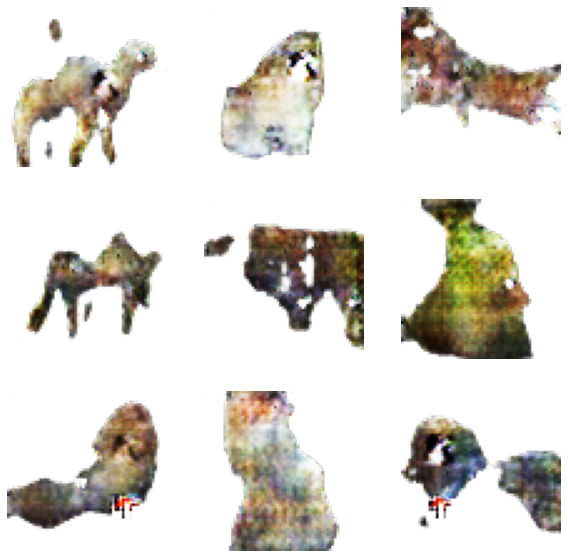

Epoch: 771 Generator loss: 5.305801868438721 Discriminator loss: 0.024187274277210236
Epoch: 772 Generator loss: 4.859933376312256 Discriminator loss: 0.037226803600788116
Epoch: 773 Generator loss: 4.636115550994873 Discriminator loss: 0.02913643792271614
Epoch: 774 Generator loss: 4.758152961730957 Discriminator loss: 0.04493356868624687
Epoch: 775 Generator loss: 5.512882709503174 Discriminator loss: 0.01740064099431038
Epoch: 776 Generator loss: 6.562070369720459 Discriminator loss: 0.061304714530706406
Epoch: 777 Generator loss: 1.6428070068359375 Discriminator loss: 0.5138241052627563
Epoch: 778 Generator loss: 2.0461764335632324 Discriminator loss: 0.3216005265712738
Epoch: 779 Generator loss: 6.279737949371338 Discriminator loss: 0.044938623905181885
Epoch: 780 Generator loss: 7.012167453765869 Discriminator loss: 0.008103478699922562


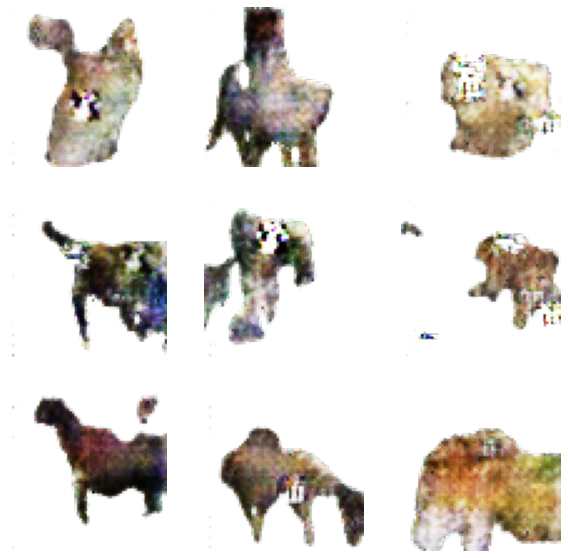

Epoch: 781 Generator loss: 5.100698947906494 Discriminator loss: 0.019012484699487686
Epoch: 782 Generator loss: 7.221844673156738 Discriminator loss: 0.00796821154654026
Epoch: 783 Generator loss: 9.246247291564941 Discriminator loss: 0.018596777692437172
Epoch: 784 Generator loss: 7.311830043792725 Discriminator loss: 0.89548659324646
Epoch: 785 Generator loss: 6.49190616607666 Discriminator loss: 0.02786550298333168
Epoch: 786 Generator loss: 8.058789253234863 Discriminator loss: 0.1325533092021942
Epoch: 787 Generator loss: 4.580816268920898 Discriminator loss: 0.05993420630693436
Epoch: 788 Generator loss: 5.865422248840332 Discriminator loss: 0.03918688744306564
Epoch: 789 Generator loss: 4.166578769683838 Discriminator loss: 0.08561525493860245
Epoch: 790 Generator loss: 7.349565029144287 Discriminator loss: 0.0043422020971775055


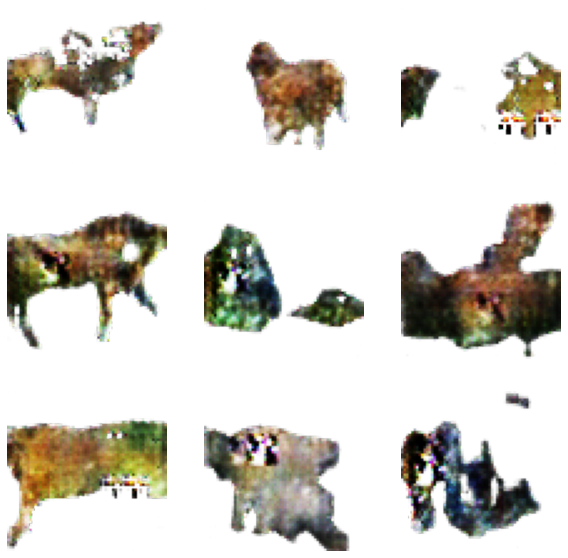

Epoch: 791 Generator loss: 6.427097797393799 Discriminator loss: 0.009169197641313076
Epoch: 792 Generator loss: 5.7205328941345215 Discriminator loss: 0.013057155534625053
Epoch: 793 Generator loss: 7.229577541351318 Discriminator loss: 0.024242237210273743
Epoch: 794 Generator loss: 4.2751359939575195 Discriminator loss: 0.11406406760215759
Epoch: 795 Generator loss: 2.4312562942504883 Discriminator loss: 0.2493244856595993
Epoch: 796 Generator loss: 8.315430641174316 Discriminator loss: 0.006332544609904289
Epoch: 797 Generator loss: 5.900202751159668 Discriminator loss: 0.011566508561372757
Epoch: 798 Generator loss: 5.077660083770752 Discriminator loss: 0.021934103220701218
Epoch: 799 Generator loss: 3.892061233520508 Discriminator loss: 0.05854502692818642
Epoch: 800 Generator loss: 10.371102333068848 Discriminator loss: 0.06962565332651138


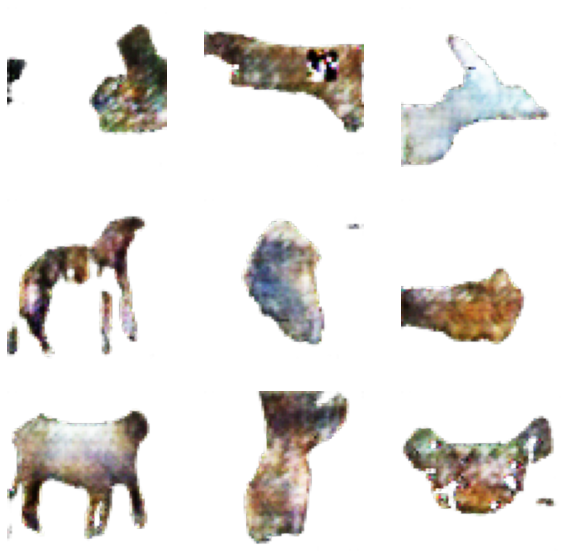

Epoch: 801 Generator loss: 7.25373649597168 Discriminator loss: 0.05105812847614288
Epoch: 802 Generator loss: 7.071925640106201 Discriminator loss: 0.04190756380558014
Epoch: 803 Generator loss: 1.410919189453125 Discriminator loss: 0.5439596772193909
Epoch: 804 Generator loss: 10.35912799835205 Discriminator loss: 0.33416178822517395
Epoch: 805 Generator loss: 7.1479291915893555 Discriminator loss: 0.10304802656173706
Epoch: 806 Generator loss: 5.393885612487793 Discriminator loss: 0.017524976283311844
Epoch: 807 Generator loss: 16.718502044677734 Discriminator loss: 3.0777177810668945
Epoch: 808 Generator loss: 3.1464052200317383 Discriminator loss: 0.10346370190382004
Epoch: 809 Generator loss: 2.9877068996429443 Discriminator loss: 0.16194245219230652
Epoch: 810 Generator loss: 4.134721755981445 Discriminator loss: 0.08504687249660492


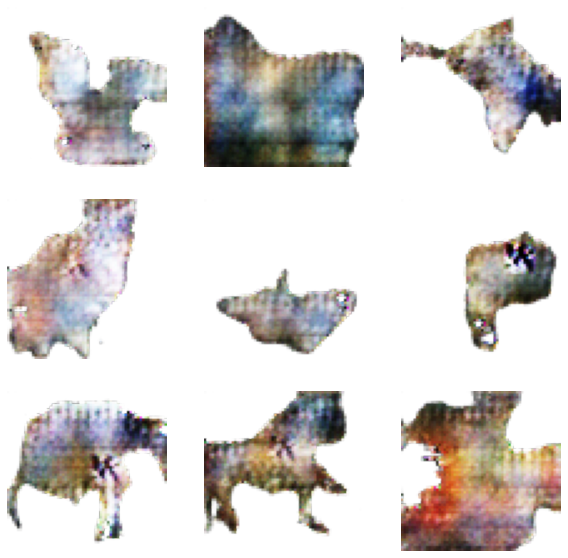

Epoch: 811 Generator loss: 4.818679332733154 Discriminator loss: 0.05058157816529274
Epoch: 812 Generator loss: 11.088409423828125 Discriminator loss: 0.054341401904821396
Epoch: 813 Generator loss: 6.8452229499816895 Discriminator loss: 0.05959144979715347
Epoch: 814 Generator loss: 3.8785245418548584 Discriminator loss: 0.07218729704618454
Epoch: 815 Generator loss: 4.529295921325684 Discriminator loss: 0.058512963354587555
Epoch: 816 Generator loss: 7.543155670166016 Discriminator loss: 0.009480076842010021
Epoch: 817 Generator loss: 11.281322479248047 Discriminator loss: 0.6693800687789917
Epoch: 818 Generator loss: 7.4368896484375 Discriminator loss: 0.05144396424293518
Epoch: 819 Generator loss: 8.044166564941406 Discriminator loss: 0.024875955656170845
Epoch: 820 Generator loss: 10.992232322692871 Discriminator loss: 0.02611568383872509


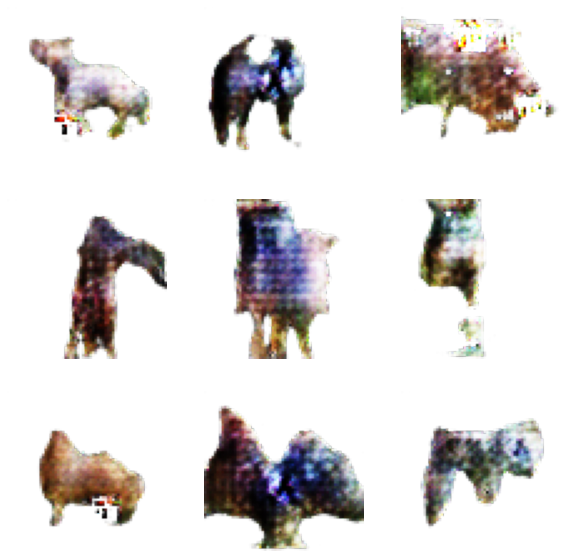

Epoch: 821 Generator loss: 8.7825927734375 Discriminator loss: 1.2817326784133911
Epoch: 822 Generator loss: 3.7790474891662598 Discriminator loss: 0.12455706298351288
Epoch: 823 Generator loss: 5.572434902191162 Discriminator loss: 0.01366130355745554
Epoch: 824 Generator loss: 7.5344367027282715 Discriminator loss: 0.0060360608622431755
Epoch: 825 Generator loss: 6.637689590454102 Discriminator loss: 0.04094487428665161
Epoch: 826 Generator loss: 5.040393829345703 Discriminator loss: 0.1839723289012909
Epoch: 827 Generator loss: 6.899205207824707 Discriminator loss: 0.02047453261911869
Epoch: 828 Generator loss: 5.412237167358398 Discriminator loss: 0.03372105211019516
Epoch: 829 Generator loss: 4.965658664703369 Discriminator loss: 0.08321402966976166
Epoch: 830 Generator loss: 6.798233509063721 Discriminator loss: 0.030276693403720856


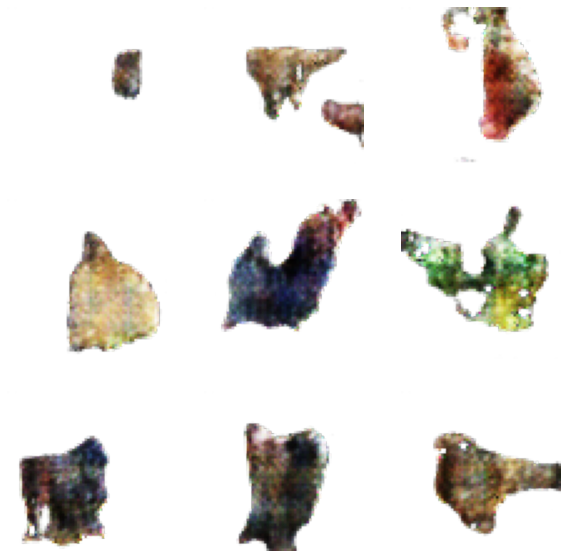

Epoch: 831 Generator loss: 8.940535545349121 Discriminator loss: 0.152792289853096
Epoch: 832 Generator loss: 8.005372047424316 Discriminator loss: 0.050682466477155685
Epoch: 833 Generator loss: 7.376196384429932 Discriminator loss: 0.09949828684329987
Epoch: 834 Generator loss: 5.312547206878662 Discriminator loss: 0.044290345162153244
Epoch: 835 Generator loss: 9.990898132324219 Discriminator loss: 0.009802565909922123
Epoch: 836 Generator loss: 6.245458602905273 Discriminator loss: 0.0873926430940628
Epoch: 837 Generator loss: 5.504701614379883 Discriminator loss: 0.020856354385614395
Epoch: 838 Generator loss: 12.405512809753418 Discriminator loss: 0.48183155059814453
Epoch: 839 Generator loss: 4.8229241371154785 Discriminator loss: 0.06570980697870255
Epoch: 840 Generator loss: 3.3267955780029297 Discriminator loss: 0.12503674626350403


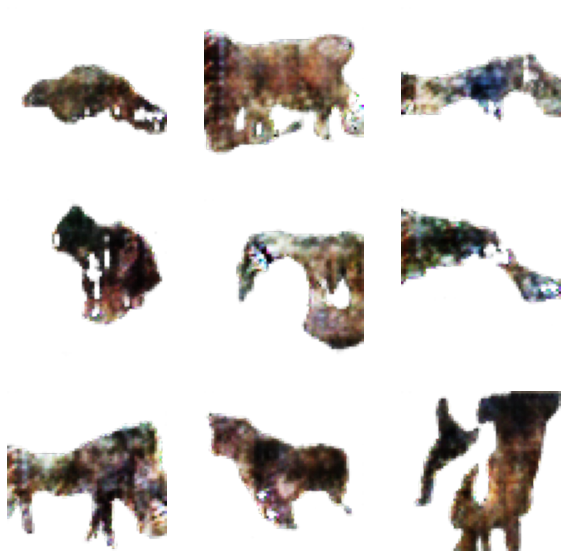

Epoch: 841 Generator loss: 5.795288562774658 Discriminator loss: 0.02284482680261135
Epoch: 842 Generator loss: 4.912485599517822 Discriminator loss: 0.03810817003250122
Epoch: 843 Generator loss: 4.322579860687256 Discriminator loss: 0.04670425131917
Epoch: 844 Generator loss: 7.88812255859375 Discriminator loss: 0.007268564775586128
Epoch: 845 Generator loss: 12.123446464538574 Discriminator loss: 0.5385406613349915
Epoch: 846 Generator loss: 8.614216804504395 Discriminator loss: 0.043394867330789566
Epoch: 847 Generator loss: 3.174206018447876 Discriminator loss: 0.11577026546001434
Epoch: 848 Generator loss: 0.3275660276412964 Discriminator loss: 2.088207960128784
Epoch: 849 Generator loss: 4.695257186889648 Discriminator loss: 0.03717378154397011
Epoch: 850 Generator loss: 3.5137224197387695 Discriminator loss: 0.10364975035190582


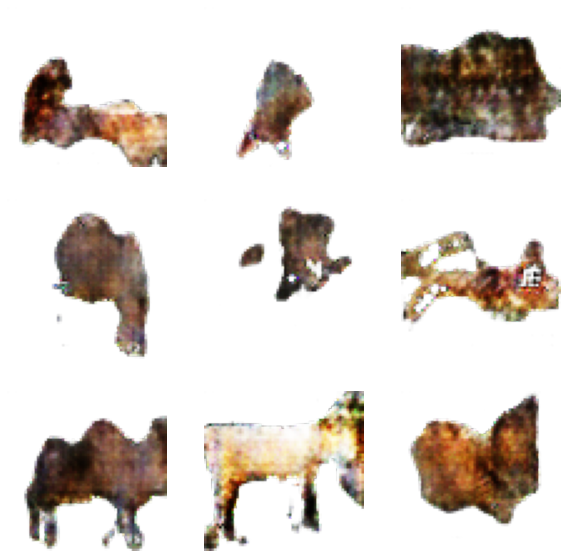

Epoch: 851 Generator loss: 5.380511283874512 Discriminator loss: 0.025066900998353958
Epoch: 852 Generator loss: 5.267651557922363 Discriminator loss: 0.23371928930282593
Epoch: 853 Generator loss: 8.787735939025879 Discriminator loss: 0.14997029304504395
Epoch: 854 Generator loss: 4.903406143188477 Discriminator loss: 0.07312372326850891
Epoch: 855 Generator loss: 3.81532621383667 Discriminator loss: 0.07346448302268982
Epoch: 856 Generator loss: 6.9897894859313965 Discriminator loss: 0.008861510083079338
Epoch: 857 Generator loss: 6.814781665802002 Discriminator loss: 0.008296453393995762
Epoch: 858 Generator loss: 5.377378940582275 Discriminator loss: 0.015309921465814114
Epoch: 859 Generator loss: 3.2296600341796875 Discriminator loss: 0.09999432414770126
Epoch: 860 Generator loss: 4.211269378662109 Discriminator loss: 0.06827057898044586


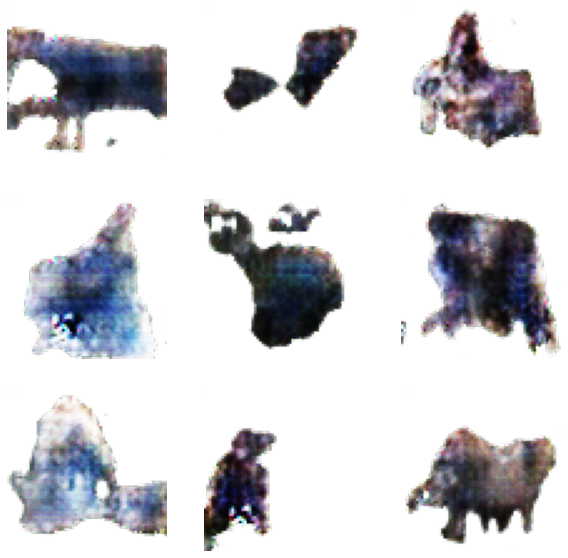

Epoch: 861 Generator loss: 9.44488525390625 Discriminator loss: 0.17648500204086304
Epoch: 862 Generator loss: 1.8707356452941895 Discriminator loss: 0.41549625992774963
Epoch: 863 Generator loss: 4.907590389251709 Discriminator loss: 0.04678349569439888
Epoch: 864 Generator loss: 3.007905960083008 Discriminator loss: 0.1836714744567871
Epoch: 865 Generator loss: 4.991969585418701 Discriminator loss: 0.03518803045153618
Epoch: 866 Generator loss: 6.498971462249756 Discriminator loss: 0.08127936720848083
Epoch: 867 Generator loss: 2.9661080837249756 Discriminator loss: 0.17352139949798584
Epoch: 868 Generator loss: 4.894876003265381 Discriminator loss: 0.03558476269245148
Epoch: 869 Generator loss: 5.064371109008789 Discriminator loss: 0.17831018567085266
Epoch: 870 Generator loss: 4.666482448577881 Discriminator loss: 0.03610807657241821


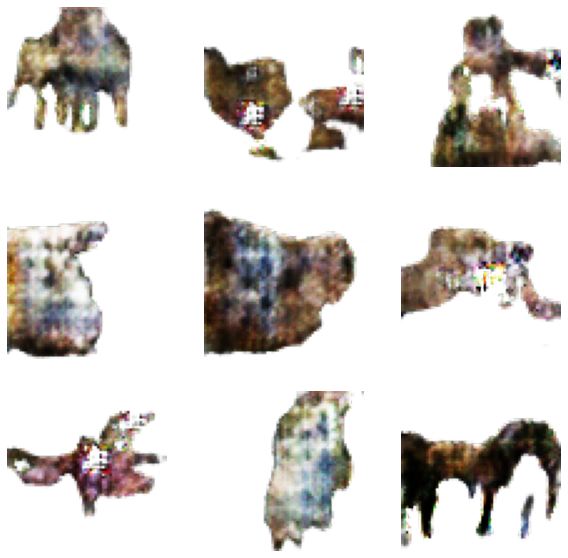

Epoch: 871 Generator loss: 8.025666236877441 Discriminator loss: 0.1633332371711731
Epoch: 872 Generator loss: 6.406842231750488 Discriminator loss: 0.01259020995348692
Epoch: 873 Generator loss: 9.105447769165039 Discriminator loss: 0.03544442728161812
Epoch: 874 Generator loss: 5.961641311645508 Discriminator loss: 0.11120972037315369
Epoch: 875 Generator loss: 6.758063793182373 Discriminator loss: 0.021912099793553352
Epoch: 876 Generator loss: 6.7409234046936035 Discriminator loss: 0.005758362822234631
Epoch: 877 Generator loss: 5.881560802459717 Discriminator loss: 0.018207818269729614
Epoch: 878 Generator loss: 8.060916900634766 Discriminator loss: 0.022936685010790825
Epoch: 879 Generator loss: 8.12040901184082 Discriminator loss: 0.014788713306188583
Epoch: 880 Generator loss: 6.800412654876709 Discriminator loss: 0.02181977592408657


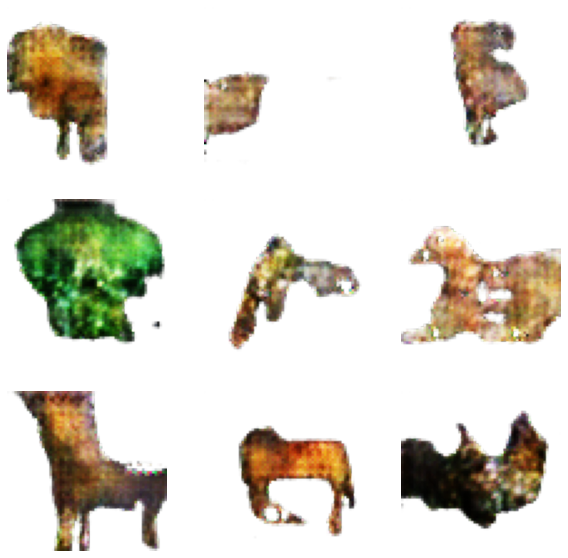

Epoch: 881 Generator loss: 5.192269325256348 Discriminator loss: 0.034813087433576584
Epoch: 882 Generator loss: 5.6106157302856445 Discriminator loss: 0.048582419753074646
Epoch: 883 Generator loss: 10.254995346069336 Discriminator loss: 0.43368959426879883
Epoch: 884 Generator loss: 5.203671932220459 Discriminator loss: 0.021690811961889267
Epoch: 885 Generator loss: 2.6296193599700928 Discriminator loss: 0.22981217503547668
Epoch: 886 Generator loss: 3.3582184314727783 Discriminator loss: 0.14194121956825256
Epoch: 887 Generator loss: 3.082613468170166 Discriminator loss: 0.11770148575305939
Epoch: 888 Generator loss: 6.954023838043213 Discriminator loss: 0.09653501957654953
Epoch: 889 Generator loss: 4.924461841583252 Discriminator loss: 0.027069248259067535
Epoch: 890 Generator loss: 4.590615272521973 Discriminator loss: 0.029159436002373695


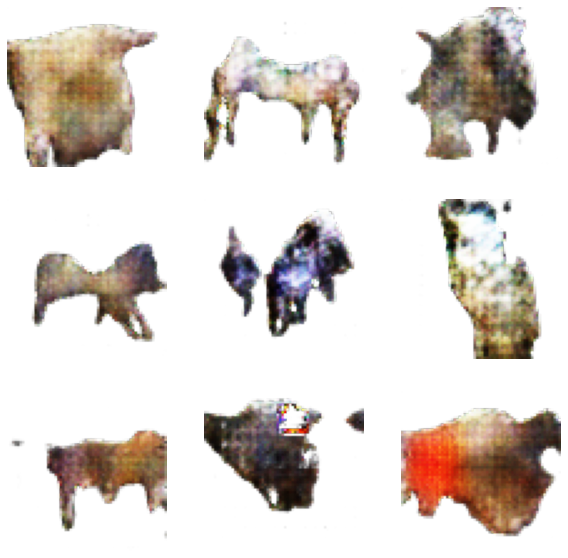

Epoch: 891 Generator loss: 7.358972549438477 Discriminator loss: 0.0433427058160305
Epoch: 892 Generator loss: 6.031498908996582 Discriminator loss: 0.1808396428823471
Epoch: 893 Generator loss: 5.6061930656433105 Discriminator loss: 0.013772565871477127
Epoch: 894 Generator loss: 3.876573085784912 Discriminator loss: 0.06316006183624268
Epoch: 895 Generator loss: 2.043376922607422 Discriminator loss: 0.3194900155067444
Epoch: 896 Generator loss: 4.840792179107666 Discriminator loss: 0.030196577310562134
Epoch: 897 Generator loss: 5.325862884521484 Discriminator loss: 0.03505407273769379
Epoch: 898 Generator loss: 6.356237411499023 Discriminator loss: 0.008034930564463139
Epoch: 899 Generator loss: 9.020467758178711 Discriminator loss: 0.011891507543623447
Epoch: 900 Generator loss: 10.689776420593262 Discriminator loss: 0.07972829043865204


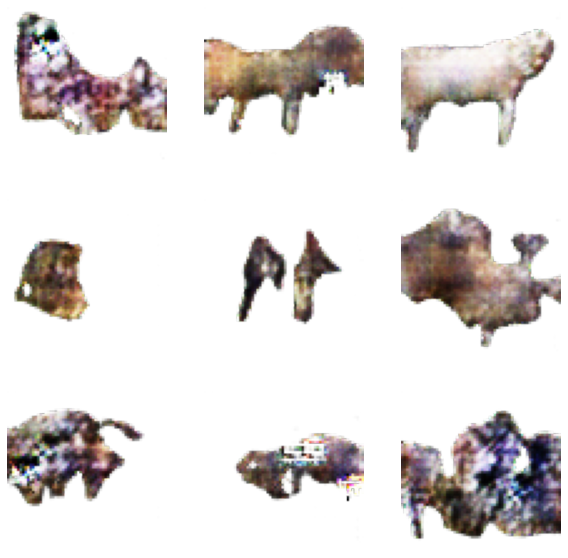

Epoch: 901 Generator loss: 8.836627006530762 Discriminator loss: 0.013472512364387512
Epoch: 902 Generator loss: 6.806224346160889 Discriminator loss: 0.024514298886060715
Epoch: 903 Generator loss: 2.6114652156829834 Discriminator loss: 0.21439047157764435
Epoch: 904 Generator loss: 3.6955108642578125 Discriminator loss: 0.1345931440591812
Epoch: 905 Generator loss: 3.3781096935272217 Discriminator loss: 0.10573183745145798
Epoch: 906 Generator loss: 6.965125560760498 Discriminator loss: 0.013767080381512642
Epoch: 907 Generator loss: 8.889944076538086 Discriminator loss: 0.003585039172321558
Epoch: 908 Generator loss: 6.957956314086914 Discriminator loss: 0.01438390277326107
Epoch: 909 Generator loss: 7.246913433074951 Discriminator loss: 0.03772357851266861
Epoch: 910 Generator loss: 8.001568794250488 Discriminator loss: 0.0109271090477705


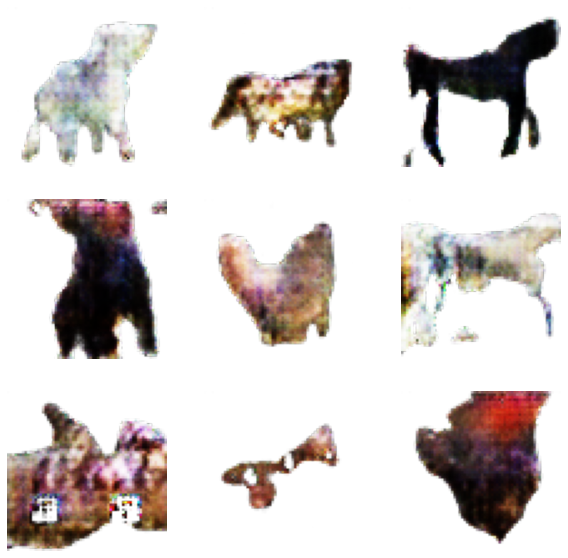

Epoch: 911 Generator loss: 4.0526814460754395 Discriminator loss: 0.061350930482149124
Epoch: 912 Generator loss: 8.305715560913086 Discriminator loss: 0.008020289242267609
Epoch: 913 Generator loss: 3.8773694038391113 Discriminator loss: 0.0731811672449112
Epoch: 914 Generator loss: 6.722002983093262 Discriminator loss: 0.00514524569734931
Epoch: 915 Generator loss: 6.6427001953125 Discriminator loss: 0.01589372754096985
Epoch: 916 Generator loss: 6.301726818084717 Discriminator loss: 0.06852605938911438
Epoch: 917 Generator loss: 8.042433738708496 Discriminator loss: 0.8667607307434082
Epoch: 918 Generator loss: 8.970242500305176 Discriminator loss: 0.005744072608649731
Epoch: 919 Generator loss: 4.660021781921387 Discriminator loss: 0.0391872376203537
Epoch: 920 Generator loss: 5.040374279022217 Discriminator loss: 0.05845710262656212


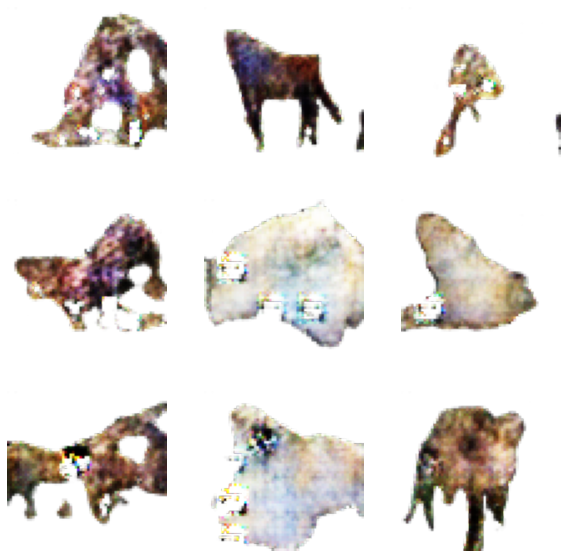

Epoch: 921 Generator loss: 6.747257709503174 Discriminator loss: 0.0036110333167016506
Epoch: 922 Generator loss: 5.010494232177734 Discriminator loss: 0.021971456706523895
Epoch: 923 Generator loss: 7.302203178405762 Discriminator loss: 0.015759514644742012
Epoch: 924 Generator loss: 4.1986470222473145 Discriminator loss: 0.06086497753858566
Epoch: 925 Generator loss: 5.226656436920166 Discriminator loss: 0.022321151569485664
Epoch: 926 Generator loss: 8.371896743774414 Discriminator loss: 0.12677925825119019
Epoch: 927 Generator loss: 8.93729305267334 Discriminator loss: 0.02428055927157402
Epoch: 928 Generator loss: 4.1805949211120605 Discriminator loss: 0.10651792585849762
Epoch: 929 Generator loss: 6.275811672210693 Discriminator loss: 0.060846082866191864
Epoch: 930 Generator loss: 10.266790390014648 Discriminator loss: 0.07361522316932678


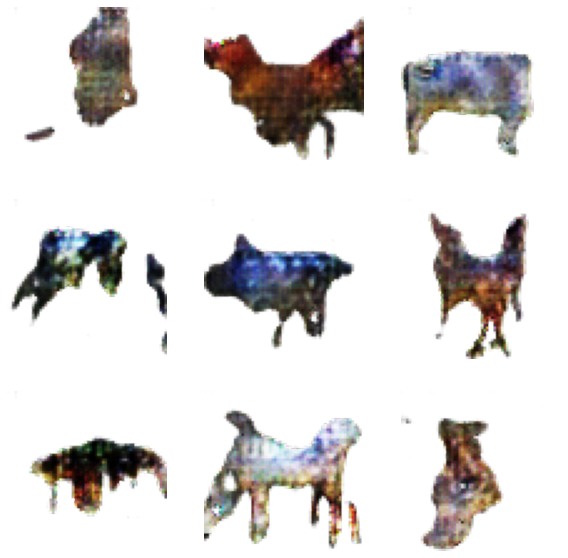

Epoch: 931 Generator loss: 6.002040863037109 Discriminator loss: 0.015796635299921036
Epoch: 932 Generator loss: 9.272992134094238 Discriminator loss: 0.01672297716140747
Epoch: 933 Generator loss: 7.1330389976501465 Discriminator loss: 0.022878721356391907
Epoch: 934 Generator loss: 9.390088081359863 Discriminator loss: 0.04908708482980728
Epoch: 935 Generator loss: 6.839217662811279 Discriminator loss: 0.0824979767203331
Epoch: 936 Generator loss: 3.9983696937561035 Discriminator loss: 0.05152006819844246
Epoch: 937 Generator loss: 7.896630764007568 Discriminator loss: 0.8619348406791687
Epoch: 938 Generator loss: 11.051080703735352 Discriminator loss: 0.20262540876865387
Epoch: 939 Generator loss: 5.627730846405029 Discriminator loss: 0.02581861987709999
Epoch: 940 Generator loss: 9.186051368713379 Discriminator loss: 0.2299671620130539


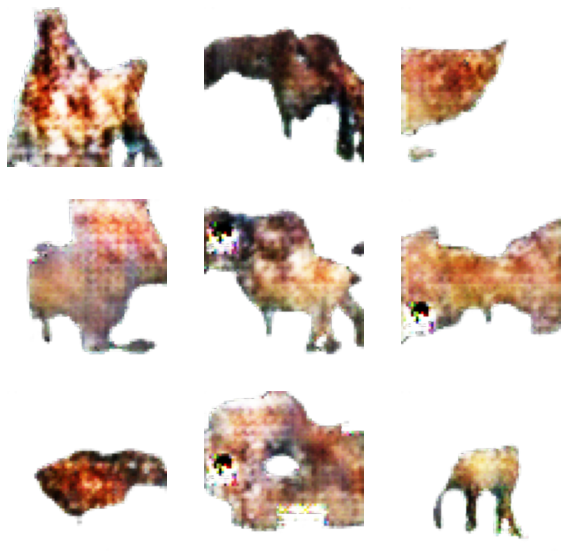

Epoch: 941 Generator loss: 6.129308700561523 Discriminator loss: 0.020467650145292282
Epoch: 942 Generator loss: 6.3144097328186035 Discriminator loss: 0.014915846288204193
Epoch: 943 Generator loss: 6.291421413421631 Discriminator loss: 0.0351426899433136
Epoch: 944 Generator loss: 3.8501389026641846 Discriminator loss: 0.07924003154039383
Epoch: 945 Generator loss: 3.8135340213775635 Discriminator loss: 0.1053805947303772
Epoch: 946 Generator loss: 4.493057727813721 Discriminator loss: 0.03240811079740524
Epoch: 947 Generator loss: 5.806323051452637 Discriminator loss: 0.03752259910106659
Epoch: 948 Generator loss: 9.250799179077148 Discriminator loss: 0.04295051842927933
Epoch: 949 Generator loss: 4.668842315673828 Discriminator loss: 0.024481162428855896
Epoch: 950 Generator loss: 6.356379508972168 Discriminator loss: 0.027678493410348892


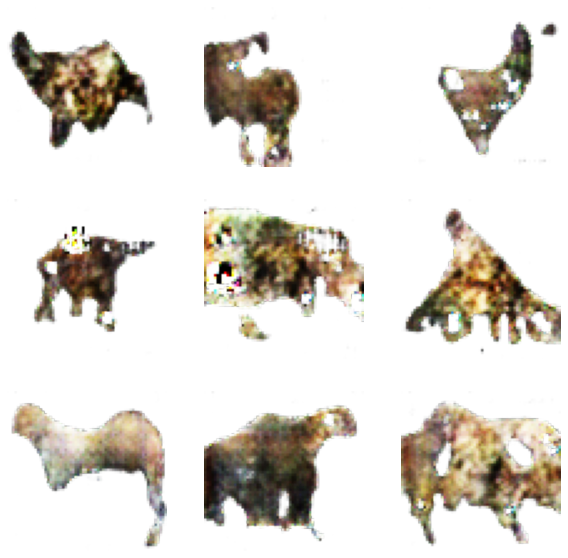

Epoch: 951 Generator loss: 6.016599655151367 Discriminator loss: 0.053314536809921265
Epoch: 952 Generator loss: 8.181729316711426 Discriminator loss: 0.0034007132053375244
Epoch: 953 Generator loss: 9.151117324829102 Discriminator loss: 0.03117458149790764
Epoch: 954 Generator loss: 5.932651996612549 Discriminator loss: 0.011850505135953426
Epoch: 955 Generator loss: 6.9069342613220215 Discriminator loss: 0.0038882982917129993
Epoch: 956 Generator loss: 6.376836776733398 Discriminator loss: 0.0099813062697649
Epoch: 957 Generator loss: 3.920536518096924 Discriminator loss: 0.05814144015312195
Epoch: 958 Generator loss: 2.7759475708007812 Discriminator loss: 0.23172275722026825
Epoch: 959 Generator loss: 10.179939270019531 Discriminator loss: 0.23044663667678833
Epoch: 960 Generator loss: 5.891704559326172 Discriminator loss: 0.018678884953260422


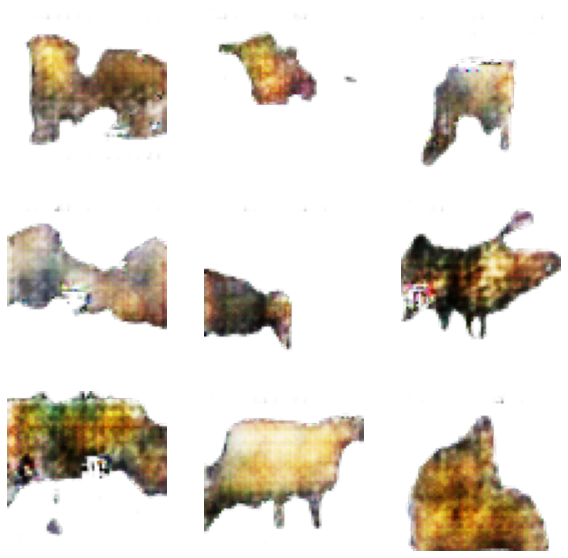

Epoch: 961 Generator loss: 3.2369871139526367 Discriminator loss: 0.1698768138885498
Epoch: 962 Generator loss: 9.787084579467773 Discriminator loss: 0.2543494701385498
Epoch: 963 Generator loss: 4.928225994110107 Discriminator loss: 0.028120867908000946
Epoch: 964 Generator loss: 2.5209357738494873 Discriminator loss: 0.26983842253685
Epoch: 965 Generator loss: 6.137571811676025 Discriminator loss: 0.12080039829015732
Epoch: 966 Generator loss: 5.1425042152404785 Discriminator loss: 0.02245742455124855
Epoch: 967 Generator loss: 7.203758716583252 Discriminator loss: 0.004435935989022255
Epoch: 968 Generator loss: 8.978656768798828 Discriminator loss: 0.013304181396961212
Epoch: 969 Generator loss: 4.015768527984619 Discriminator loss: 0.048609524965286255
Epoch: 970 Generator loss: 7.899803638458252 Discriminator loss: 0.007000356912612915


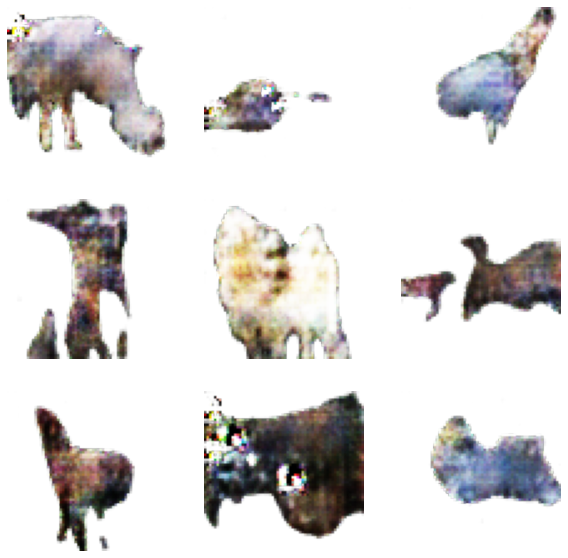

Epoch: 971 Generator loss: 0.44342249631881714 Discriminator loss: 1.956373691558838
Epoch: 972 Generator loss: 9.250200271606445 Discriminator loss: 0.06735698133707047
Epoch: 973 Generator loss: 3.6791024208068848 Discriminator loss: 0.08199925720691681
Epoch: 974 Generator loss: 7.095269680023193 Discriminator loss: 0.017538949847221375
Epoch: 975 Generator loss: 4.450160980224609 Discriminator loss: 0.15920564532279968
Epoch: 976 Generator loss: 10.093681335449219 Discriminator loss: 0.08260373026132584
Epoch: 977 Generator loss: 7.944455623626709 Discriminator loss: 0.009012946859002113
Epoch: 978 Generator loss: 7.951375961303711 Discriminator loss: 0.015552869997918606
Epoch: 979 Generator loss: 7.471826553344727 Discriminator loss: 0.008990122005343437
Epoch: 980 Generator loss: 9.678150177001953 Discriminator loss: 0.053465038537979126


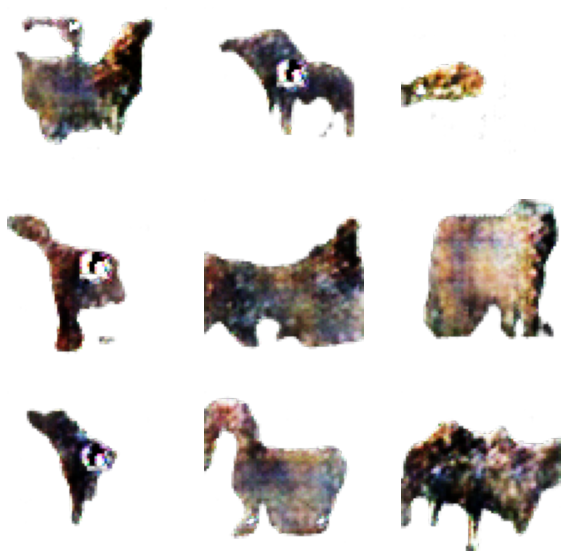

Epoch: 981 Generator loss: 2.775357961654663 Discriminator loss: 0.18321849405765533
Epoch: 982 Generator loss: 4.8409037590026855 Discriminator loss: 0.038619738072156906
Epoch: 983 Generator loss: 7.189114570617676 Discriminator loss: 0.00455070286989212
Epoch: 984 Generator loss: 5.642887592315674 Discriminator loss: 0.014886202290654182
Epoch: 985 Generator loss: 5.91429328918457 Discriminator loss: 0.028112702071666718
Epoch: 986 Generator loss: 6.880408763885498 Discriminator loss: 0.016767190769314766
Epoch: 987 Generator loss: 7.8227152824401855 Discriminator loss: 0.0016304270830005407
Epoch: 988 Generator loss: 6.1864118576049805 Discriminator loss: 0.03458670526742935
Epoch: 989 Generator loss: 3.728687047958374 Discriminator loss: 0.09173155575990677
Epoch: 990 Generator loss: 9.720788955688477 Discriminator loss: 0.051048245280981064


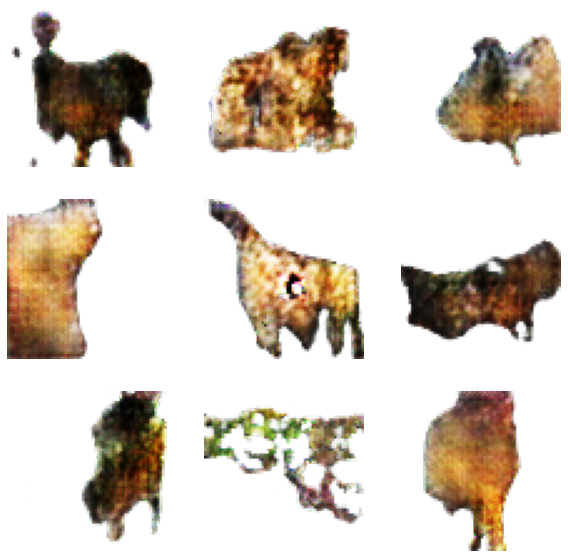

Epoch: 991 Generator loss: 8.421000480651855 Discriminator loss: 0.6658953428268433
Epoch: 992 Generator loss: 3.8864641189575195 Discriminator loss: 0.06336765736341476
Epoch: 993 Generator loss: 6.787881374359131 Discriminator loss: 0.03770068660378456
Epoch: 994 Generator loss: 8.511518478393555 Discriminator loss: 0.04952022433280945
Epoch: 995 Generator loss: 7.028420448303223 Discriminator loss: 0.01860528066754341
Epoch: 996 Generator loss: 4.750865459442139 Discriminator loss: 0.044131647795438766
Epoch: 997 Generator loss: 4.262147903442383 Discriminator loss: 0.060158707201480865
Epoch: 998 Generator loss: 6.113706588745117 Discriminator loss: 0.010998774319887161
Epoch: 999 Generator loss: 1.710809350013733 Discriminator loss: 0.5075745582580566
Epoch: 1000 Generator loss: 7.8403401374816895 Discriminator loss: 0.13645963370800018


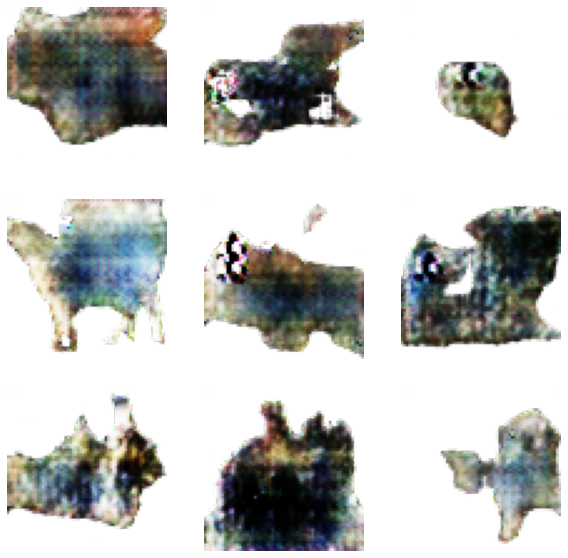

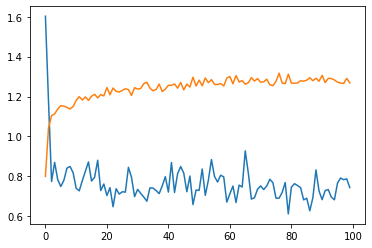

In [9]:
# Set the values for number of channels, noise size, learning rate and beta_1
noise_size = 100
channels = 4
learning_rate = 0.0001
beta_1 = 0.5
epoch_num=1000
batch_s=100

# Create generators, optimizers, and checkpoints
generator, generator_optimizer, generator_checkpoint = create_generator(channels, noise_size, learning_rate, beta_1)
# Create discriminators, optimizers, and checkpoints
discriminator, discriminator_optimizer, discriminator_checkpoint = create_discriminator(channels, learning_rate, beta_1)

# Train the DCGAN
train_DCGAN(train_set, batch_size=batch_s, epochs=epoch_num)

In [20]:
# Load the index of a checkpoint
checkpoint_dir="/content/generator/ckpt-52"
# from the DCGAN tutorial
checkpoint = tf.train.Checkpoint(
    generator_optimizer=generator_optimizer,
    discriminator_optimizer=discriminator_optimizer,
    generator=generator,
    discriminator=discriminator,
)

latest = tf.train.latest_checkpoint(checkpoint_dir)
checkpoint.restore(latest)

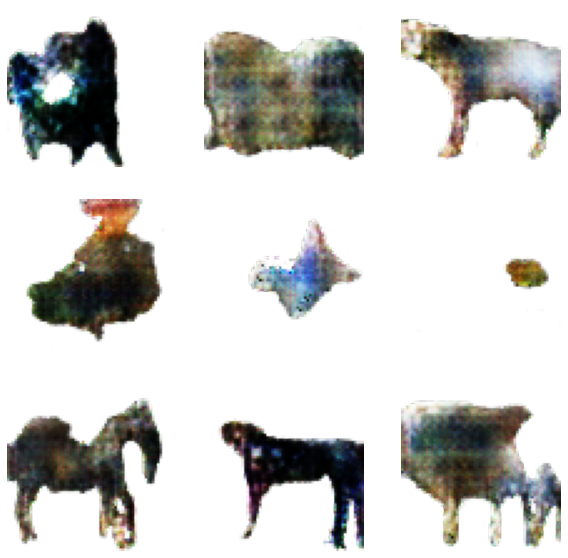

In [26]:
# generate an image
noise1 = tf.random.normal([100, noise_size])
prediction= checkpoint.generator(noise1)

fig = plt.figure(figsize=(10, 10))

for i in range(9):
    plt.subplot(3, 3, i + 1)
    plt.imshow(prediction[i])
    plt.axis('off')

plt.show()

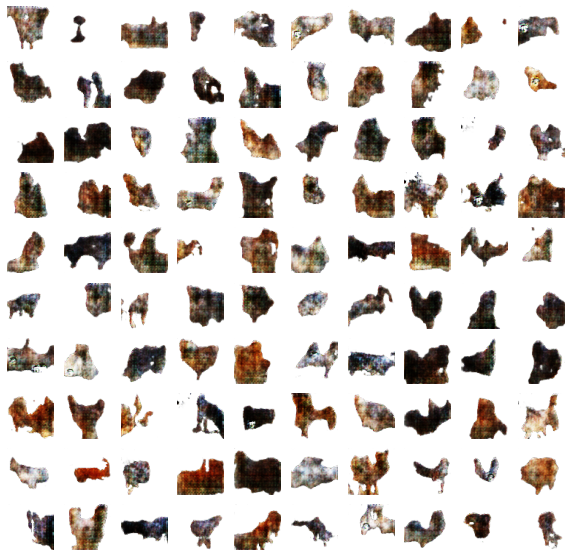

In [13]:
# Randomly plot 100 generated creatures
noise = tf.random.normal([100, noise_size])
prediction = generator(noise, training=False)
fig = plt.figure(figsize=(10, 10))

for i in range(100):
    plt.subplot(10, 10, i + 1)
    plt.imshow(prediction[i])
    plt.axis('off')

plt.show()